# CGAN - MNIST Data set

This version of Conditional GAN based on MNIST dataset is a more optimze version of previous CGAN to get better results. the only thing we will change in this notebook in contrast of previous one, is hyperparameters and network architecture for better results.

## Importing and utility functions

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

## Creating Generator

We have to modify code so the generator can perform conditional generation.

In [2]:
class Generator(nn.Module):
    '''
        This is our Generator Class.
        Inputs ->
            noise_dim = dimension of noise vector.
            image_dim = dimension of images fitted for the dataset use,
                mnist use 28 * 28 grayscale images, thus 28 * 28 * 1 = 784
            hidden_dim = default value of inner dimension
    '''
    def __init__(self, noise_dim=10, image_dim=784, hidden_dim=256, n_classes=10):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim
        self.block1 = nn.Sequential(
            nn.Linear(noise_dim + n_classes, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(.2, inplace=True)
        )
        self.block2 = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim * 2),
            nn.BatchNorm1d(hidden_dim * 2),
            nn.LeakyReLU(.2, inplace=True)
        )
        self.block3 = nn.Sequential(
            nn.Linear(hidden_dim * 2, hidden_dim * 4),
            nn.BatchNorm1d(hidden_dim * 4),
            nn.LeakyReLU(.2, inplace=True)
        )
        self.block4 = nn.Sequential(
            nn.Linear(hidden_dim * 4, hidden_dim * 8),
            nn.BatchNorm1d(hidden_dim * 8),
            nn.LeakyReLU(.2, inplace=True)
        )
        self.block5 = nn.Sequential(
            nn.Linear(hidden_dim * 8, image_dim),
            nn.Tanh()
        )
        self.embed = nn.Embedding(n_classes, 10)         # embedding has to be add to the noise for generator
    
    def forward(self, noise, labels):
        '''
            Function for froward pass in our network.
            takes noise as input and returns the image.
            Input ->
                noise = a noise tensor with dimension of (number_samples, noise_dim)
                labels = which class generated image should be belonged into
                
        '''
        noise = noise.view(noise.size(0), self.noise_dim)
        embedding = self.embed(labels) # this step is neccesary to make the embedding the right shape.
        x = torch.cat([noise, embedding], dim=1)
        out = self.block1(x)
        out = self.block2(out)
        out = self.block3(out)
        out = self.block4(out)
        out = self.block5(out)
        
        return out.view(x.size(0), 28, 28)



## Creating Noise

In [3]:
def get_noise(number_samples, noise_dim, device):
    '''
        Function for creating noise vector with given dimension
            (number_samples, noise_dim),
        Inputs ->
            number_samples = number of samples to geneare
            noise_dim = dimension of the noise vector
    '''
    return torch.randn(number_samples, noise_dim, device=device)

# Creating Discriminator

First, we must implement a way to pass label to discriminator too, like we do for generator. Have in mind there are multiple different ways to implement this feature. We do this with creating a nn.Embeding instance.

In [4]:
class Discriminator(nn.Module):
    '''
        The Discriminator Class
        Inputs ->
            image_dim = dimension of images fitted for the dataset use,
                mnist use 28 * 28 grayscale images, thus 28 * 28 * 1 = 784
            hidden_dim = default value of inner dimension
            n_classes = number of classes our dataset has
    '''
    def __init__(self, image_dim=784, hidden_dim=256, n_classes=10):   # we must add n_classes and here too
        super(Discriminator, self).__init__()
        self.image_dim = image_dim
        self.block1 = nn.Sequential(
            nn.Linear(image_dim + n_classes, hidden_dim * 4),                         # + n_classes required for passing number of classes too
            nn.LeakyReLU(.2),
            nn.Dropout(.3)
        )
        self.block2 = nn.Sequential(
            nn.Linear(hidden_dim * 4, hidden_dim * 2),
            nn.LeakyReLU(.2),
            nn.Dropout(.3)
        )
        self.block3 = nn.Sequential(
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.LeakyReLU(.2),
            nn.Dropout(.3)
        )
        self.block4 = nn.Linear(hidden_dim, 1)
        self.embed = nn.Embedding(n_classes, 10)           # creating embedding instance
    
    def forward(self, image, labels):                      # we must pass labels 
        '''
            This function is for forward pass of the discriminator.
            Given an image tensor, it returs a 1-dimension tensor representing
            wheteher an image is original or generated.
            Inputs ->
                image = Flattened image tensor with dimension of (image_dim)
                labels = class of each image
                image_dim = dimensions of images
        '''
        image = image.view(image.size(0), self.image_dim)
        embedding = self.embed(labels)
        x = torch.cat([image, embedding], dim=1)
        out = self.block1(x)
        out = self.block2(out)
        out = self.block3(out)
        out = self.block4(out)
        return out

## Training Phase

Before we start the training phase, we need to address some hyperparameters which is listed below:

- criterion: the loss function we want to use.
- n_epochs: the number of times we want to iterate through the entire dataset in training phase, epochs
- noise_dim: dimension of the noise vector
- display_step: in what frequency model show the generated images from trained generator
- batch_size: number of images for each batch (per forward/backward pass)
- lr: the learning rate
- device: the device type which we wants to perform training on

also in this step we will load the MNIST dataset as tensors using a data loader.

In [5]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 500
noise_dim = 64
display_step = 500
batch_size = 128
lr = .00001
device = 'cuda'
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=(.5,), std=(.5,))])

dataloader = DataLoader(
    MNIST('./data', train=True, download=True, transform=transform),
    batch_size=batch_size, shuffle=True)


Now, we can initialize! we need to initialize generator, discriminator and optimizers. Since each optimizer only takes the parameters of one particular model, we need 2 optimizers; one for generator and one for discriminator.

In [6]:
gen = Generator(noise_dim).to(device)
disc = Discriminator().to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before we train the GAN, we might need to calculate the discriminator's and generator's loss. this is the way how we, discriminator and generator will know how well they are performing and improve themselves.

**IMPORTANT**: generator is needed when want to calculate discriminator's loss, so we have to use .detach() on the generator result so we its parameters won't get updated in discriminator's backward pass.

In [7]:
def disc_loss(gen, disc, criterion, original, num_images, noise_dim, device, labels):
    '''
        Return the loss of discriminator
        Inputs -> 
            gen = generator model, this returns an image given noise
            disc = discriminator model, this returns prediction
            criterion = loss function, this is used for comparing discriminator's
                prediction to the ground truth; generated = 0 and original = 1
            original = a batch of original images
            num_images = number of images generated should produce. also the length
                of original images.
            noise_dim = dimension of noise vector
            device = the device type
        Returns ->
            disc_loss = loss value for current batch, torch scaler type
    '''
    noise_vec = get_noise(num_images, noise_dim, device)
    fake_labels = torch.tensor(np.random.randint(0, 10, num_images), device=device, dtype=torch.long)
    gen_image = gen(noise_vec, fake_labels).detach()
    gen_labels = torch.zeros(num_images, 1, device=device)
    gen_pred = disc(gen_image, fake_labels)
    gen_img_loss = criterion(gen_pred, gen_labels)
    org_labels = torch.ones(num_images, 1, device=device)
    org_pred = disc(original, labels)
    org_img_loss = criterion(org_pred, org_labels)
    disc_loss = (org_img_loss + gen_img_loss) / 2
    return disc_loss

In [8]:
def gen_loss(gen, disc, criterion, num_images, noise_dim, device):
    '''
        Return the loss of generator
        Inputs -> 
            gen = generator model, this returns an image given noise
            disc = discriminator model, this returns prediction
            criterion = loss function, this is used for comparing discriminator's
                prediction to the ground truth; generated = 0 and original = 1
            num_images = number of images generated should produce. also the length
                of original images.
            noise_dim = dimension of noise vector
            device = the device type
        Returns ->
            gen_loss = loss value for current batch, torch scaler type
    '''
    noise_vec = get_noise(num_images, noise_dim, device)
    fake_labels = torch.tensor(np.random.randint(0, 10, num_images), device=device, dtype=torch.long)
    gen_img = gen(noise_vec, fake_labels)
    gen_img_pred = disc(gen_img, fake_labels)
    gen_labels = torch.ones(num_images, 1, device=device)
    gen_loss = criterion(gen_img_pred, gen_labels)
    return gen_loss

## Putting everything together

Training phase is almost identical to unsupervised version of GAN but with a slight and important change, which is now we need labels, both for generator and discriminator. also we have to get labels for each image in MNIST dataset so we can pass it to discriminator.

  6%|▋         | 30/469 [00:01<00:24, 17.88it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 1, step 500 -> generator loss: 0.4218116663098338, discriminator loss: 0.69098834681511


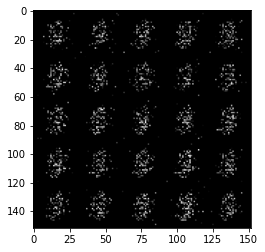

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


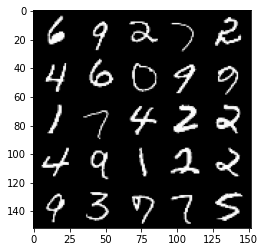

 13%|█▎        | 62/469 [00:03<00:20, 19.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 2, step 1000 -> generator loss: 0.435070547819138, discriminator loss: 0.6903673179149635


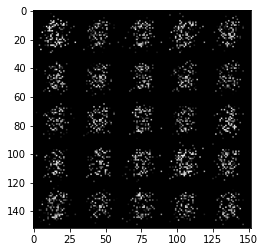

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


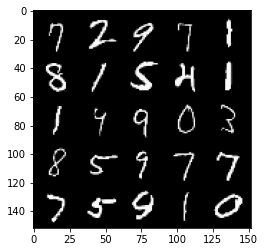

 20%|█▉        | 92/469 [00:05<00:20, 18.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 3, step 1500 -> generator loss: 0.4540462263822556, discriminator loss: 0.6631636139154432


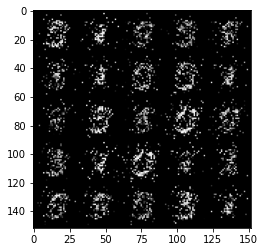

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


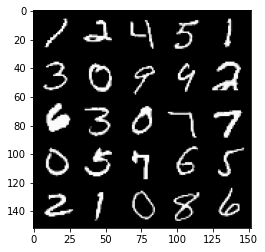

 26%|██▋       | 124/469 [00:12<00:19, 17.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 4, step 2000 -> generator loss: 0.4330625095367432, discriminator loss: 0.6904402194023125


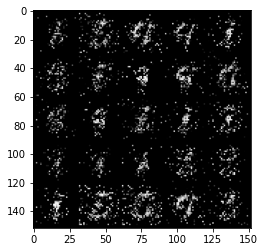

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


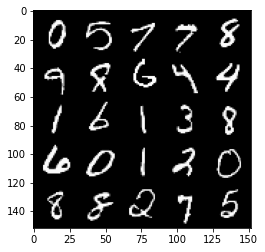

 33%|███▎      | 155/469 [00:09<00:16, 19.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5, step 2500 -> generator loss: 0.4385519496202467, discriminator loss: 0.6900398743152623


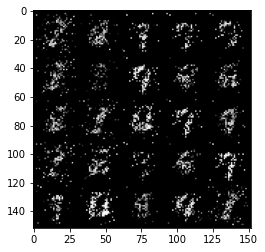

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


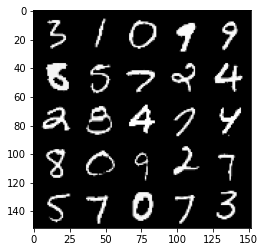

 39%|███▉      | 185/469 [00:09<00:14, 19.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 6, step 3000 -> generator loss: 0.43759480190277084, discriminator loss: 0.6937007058858883


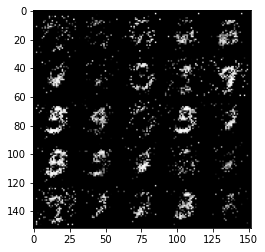

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


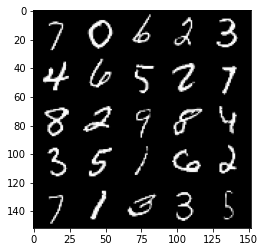

 46%|████▌     | 215/469 [00:11<00:13, 19.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 7, step 3500 -> generator loss: 0.4272198795676232, discriminator loss: 0.7090146437883375


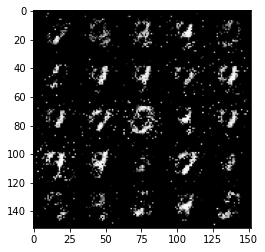

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


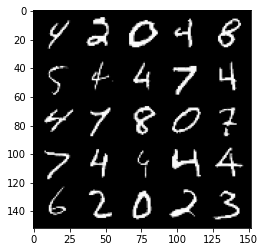

 53%|█████▎    | 247/469 [00:12<00:11, 19.53it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 8, step 4000 -> generator loss: 0.42604644793272034, discriminator loss: 0.7135674999952306


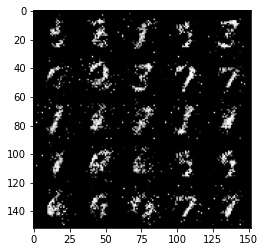

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


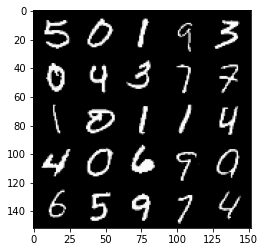

 59%|█████▉    | 278/469 [00:14<00:09, 19.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 9, step 4500 -> generator loss: 0.43031578493118283, discriminator loss: 0.7082777593135828


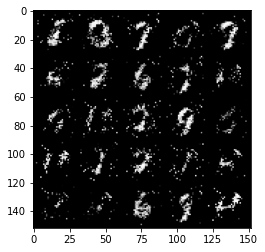

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


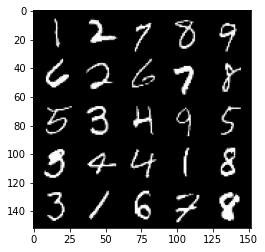

 66%|██████▌   | 310/469 [00:16<00:08, 18.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10, step 5000 -> generator loss: 0.431274506986141, discriminator loss: 0.7046402994394303


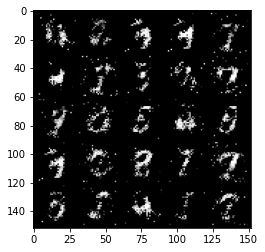

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


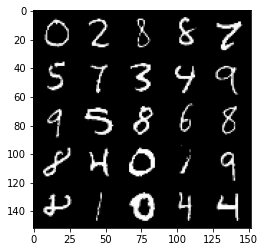

 72%|███████▏  | 339/469 [00:17<00:06, 19.96it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 11, step 5500 -> generator loss: 0.43646955257654135, discriminator loss: 0.7021993484497077


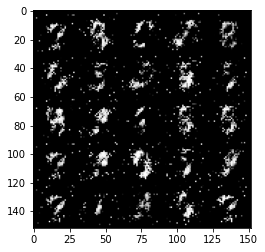

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


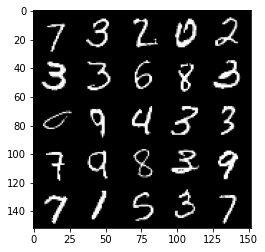

 79%|███████▉  | 371/469 [00:18<00:05, 19.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 12, step 6000 -> generator loss: 0.4423914400935172, discriminator loss: 0.6927311927080156


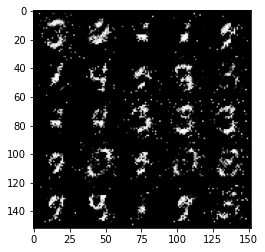

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


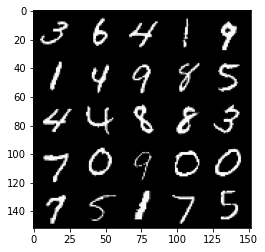

 86%|████████▌ | 402/469 [00:20<00:03, 19.70it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 13, step 6500 -> generator loss: 0.4480277015566824, discriminator loss: 0.689947269916535


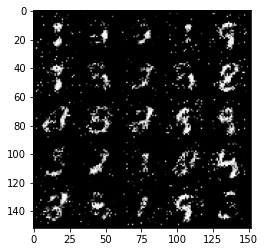

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


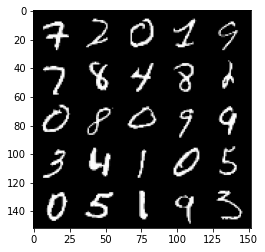

 92%|█████████▏| 433/469 [00:22<00:01, 19.45it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 14, step 7000 -> generator loss: 0.4544107095599177, discriminator loss: 0.6799736680984496


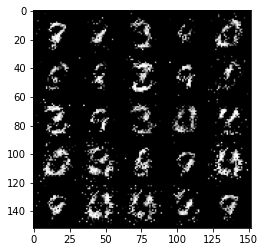

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


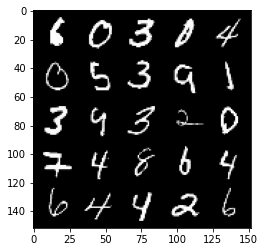

 99%|█████████▉| 465/469 [00:23<00:00, 19.85it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15, step 7500 -> generator loss: 0.4491850907802579, discriminator loss: 0.6896333770751951


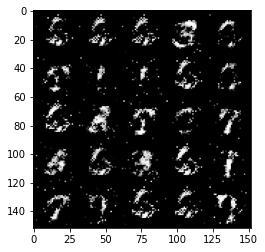

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


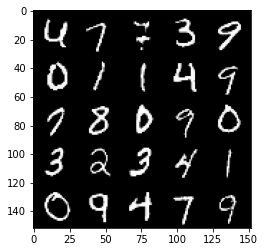

  6%|▌         | 27/469 [00:01<00:22, 20.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 17, step 8000 -> generator loss: 0.45703669232130034, discriminator loss: 0.6794790743589405


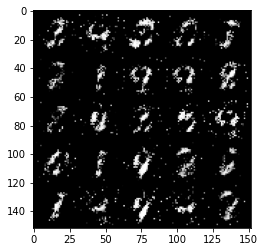

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


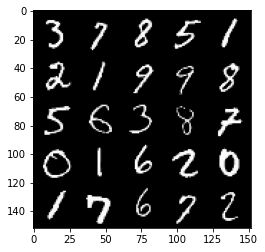

 12%|█▏        | 56/469 [00:02<00:20, 19.95it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 18, step 8500 -> generator loss: 0.45208202856779045, discriminator loss: 0.689376662015915


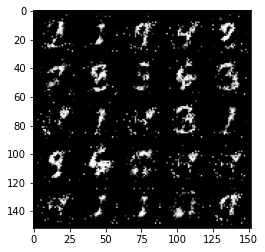

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


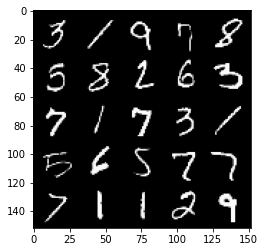

 19%|█▊        | 87/469 [00:04<00:19, 19.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 19, step 9000 -> generator loss: 0.4521370694637301, discriminator loss: 0.6848734017610552


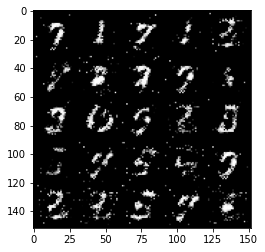

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


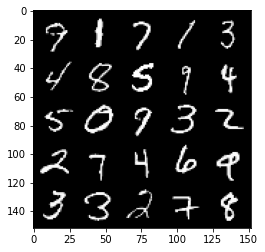

 25%|██▌       | 118/469 [00:06<00:17, 19.71it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20, step 9500 -> generator loss: 0.4571211444735527, discriminator loss: 0.6813311032056808


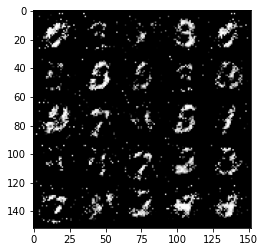

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


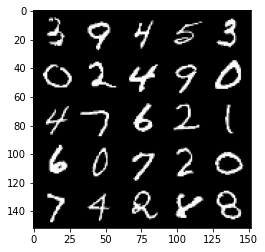

 32%|███▏      | 151/469 [00:07<00:16, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 21, step 10000 -> generator loss: 0.45920406854152646, discriminator loss: 0.6797114177942275


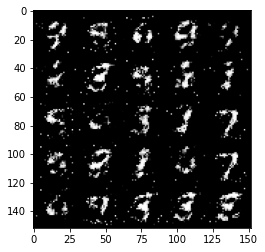

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


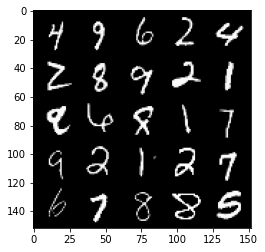

 39%|███▊      | 181/469 [00:09<00:14, 19.97it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 22, step 10500 -> generator loss: 0.4530133311152458, discriminator loss: 0.6888186947107307


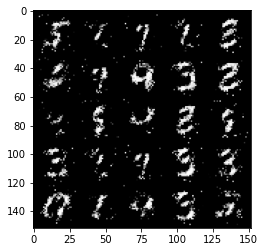

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


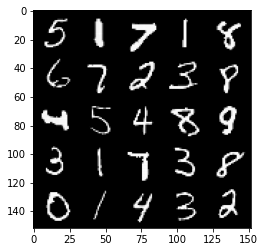

 45%|████▌     | 212/469 [00:11<00:13, 19.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 23, step 11000 -> generator loss: 0.44738230240345017, discriminator loss: 0.6985891649723056


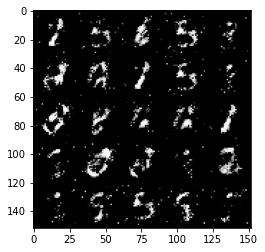

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


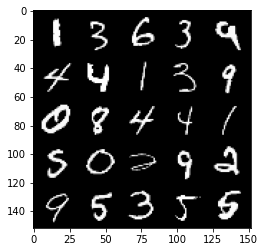

 52%|█████▏    | 243/469 [00:12<00:11, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 24, step 11500 -> generator loss: 0.4524232152700424, discriminator loss: 0.6886425418853759


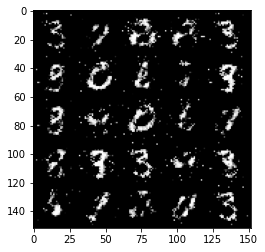

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


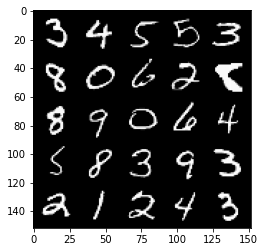

 59%|█████▊    | 275/469 [00:13<00:09, 19.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25, step 12000 -> generator loss: 0.455023009538651, discriminator loss: 0.6898699301481247


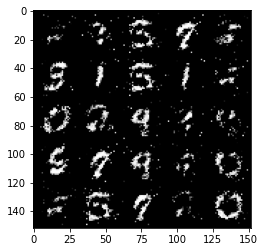

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


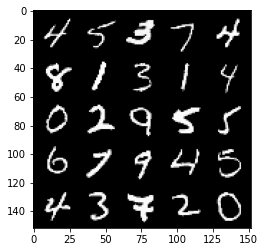

 65%|██████▌   | 306/469 [00:15<00:08, 19.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 26, step 12500 -> generator loss: 0.46161471205949745, discriminator loss: 0.6783050550222391


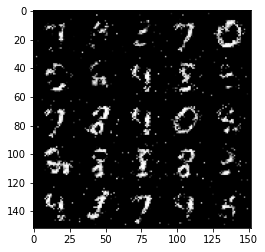

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


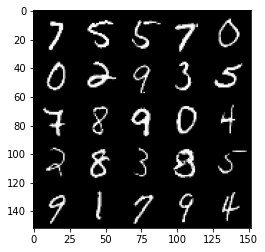

 72%|███████▏  | 336/469 [00:17<00:06, 19.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 27, step 13000 -> generator loss: 0.4608798447251319, discriminator loss: 0.6800557177066798


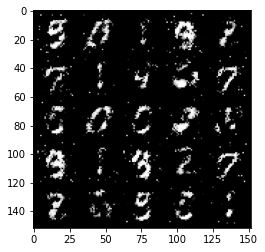

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


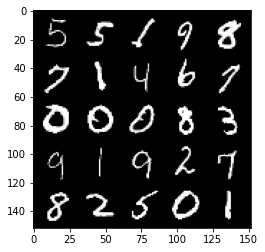

 78%|███████▊  | 367/469 [00:18<00:05, 19.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 28, step 13500 -> generator loss: 0.4687409192323687, discriminator loss: 0.6713016809225082


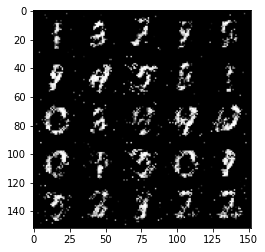

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


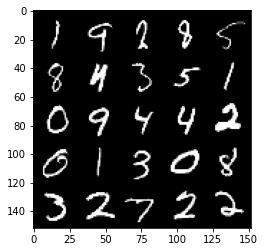

 85%|████████▌ | 399/469 [00:20<00:03, 19.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 29, step 14000 -> generator loss: 0.4718795177340502, discriminator loss: 0.6684314546585082


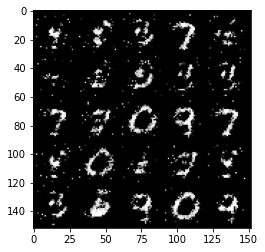

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


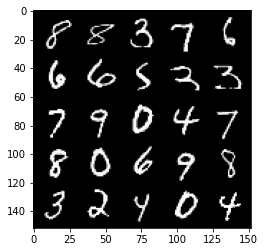

 91%|█████████▏| 429/469 [00:21<00:02, 19.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30, step 14500 -> generator loss: 0.4745700172781943, discriminator loss: 0.6664333264827721


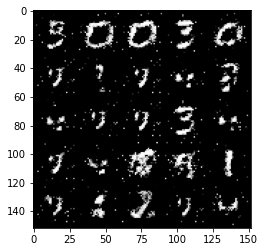

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


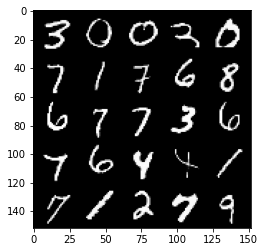

 98%|█████████▊| 461/469 [00:23<00:00, 19.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 31, step 15000 -> generator loss: 0.46416256058216065, discriminator loss: 0.6808947883844376


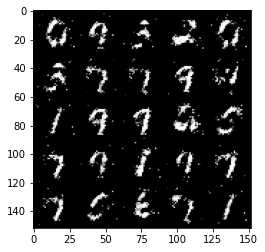

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


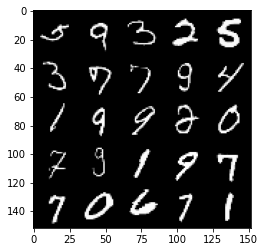

  4%|▍         | 21/469 [00:01<00:22, 19.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 33, step 15500 -> generator loss: 0.46259776371717487, discriminator loss: 0.6814534661769865


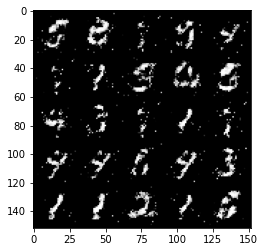

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


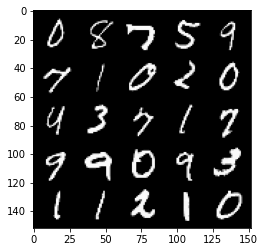

 11%|█▏        | 53/469 [00:02<00:21, 19.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 34, step 16000 -> generator loss: 0.4668855135440828, discriminator loss: 0.6747132037878033


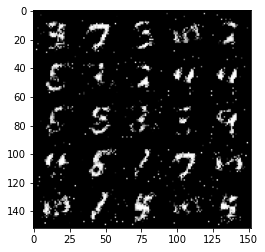

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


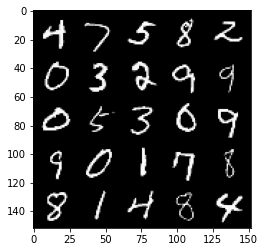

 18%|█▊        | 84/469 [00:04<00:24, 15.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35, step 16500 -> generator loss: 0.4721402797698975, discriminator loss: 0.6699301633834844


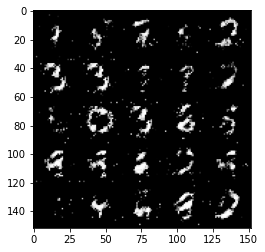

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


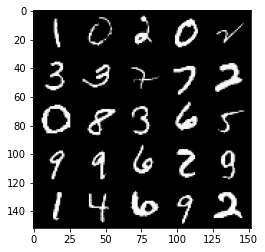

 25%|██▍       | 116/469 [00:06<00:18, 18.94it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 36, step 17000 -> generator loss: 0.47208092975616417, discriminator loss: 0.6711967513561253


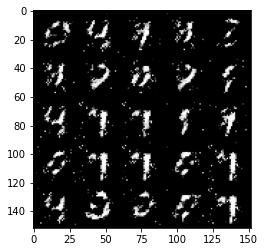

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


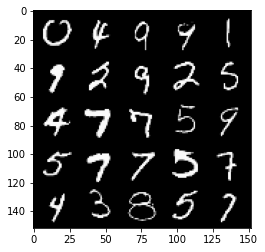

 31%|███       | 146/469 [00:07<00:16, 19.20it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 37, step 17500 -> generator loss: 0.46859433346986784, discriminator loss: 0.6762772905826577


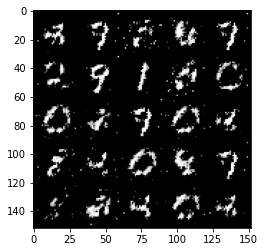

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


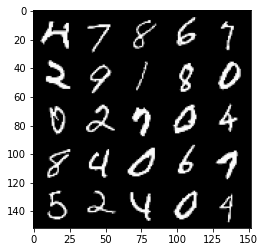

 38%|███▊      | 178/469 [00:09<00:15, 19.39it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 38, step 18000 -> generator loss: 0.4802911800742151, discriminator loss: 0.6615124275684352


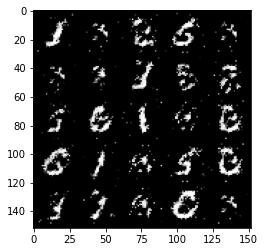

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


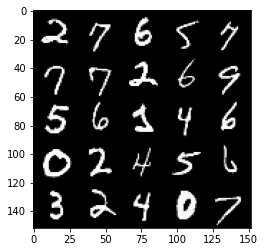

 44%|████▍     | 208/469 [00:10<00:13, 18.94it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 39, step 18500 -> generator loss: 0.4851598489284515, discriminator loss: 0.6549860897064207


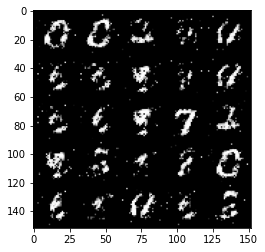

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


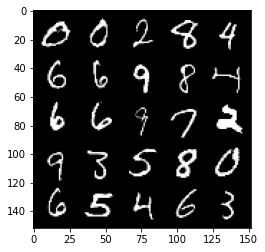

 51%|█████     | 240/469 [00:12<00:11, 19.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40, step 19000 -> generator loss: 0.48370736187696484, discriminator loss: 0.6578368141651163


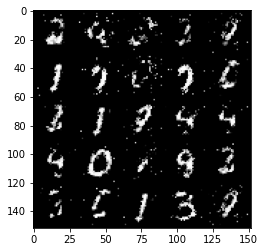

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


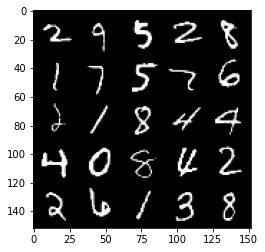

 58%|█████▊    | 270/469 [00:14<00:12, 15.76it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 41, step 19500 -> generator loss: 0.4736259753704069, discriminator loss: 0.672891238451004


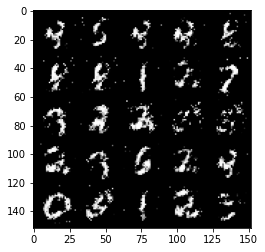

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


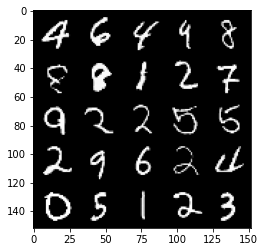

 64%|██████▍   | 301/469 [00:16<00:08, 19.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 42, step 20000 -> generator loss: 0.48102943611145044, discriminator loss: 0.6607808631658549


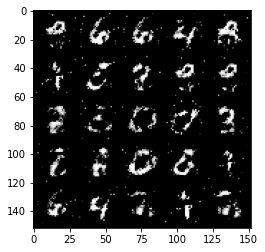

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


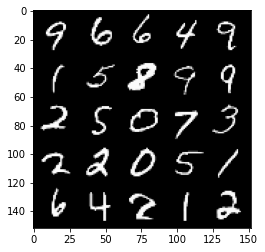

 71%|███████   | 333/469 [00:17<00:06, 19.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 43, step 20500 -> generator loss: 0.4859217734336855, discriminator loss: 0.657567976236342


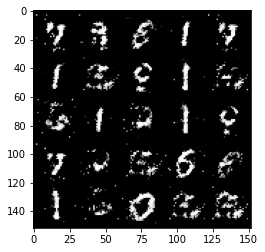

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


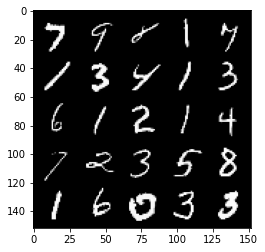

 78%|███████▊  | 364/469 [00:20<00:05, 19.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 44, step 21000 -> generator loss: 0.49200950533151583, discriminator loss: 0.6492272378206257


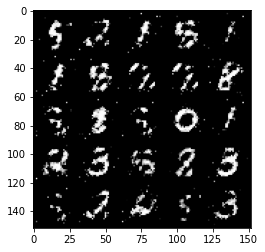

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


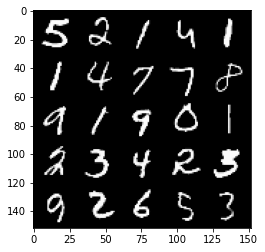

 84%|████████▍ | 395/469 [00:21<00:05, 12.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45, step 21500 -> generator loss: 0.4993517240285873, discriminator loss: 0.6439524009227753


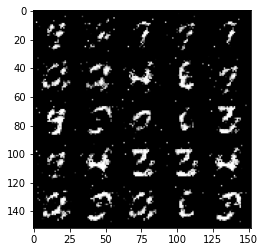

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


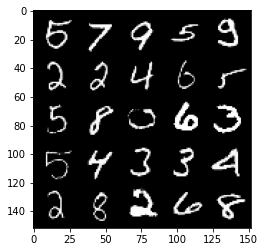

 91%|█████████ | 425/469 [00:23<00:02, 16.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 46, step 22000 -> generator loss: 0.49918390530347834, discriminator loss: 0.6431070737838748


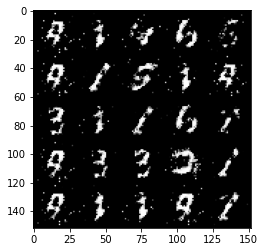

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


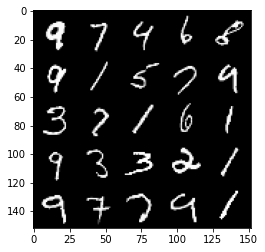

 97%|█████████▋| 457/469 [00:25<00:00, 18.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 47, step 22500 -> generator loss: 0.49337535011768285, discriminator loss: 0.6499536074399946


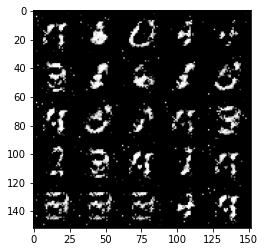

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


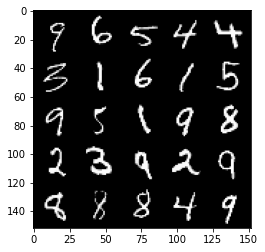

  4%|▍         | 18/469 [00:00<00:22, 19.96it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 49, step 23000 -> generator loss: 0.5011116437911984, discriminator loss: 0.6357338030338282


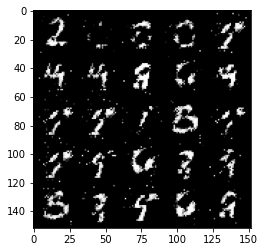

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


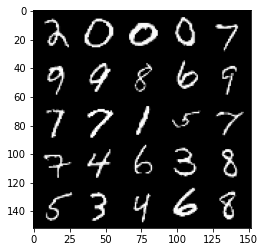

 11%|█         | 50/469 [00:02<00:22, 19.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50, step 23500 -> generator loss: 0.5113182874321938, discriminator loss: 0.6248949252367018


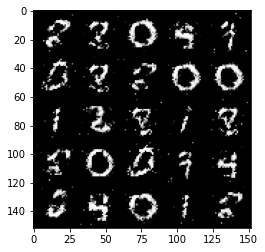

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


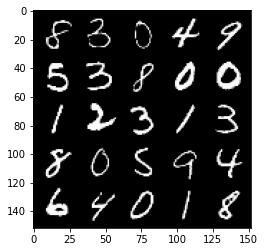

 17%|█▋        | 81/469 [00:04<00:19, 19.58it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 51, step 24000 -> generator loss: 0.5030942563414578, discriminator loss: 0.6414585283994673


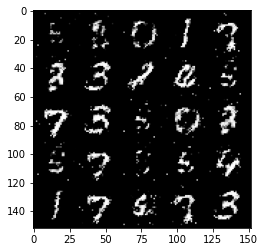

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


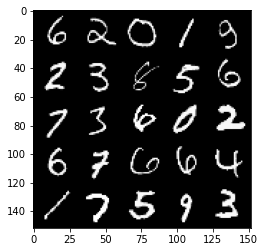

 24%|██▍       | 112/469 [00:05<00:18, 19.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 52, step 24500 -> generator loss: 0.5019720853567126, discriminator loss: 0.6397515980005266


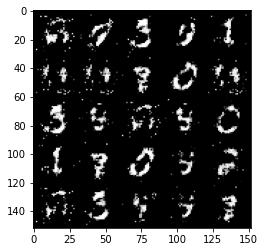

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


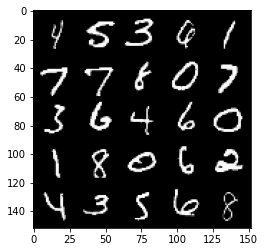

 30%|███       | 142/469 [00:07<00:16, 19.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 53, step 25000 -> generator loss: 0.5004714025855064, discriminator loss: 0.6423987557888031


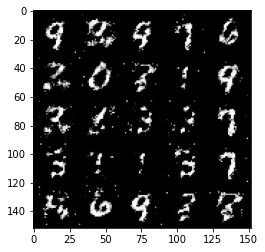

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


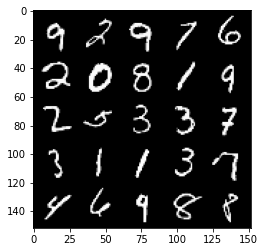

 37%|███▋      | 172/469 [00:08<00:14, 19.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 54, step 25500 -> generator loss: 0.4906733501553535, discriminator loss: 0.6566041774749758


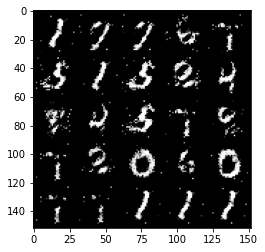

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


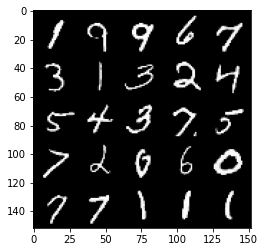

 43%|████▎     | 203/469 [00:10<00:13, 20.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55, step 26000 -> generator loss: 0.4995033356547365, discriminator loss: 0.6396141828298566


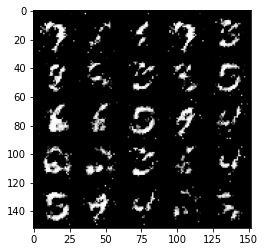

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


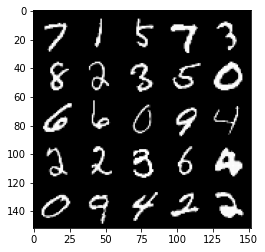

 50%|█████     | 236/469 [00:11<00:12, 19.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 56, step 26500 -> generator loss: 0.5002035892605786, discriminator loss: 0.6411365350484844


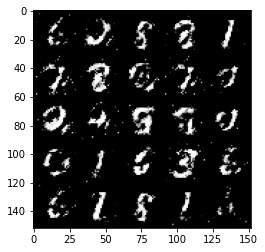

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


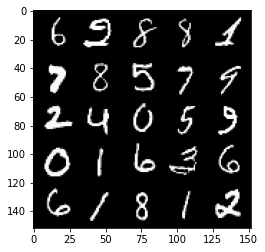

 57%|█████▋    | 266/469 [00:13<00:10, 20.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 57, step 27000 -> generator loss: 0.49285676848888377, discriminator loss: 0.6500102366209024


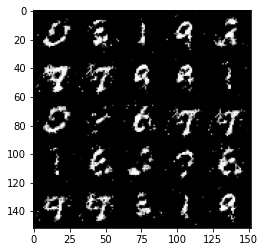

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


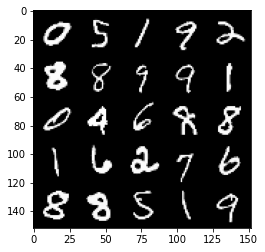

 63%|██████▎   | 296/469 [00:14<00:08, 20.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 58, step 27500 -> generator loss: 0.5184854063391683, discriminator loss: 0.6178267962932585


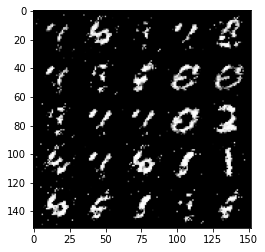

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


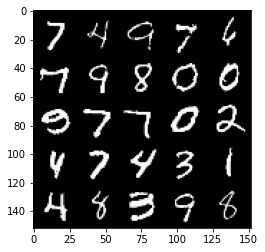

 70%|██████▉   | 328/469 [00:16<00:06, 20.21it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 59, step 28000 -> generator loss: 0.5221199058294297, discriminator loss: 0.6165376662015919


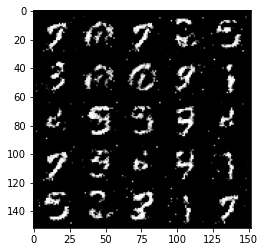

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


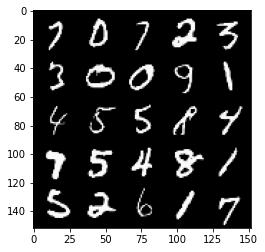

 76%|███████▋  | 358/469 [00:17<00:05, 20.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60, step 28500 -> generator loss: 0.5118322476744652, discriminator loss: 0.6285905178785325


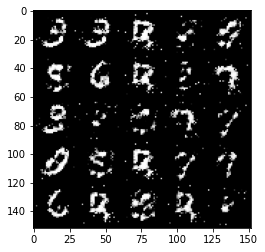

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


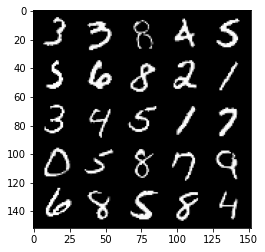

 83%|████████▎ | 390/469 [00:19<00:03, 20.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 61, step 29000 -> generator loss: 0.5226580544114118, discriminator loss: 0.611672826051712


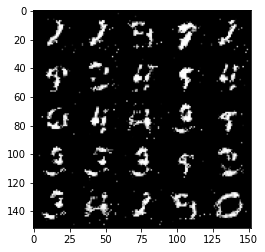

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


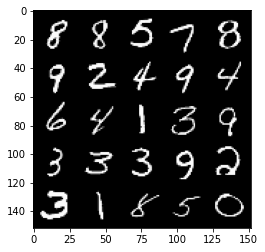

 90%|████████▉ | 421/469 [00:20<00:02, 20.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 62, step 29500 -> generator loss: 0.5200843735933303, discriminator loss: 0.6194553711414343


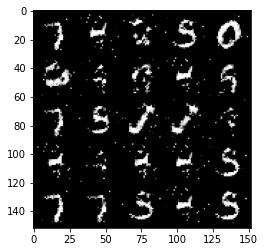

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


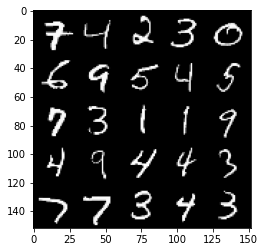

 97%|█████████▋| 453/469 [00:22<00:00, 20.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 63, step 30000 -> generator loss: 0.5196658977866174, discriminator loss: 0.6159318420886998


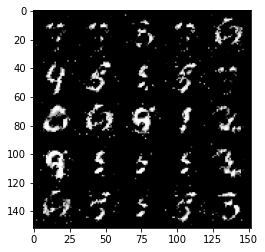

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


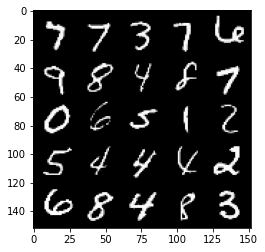

  3%|▎         | 14/469 [00:00<00:22, 19.90it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65, step 30500 -> generator loss: 0.514243858754635, discriminator loss: 0.6235941219329828


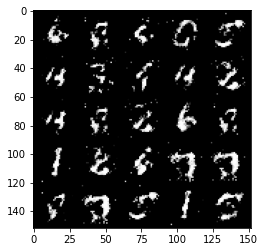

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


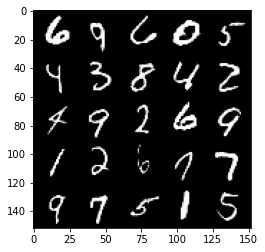

 10%|▉         | 45/469 [00:02<00:20, 20.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 66, step 31000 -> generator loss: 0.5266143023967744, discriminator loss: 0.6071516101360322


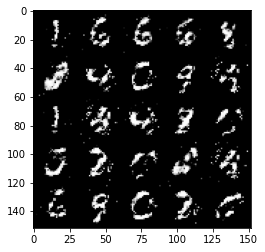

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


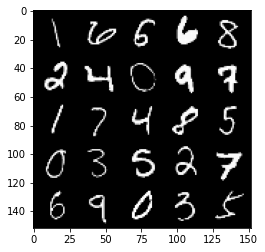

 16%|█▌        | 76/469 [00:03<00:19, 20.17it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 67, step 31500 -> generator loss: 0.517309485077858, discriminator loss: 0.6218819768428806


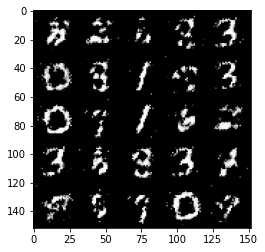

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


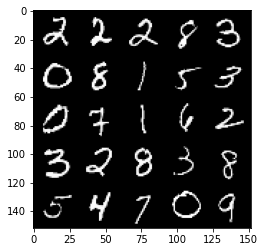

 23%|██▎       | 108/469 [00:05<00:17, 20.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 68, step 32000 -> generator loss: 0.5186019604206081, discriminator loss: 0.6173637890815735


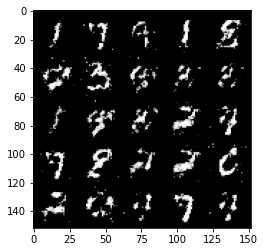

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


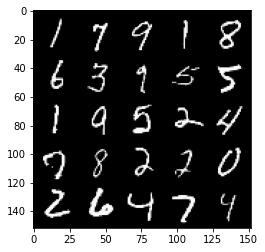

 29%|██▉       | 138/469 [00:06<00:16, 19.53it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 69, step 32500 -> generator loss: 0.5290829066038127, discriminator loss: 0.6042084774971008


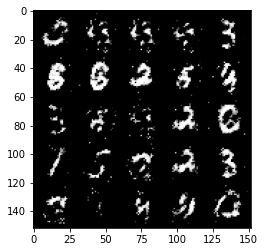

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


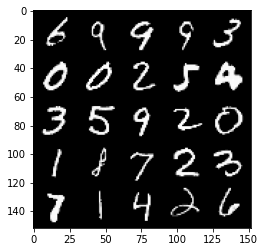

 36%|███▌      | 169/469 [00:08<00:14, 20.38it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70, step 33000 -> generator loss: 0.5160760552883145, discriminator loss: 0.6232128595113757


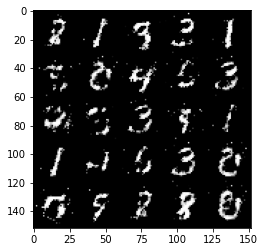

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


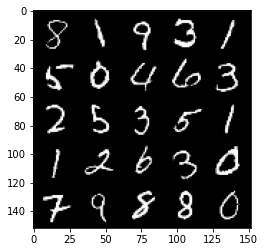

 43%|████▎     | 200/469 [00:11<00:16, 16.16it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 71, step 33500 -> generator loss: 0.5068203436732287, discriminator loss: 0.6353524538278578


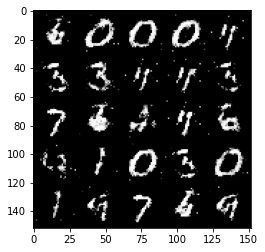

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


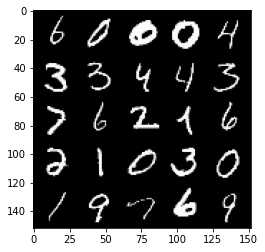

 49%|████▉     | 231/469 [00:11<00:12, 18.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 72, step 34000 -> generator loss: 0.5012488620281216, discriminator loss: 0.6381671352386471


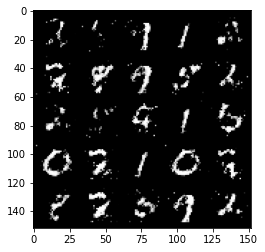

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


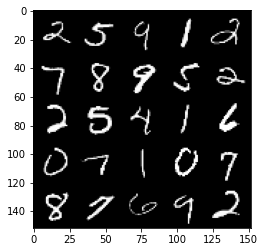

 56%|█████▌    | 262/469 [00:14<00:10, 19.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 73, step 34500 -> generator loss: 0.5089521706700322, discriminator loss: 0.6314498529434204


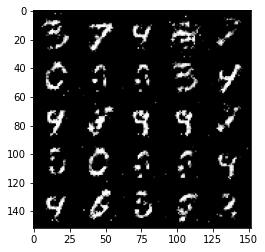

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


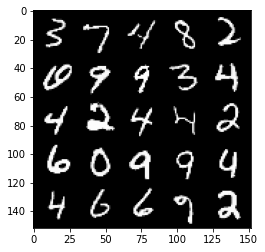

 63%|██████▎   | 294/469 [00:14<00:08, 20.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 74, step 35000 -> generator loss: 0.5019394910931588, discriminator loss: 0.6401393187046054


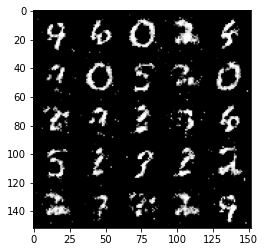

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


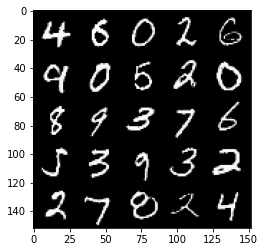

 69%|██████▉   | 325/469 [00:17<00:07, 18.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75, step 35500 -> generator loss: 0.4907855777144436, discriminator loss: 0.654871940374374


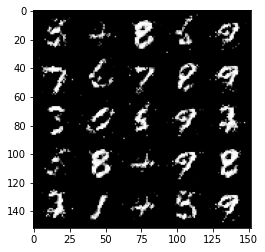

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


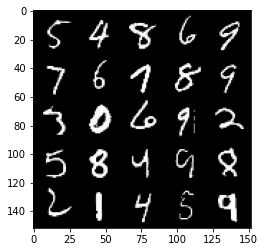

 76%|███████▌  | 356/469 [00:17<00:05, 20.18it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 76, step 36000 -> generator loss: 0.4866806944608691, discriminator loss: 0.6574822317361834


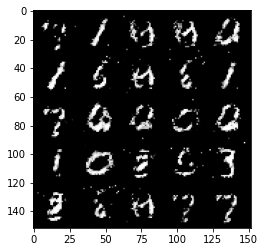

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


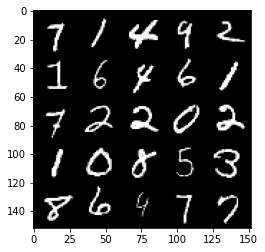

 82%|████████▏ | 385/469 [00:19<00:04, 20.09it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 77, step 36500 -> generator loss: 0.49482742124795975, discriminator loss: 0.6449326066970826


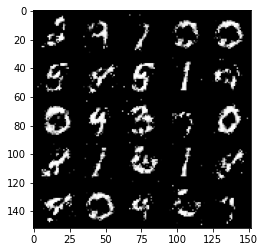

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


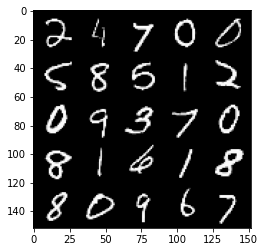

 89%|████████▊ | 416/469 [00:20<00:02, 20.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 78, step 37000 -> generator loss: 0.48868482059240304, discriminator loss: 0.6555213155746458


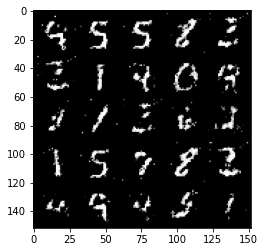

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


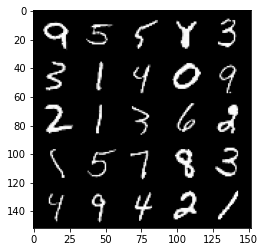

 96%|█████████▌| 449/469 [00:22<00:01, 19.47it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 79, step 37500 -> generator loss: 0.4750205180048939, discriminator loss: 0.6718635795116426


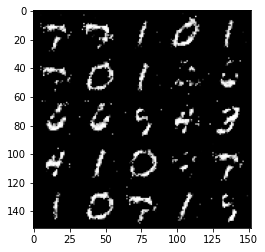

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


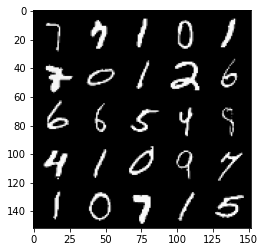

  2%|▏         | 10/469 [00:00<00:25, 17.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 81, step 38000 -> generator loss: 0.4953686159849168, discriminator loss: 0.6463724780082702


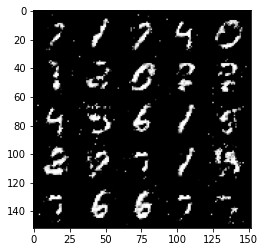

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


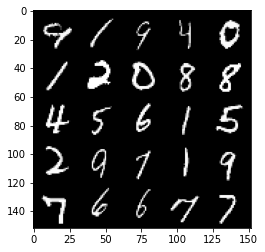

  9%|▉         | 42/469 [00:02<00:22, 18.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 82, step 38500 -> generator loss: 0.5111730890870091, discriminator loss: 0.6242911484241482


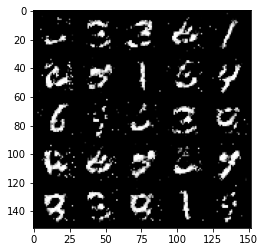

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


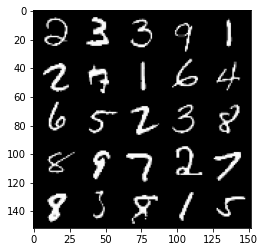

 15%|█▌        | 72/469 [00:03<00:19, 20.17it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 83, step 39000 -> generator loss: 0.526313747525215, discriminator loss: 0.6046734980344769


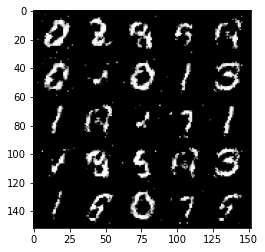

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


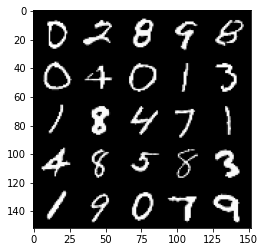

 22%|██▏       | 103/469 [00:05<00:19, 19.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 84, step 39500 -> generator loss: 0.49898890852928196, discriminator loss: 0.6408984092473986


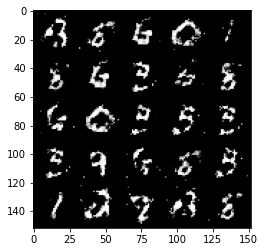

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


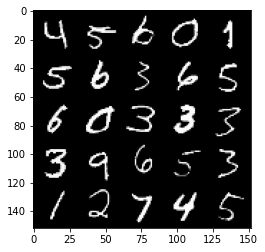

 29%|██▉       | 135/469 [00:06<00:16, 19.97it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 85, step 40000 -> generator loss: 0.4904873008131982, discriminator loss: 0.6522393838167185


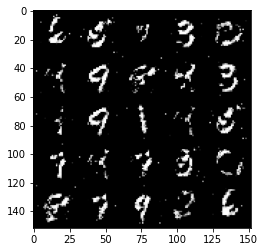

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


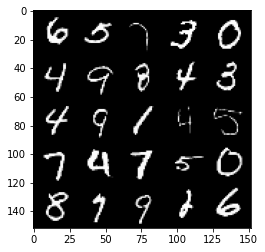

 35%|███▌      | 166/469 [00:08<00:16, 18.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 86, step 40500 -> generator loss: 0.4909150366187092, discriminator loss: 0.6516102632284166


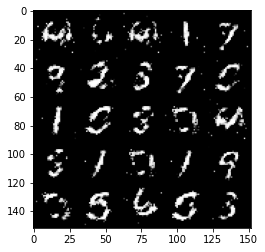

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


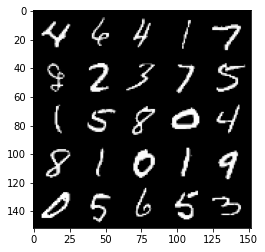

 42%|████▏     | 196/469 [00:09<00:13, 20.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 87, step 41000 -> generator loss: 0.4869077273607261, discriminator loss: 0.6556846131086351


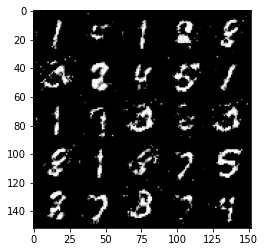

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


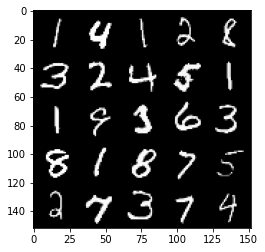

 49%|████▊     | 228/469 [00:12<00:12, 19.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 88, step 41500 -> generator loss: 0.48875945812463745, discriminator loss: 0.6573041195869446


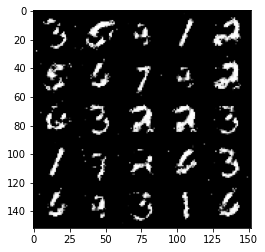

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


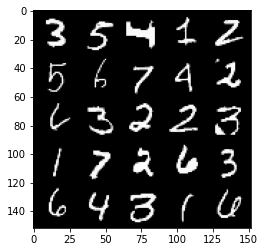

 55%|█████▍    | 257/469 [00:12<00:10, 19.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 89, step 42000 -> generator loss: 0.4817774894237515, discriminator loss: 0.6609221272468566


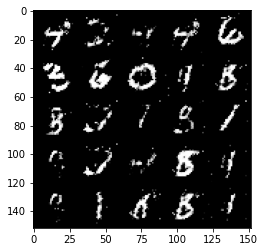

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


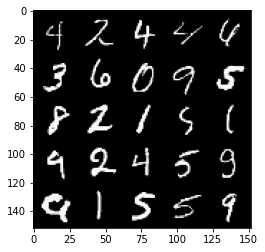

 62%|██████▏   | 289/469 [00:14<00:09, 19.02it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 90, step 42500 -> generator loss: 0.48763368231058085, discriminator loss: 0.6548949136734015


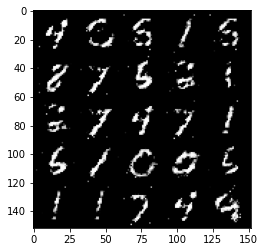

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


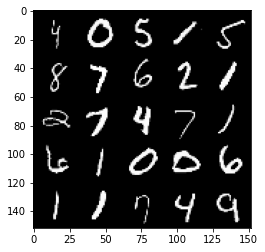

 68%|██████▊   | 321/469 [00:16<00:07, 20.06it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 91, step 43000 -> generator loss: 0.4805903581976889, discriminator loss: 0.6642958526611331


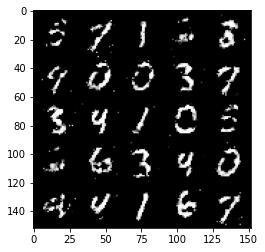

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


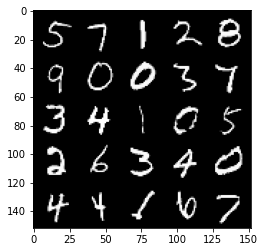

 75%|███████▍  | 351/469 [00:17<00:06, 17.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 92, step 43500 -> generator loss: 0.4746692276597022, discriminator loss: 0.6669752055406568


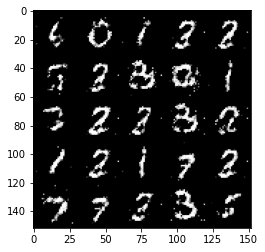

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


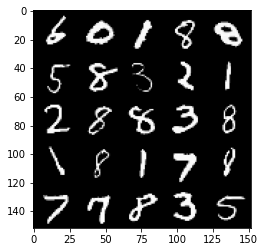

 82%|████████▏ | 383/469 [00:21<00:05, 15.95it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 93, step 44000 -> generator loss: 0.48638855093717587, discriminator loss: 0.6531991410255436


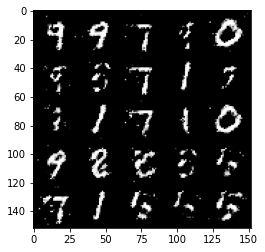

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


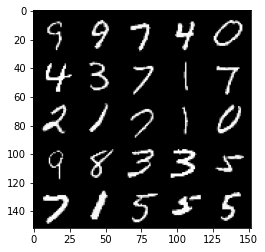

 88%|████████▊ | 413/469 [00:22<00:02, 18.91it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 94, step 44500 -> generator loss: 0.4869049215912819, discriminator loss: 0.656994231104851


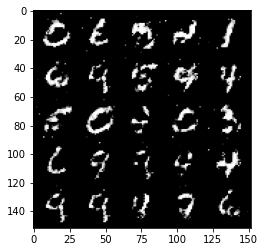

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


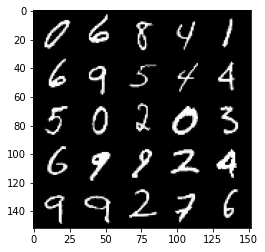

 95%|█████████▍| 444/469 [00:24<00:01, 18.36it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 95, step 45000 -> generator loss: 0.47845338976383206, discriminator loss: 0.665533910274506


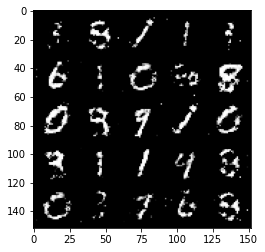

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


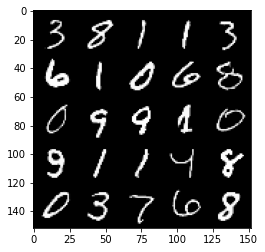

  1%|▏         | 6/469 [00:00<00:29, 15.72it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 97, step 45500 -> generator loss: 0.4805140593647956, discriminator loss: 0.6648065418004993


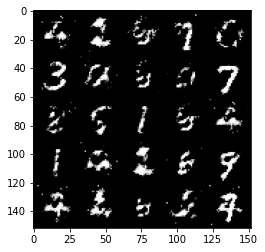

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


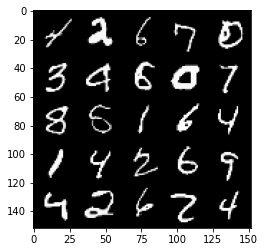

  8%|▊         | 38/469 [00:02<00:23, 18.31it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 98, step 46000 -> generator loss: 0.480775824368, discriminator loss: 0.6630442410707473


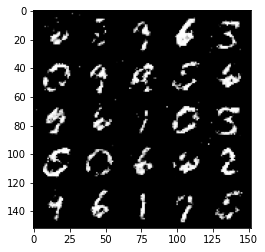

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


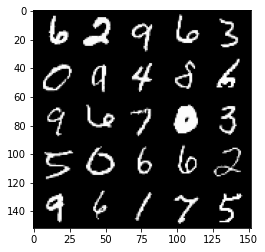

 14%|█▍        | 68/469 [00:03<00:24, 16.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 99, step 46500 -> generator loss: 0.48533926445245734, discriminator loss: 0.6586932264566422


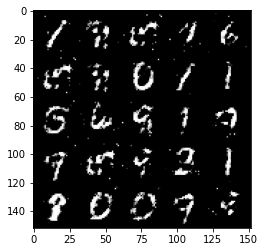

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


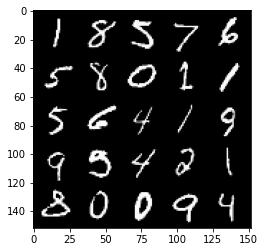

 21%|██▏       | 100/469 [00:05<00:19, 18.71it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 100, step 47000 -> generator loss: 0.4777706753611562, discriminator loss: 0.6690465800762178


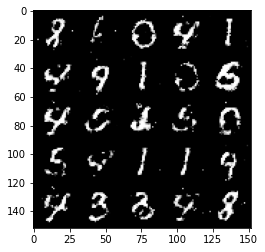

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


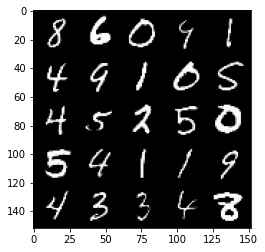

 28%|██▊       | 130/469 [00:07<00:19, 17.70it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 101, step 47500 -> generator loss: 0.471901532649994, discriminator loss: 0.6723585400581358


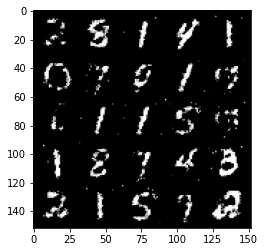

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


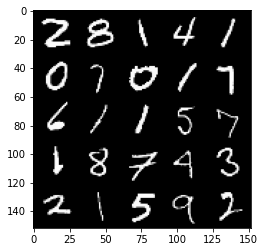

 34%|███▍      | 161/469 [00:08<00:17, 17.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 102, step 48000 -> generator loss: 0.4671641417741777, discriminator loss: 0.6838832962512976


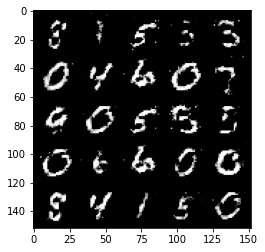

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


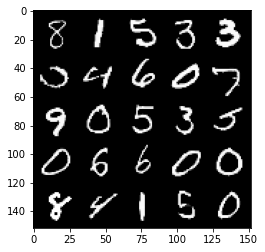

 41%|████      | 192/469 [00:10<00:14, 18.74it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 103, step 48500 -> generator loss: 0.4675138626694681, discriminator loss: 0.6790256116390224


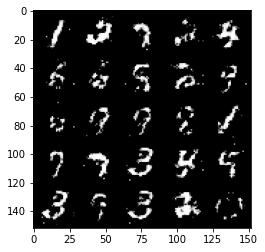

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


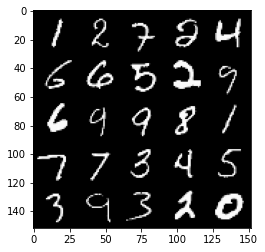

 48%|████▊     | 223/469 [00:12<00:15, 15.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 104, step 49000 -> generator loss: 0.4886243216991425, discriminator loss: 0.6479550327062611


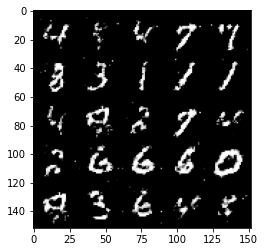

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


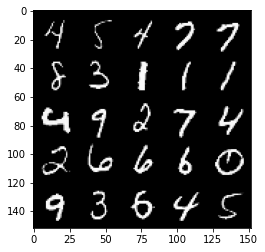

 54%|█████▍    | 255/469 [00:14<00:11, 18.52it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 105, step 49500 -> generator loss: 0.4731624356508253, discriminator loss: 0.6712382948398595


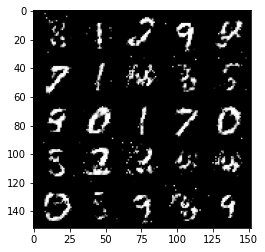

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


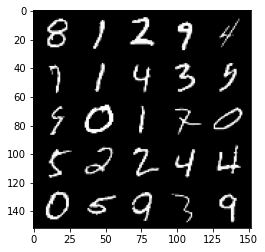

 61%|██████    | 285/469 [00:14<00:10, 17.55it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 106, step 50000 -> generator loss: 0.4833604963421819, discriminator loss: 0.6570911610126492


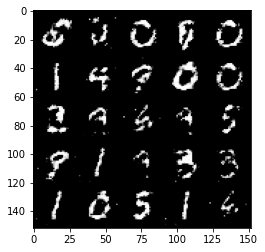

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


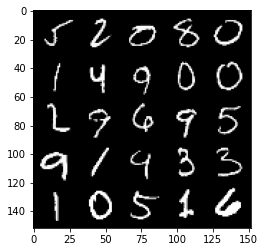

 67%|██████▋   | 316/469 [00:18<00:08, 17.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 107, step 50500 -> generator loss: 0.4773440145850175, discriminator loss: 0.6676739881038668


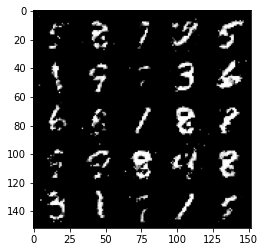

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


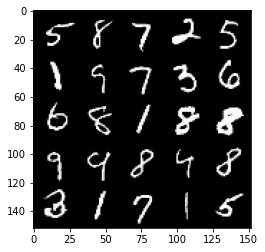

 74%|███████▍  | 348/469 [00:20<00:06, 19.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 108, step 51000 -> generator loss: 0.46155839639902113, discriminator loss: 0.6855068173408508


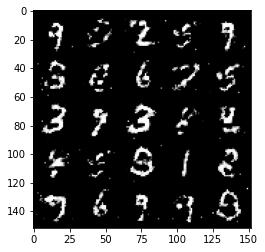

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


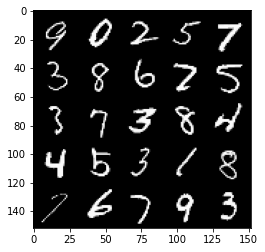

 81%|████████  | 379/469 [00:20<00:04, 19.28it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 109, step 51500 -> generator loss: 0.48634410536289174, discriminator loss: 0.6536994620561603


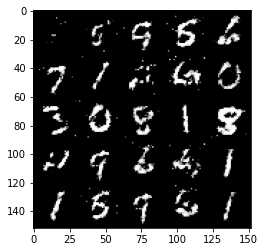

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


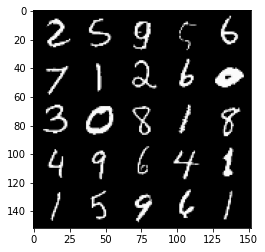

 87%|████████▋ | 410/469 [00:22<00:04, 13.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 110, step 52000 -> generator loss: 0.4763603734970091, discriminator loss: 0.666389299869537


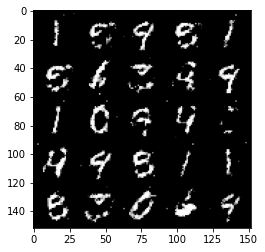

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


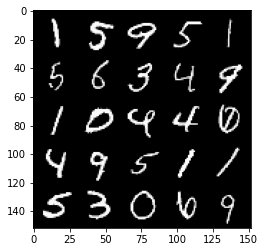

 94%|█████████▍| 440/469 [00:24<00:02, 14.50it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 111, step 52500 -> generator loss: 0.46803240334987634, discriminator loss: 0.6801217787265783


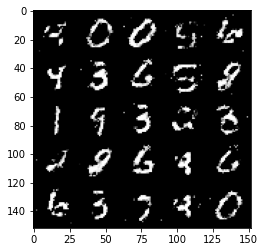

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


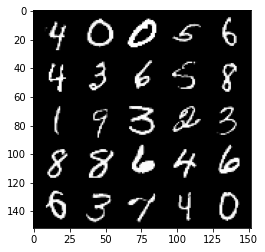

  0%|          | 2/469 [00:00<00:25, 18.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 113, step 53000 -> generator loss: 0.4671495246291158, discriminator loss: 0.6779144496917724


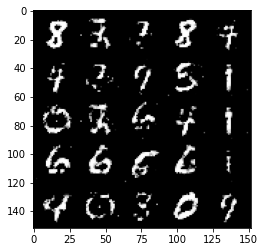

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


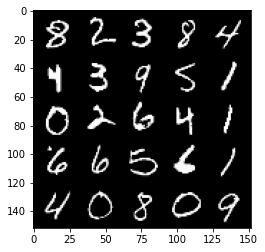

  7%|▋         | 34/469 [00:01<00:22, 19.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 114, step 53500 -> generator loss: 0.4695334802269936, discriminator loss: 0.6740006989240654


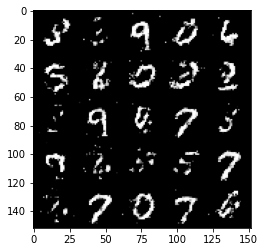

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


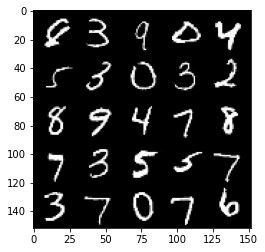

 14%|█▎        | 64/469 [00:03<00:21, 19.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 115, step 54000 -> generator loss: 0.48597718697786385, discriminator loss: 0.6554744651317604


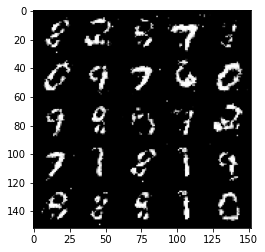

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


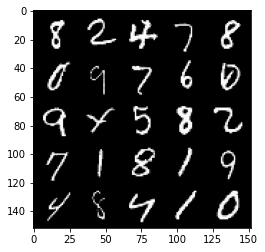

 20%|██        | 96/469 [00:06<00:27, 13.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 116, step 54500 -> generator loss: 0.4738795591592787, discriminator loss: 0.6693459994792937


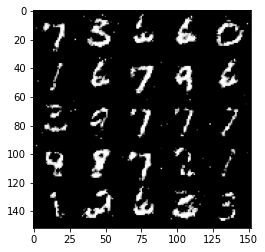

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


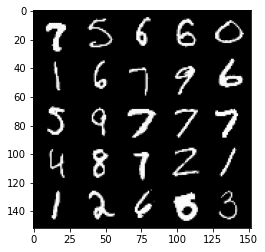

 27%|██▋       | 126/469 [00:06<00:19, 17.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 117, step 55000 -> generator loss: 0.45497885894775353, discriminator loss: 0.6960303729772568


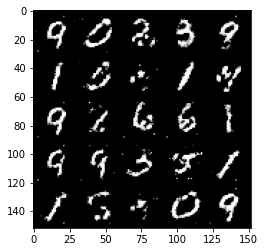

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


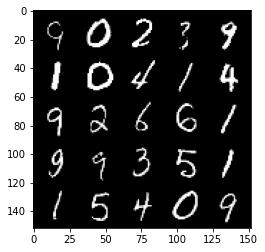

 33%|███▎      | 157/469 [00:08<00:17, 18.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 118, step 55500 -> generator loss: 0.45721544533967967, discriminator loss: 0.6918220447301864


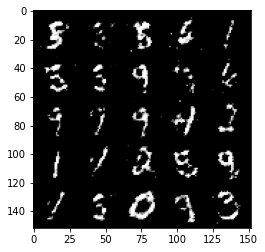

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


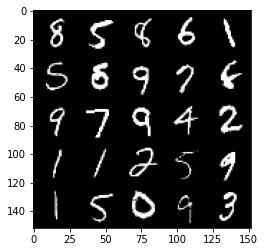

 40%|████      | 189/469 [00:09<00:14, 19.50it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 119, step 56000 -> generator loss: 0.4649585200548175, discriminator loss: 0.6850612376928327


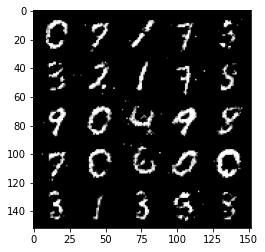

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


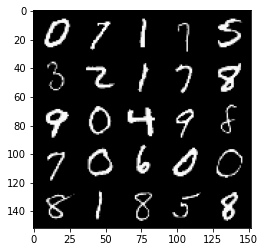

 47%|████▋     | 220/469 [00:11<00:12, 19.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 120, step 56500 -> generator loss: 0.47237558555603015, discriminator loss: 0.6725743907690054


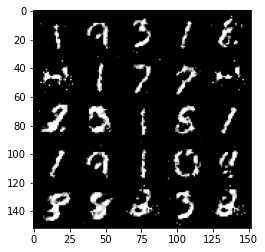

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


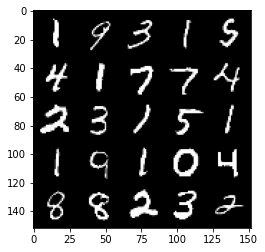

 54%|█████▎    | 251/469 [00:12<00:11, 19.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 121, step 57000 -> generator loss: 0.4620075730681419, discriminator loss: 0.6872808659076695


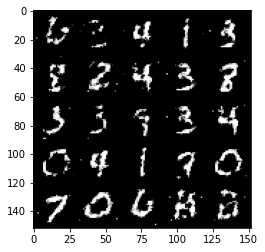

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


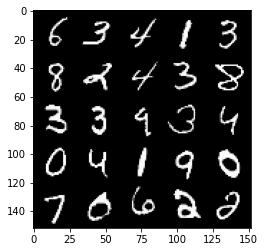

 60%|██████    | 282/469 [00:14<00:10, 18.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 122, step 57500 -> generator loss: 0.46288769865036006, discriminator loss: 0.6828631584644309


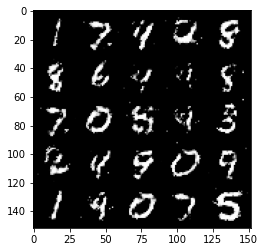

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


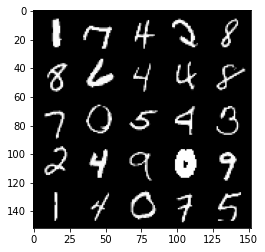

 67%|██████▋   | 313/469 [00:16<00:09, 16.93it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 123, step 58000 -> generator loss: 0.46619708091020534, discriminator loss: 0.6815055947303775


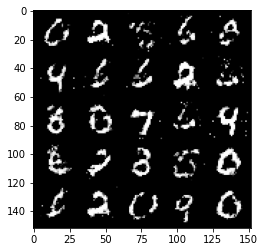

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


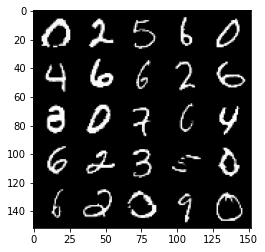

 73%|███████▎  | 344/469 [00:19<00:07, 17.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 124, step 58500 -> generator loss: 0.47137958085536924, discriminator loss: 0.6753190789222717


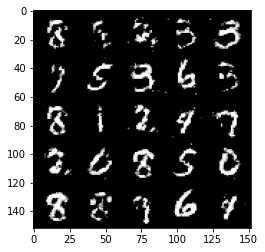

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


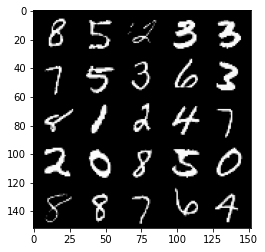

 80%|███████▉  | 374/469 [00:20<00:05, 18.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 125, step 59000 -> generator loss: 0.46035249578952825, discriminator loss: 0.6877558484077458


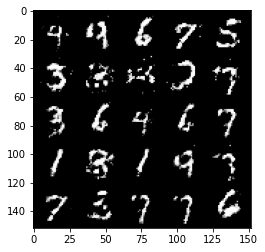

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


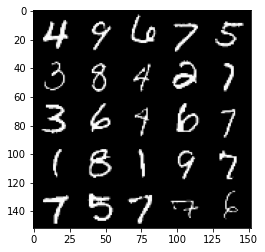

 87%|████████▋ | 406/469 [00:22<00:03, 18.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 126, step 59500 -> generator loss: 0.4605873220562938, discriminator loss: 0.6872501909732825


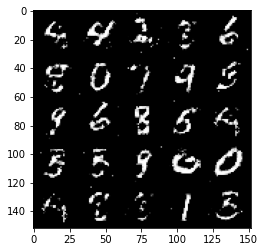

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


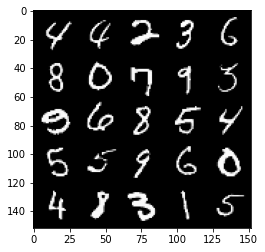

 93%|█████████▎| 436/469 [00:23<00:01, 18.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 127, step 60000 -> generator loss: 0.4573422639369966, discriminator loss: 0.6926890962123872


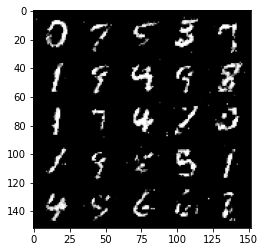

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


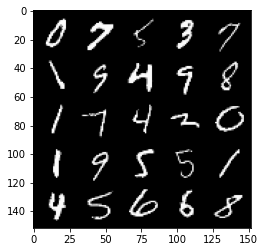

100%|█████████▉| 468/469 [00:26<00:00, 18.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 128, step 60500 -> generator loss: 0.454793102502823, discriminator loss: 0.6932360128164298


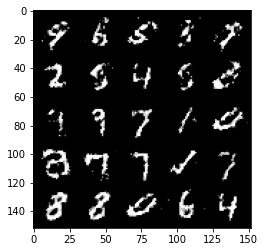

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


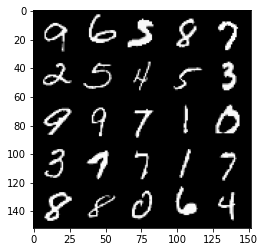

  6%|▋         | 30/469 [00:01<00:23, 19.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 130, step 61000 -> generator loss: 0.45703110998868934, discriminator loss: 0.6903761898279184


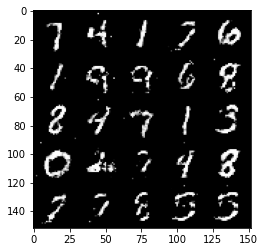

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


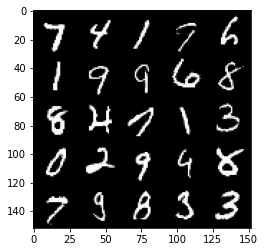

 13%|█▎        | 60/469 [00:03<00:21, 18.74it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 131, step 61500 -> generator loss: 0.45450750005245205, discriminator loss: 0.6970942668914799


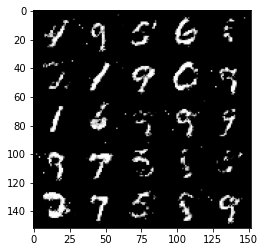

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


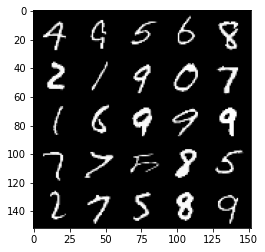

 20%|█▉        | 92/469 [00:05<00:20, 18.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 132, step 62000 -> generator loss: 0.4573618588447573, discriminator loss: 0.6901932513713835


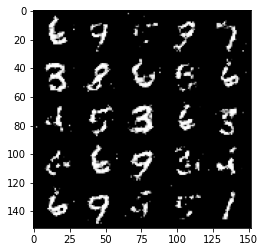

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


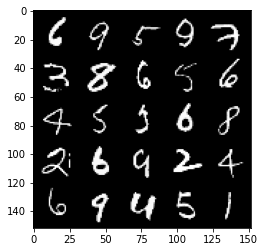

 26%|██▌       | 122/469 [00:06<00:18, 18.51it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 133, step 62500 -> generator loss: 0.46115763384103803, discriminator loss: 0.6859578965902327


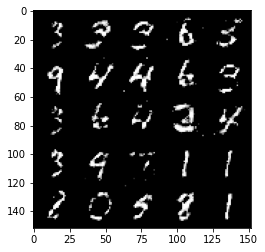

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


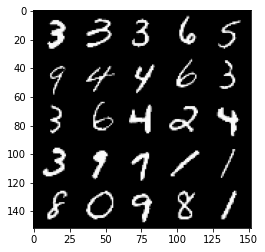

 33%|███▎      | 154/469 [00:08<00:17, 18.13it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 134, step 63000 -> generator loss: 0.457341547548771, discriminator loss: 0.6951935131549838


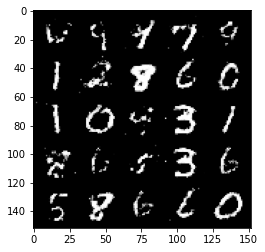

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


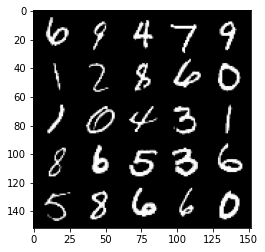

 39%|███▉      | 184/469 [00:10<00:15, 18.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 135, step 63500 -> generator loss: 0.4518435420989991, discriminator loss: 0.6970457850694658


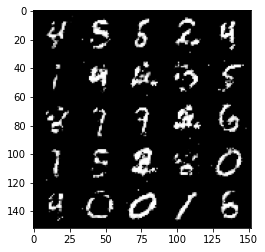

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


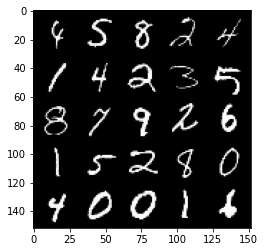

 46%|████▌     | 216/469 [00:11<00:14, 17.75it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 136, step 64000 -> generator loss: 0.45687930959463163, discriminator loss: 0.6917058795690529


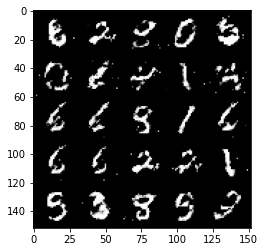

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


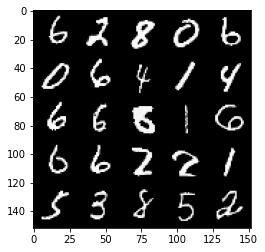

 52%|█████▏    | 246/469 [00:14<00:12, 17.74it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 137, step 64500 -> generator loss: 0.4558727723360057, discriminator loss: 0.6942156715393064


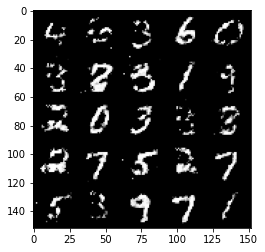

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


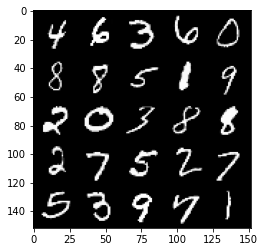

 59%|█████▉    | 278/469 [00:15<00:10, 18.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 138, step 65000 -> generator loss: 0.4554507357478138, discriminator loss: 0.6950269513130192


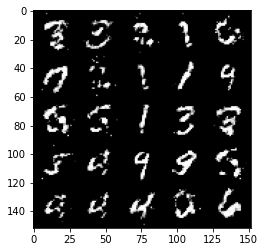

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


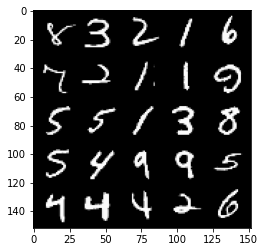

 66%|██████▌   | 308/469 [00:17<00:08, 18.02it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 139, step 65500 -> generator loss: 0.451893602848053, discriminator loss: 0.6958021619319921


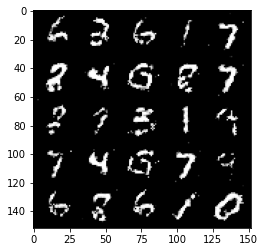

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


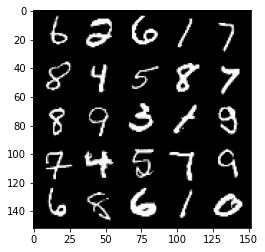

 72%|███████▏  | 340/469 [00:20<00:07, 18.26it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 140, step 66000 -> generator loss: 0.4541189078092574, discriminator loss: 0.6943727381229396


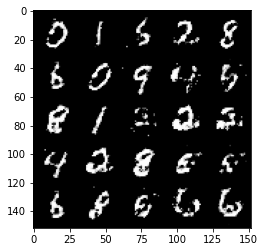

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


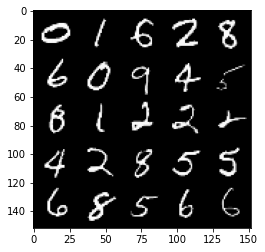

 79%|███████▉  | 370/469 [00:21<00:06, 14.72it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 141, step 66500 -> generator loss: 0.4570041329860687, discriminator loss: 0.6903898525238039


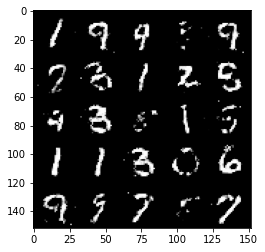

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


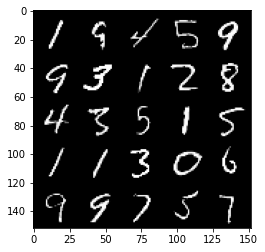

 86%|████████▌ | 402/469 [00:21<00:03, 19.07it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 142, step 67000 -> generator loss: 0.4618749465942386, discriminator loss: 0.685186926126481


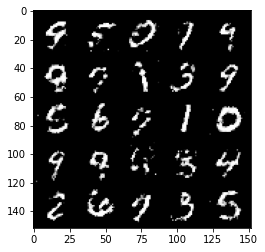

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


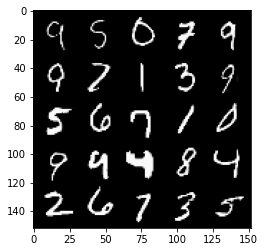

 92%|█████████▏| 432/469 [00:23<00:01, 19.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 143, step 67500 -> generator loss: 0.45182877981662745, discriminator loss: 0.6985921761989592


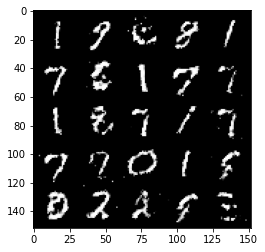

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


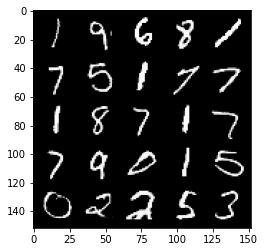

 99%|█████████▉| 464/469 [00:25<00:00, 18.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 144, step 68000 -> generator loss: 0.4523195781707765, discriminator loss: 0.6962221190929416


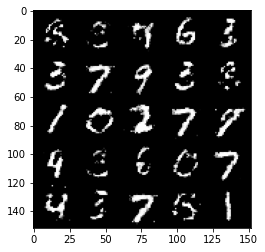

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


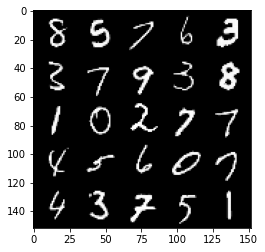

  6%|▌         | 26/469 [00:01<00:22, 19.52it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 146, step 68500 -> generator loss: 0.4561025298833844, discriminator loss: 0.6954895906448365


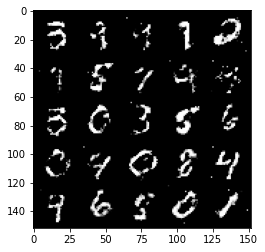

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


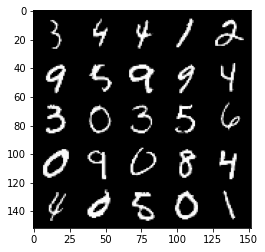

 12%|█▏        | 56/469 [00:02<00:21, 19.58it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 147, step 69000 -> generator loss: 0.45438373029232076, discriminator loss: 0.6956845190525052


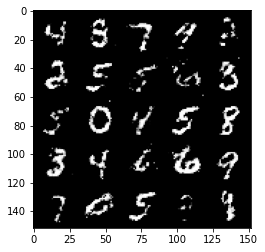

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


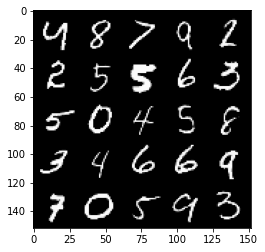

 19%|█▊        | 87/469 [00:04<00:19, 19.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 148, step 69500 -> generator loss: 0.45960714310407647, discriminator loss: 0.6880263130664819


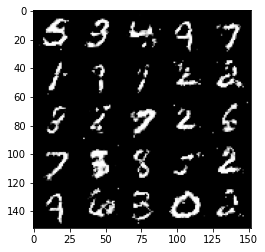

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


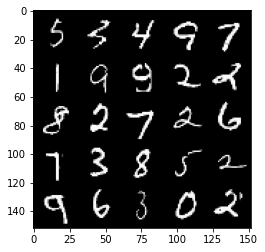

 25%|██▌       | 118/469 [00:06<00:19, 18.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 149, step 70000 -> generator loss: 0.45122105097770665, discriminator loss: 0.696113080501556


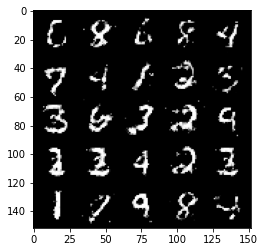

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


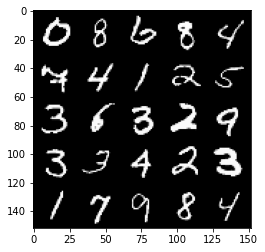

 32%|███▏      | 150/469 [00:07<00:16, 19.88it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 150, step 70500 -> generator loss: 0.45382397359609605, discriminator loss: 0.6952612094879161


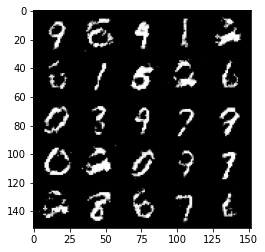

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


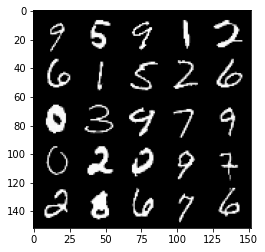

 38%|███▊      | 180/469 [00:09<00:14, 19.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 151, step 71000 -> generator loss: 0.46141994905471795, discriminator loss: 0.6885792089700697


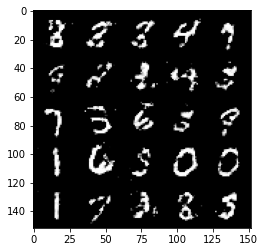

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


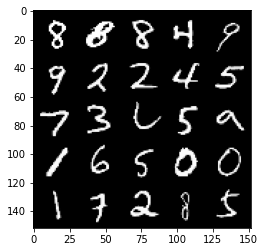

 45%|████▌     | 212/469 [00:10<00:12, 19.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 152, step 71500 -> generator loss: 0.4549656830430035, discriminator loss: 0.6924313956499104


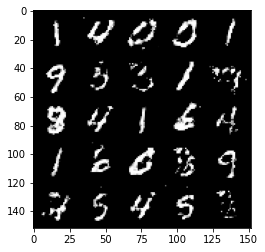

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


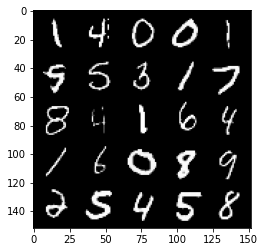

 52%|█████▏    | 243/469 [00:12<00:11, 19.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 153, step 72000 -> generator loss: 0.4537876971364019, discriminator loss: 0.695492747187615


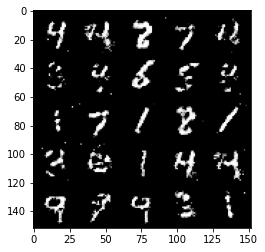

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


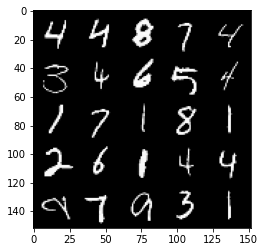

 58%|█████▊    | 274/469 [00:13<00:09, 19.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 154, step 72500 -> generator loss: 0.46045565807819333, discriminator loss: 0.6882028322219851


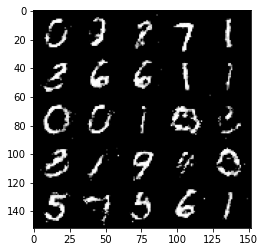

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


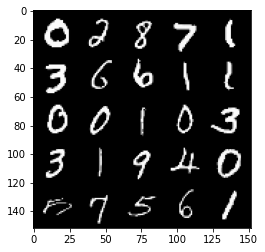

 65%|██████▍   | 304/469 [00:16<00:11, 14.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 155, step 73000 -> generator loss: 0.45939707410335545, discriminator loss: 0.6877714631557461


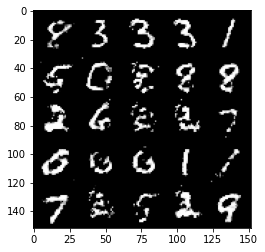

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


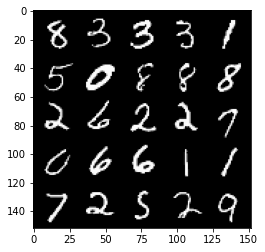

 72%|███████▏  | 336/469 [00:17<00:06, 19.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 156, step 73500 -> generator loss: 0.44911202353239044, discriminator loss: 0.7013468147516256


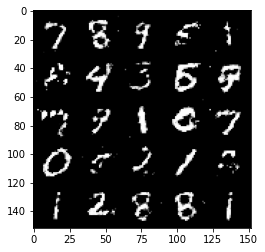

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


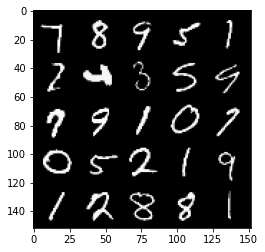

 78%|███████▊  | 366/469 [00:22<00:05, 17.68it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 157, step 74000 -> generator loss: 0.45382748353481317, discriminator loss: 0.6988536008596429


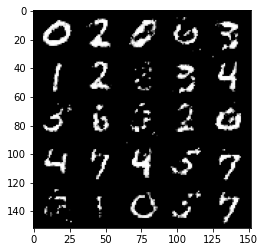

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


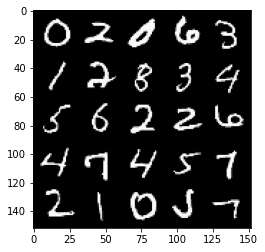

 85%|████████▍ | 398/469 [00:22<00:04, 17.66it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 158, step 74500 -> generator loss: 0.4573421990871427, discriminator loss: 0.6895086745023722


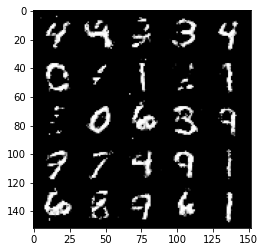

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


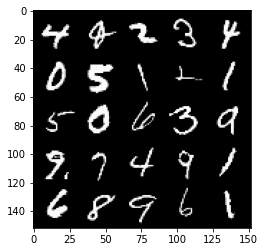

 91%|█████████▏| 428/469 [00:25<00:02, 17.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 159, step 75000 -> generator loss: 0.45228745353221844, discriminator loss: 0.6984654886722567


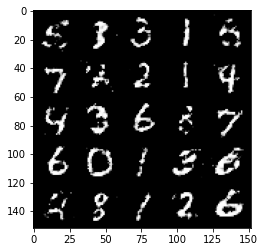

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


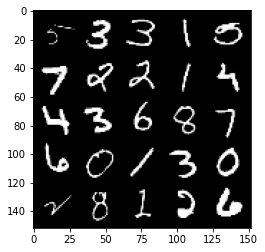

 98%|█████████▊| 460/469 [00:26<00:00, 17.71it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 160, step 75500 -> generator loss: 0.4556405171751974, discriminator loss: 0.6923616484403614


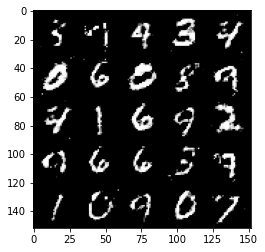

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


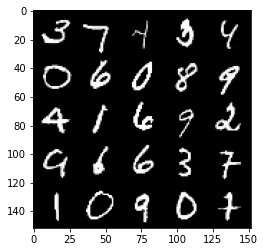

  5%|▍         | 22/469 [00:01<00:24, 18.37it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 162, step 76000 -> generator loss: 0.447223964869976, discriminator loss: 0.705724056482315


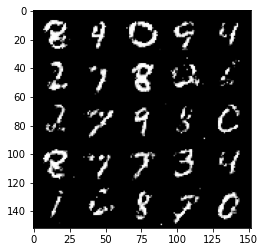

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


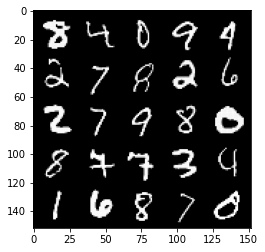

 11%|█         | 52/469 [00:02<00:23, 18.10it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 163, step 76500 -> generator loss: 0.4497583047747614, discriminator loss: 0.7015315592288974


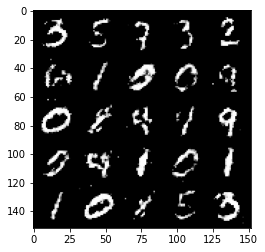

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


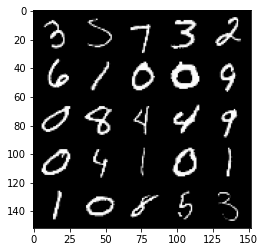

 18%|█▊        | 84/469 [00:04<00:21, 18.19it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 164, step 77000 -> generator loss: 0.4582102927565573, discriminator loss: 0.6890394706726066


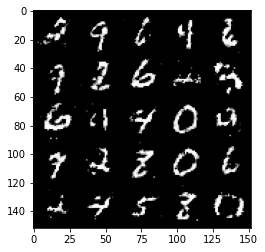

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


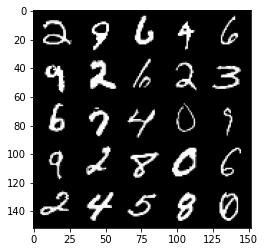

 24%|██▍       | 114/469 [00:06<00:19, 17.78it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 165, step 77500 -> generator loss: 0.4576208130717283, discriminator loss: 0.689267706155776


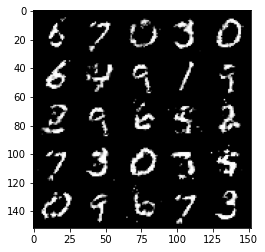

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


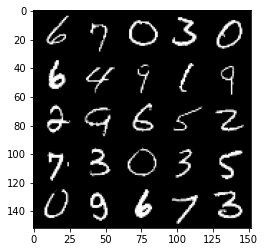

 31%|███       | 146/469 [00:08<00:18, 17.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 166, step 78000 -> generator loss: 0.454988138437271, discriminator loss: 0.6949183670282355


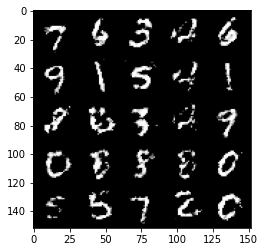

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


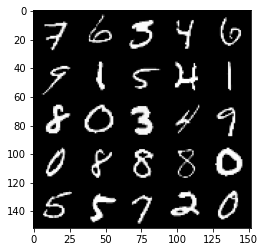

 38%|███▊      | 176/469 [00:10<00:16, 17.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 167, step 78500 -> generator loss: 0.452545828461647, discriminator loss: 0.6960246126651768


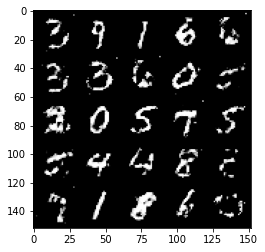

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


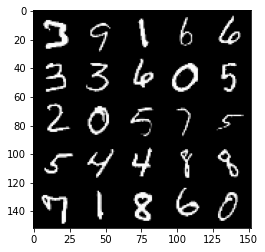

 44%|████▍     | 208/469 [00:12<00:16, 16.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 168, step 79000 -> generator loss: 0.45725355803966533, discriminator loss: 0.689604465484619


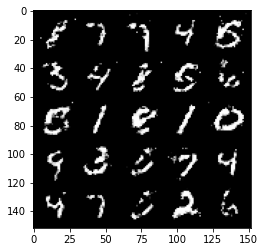

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


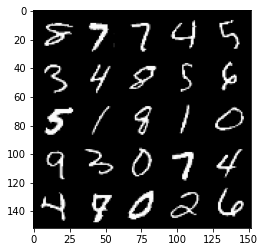

 51%|█████     | 238/469 [00:13<00:12, 18.10it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 169, step 79500 -> generator loss: 0.44523285394907, discriminator loss: 0.7059092437028881


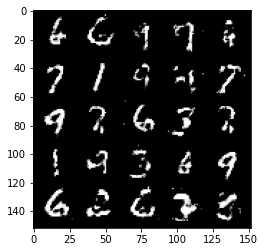

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


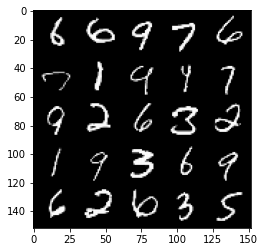

 58%|█████▊    | 270/469 [00:15<00:11, 17.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 170, step 80000 -> generator loss: 0.445753783285618, discriminator loss: 0.7058207534551619


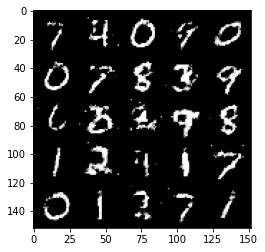

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


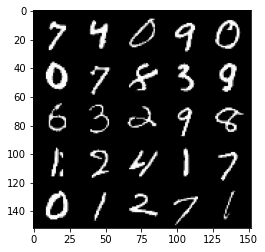

 64%|██████▍   | 300/469 [00:16<00:09, 17.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 171, step 80500 -> generator loss: 0.44860066920518926, discriminator loss: 0.705599335551262


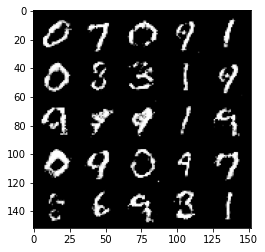

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


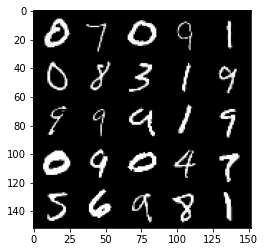

 71%|███████   | 332/469 [00:18<00:07, 17.88it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 172, step 81000 -> generator loss: 0.45103236454725265, discriminator loss: 0.6992499098777775


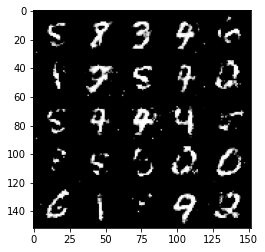

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


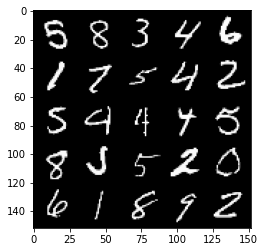

 77%|███████▋  | 362/469 [00:20<00:05, 18.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 173, step 81500 -> generator loss: 0.4548148845434187, discriminator loss: 0.6957201032638559


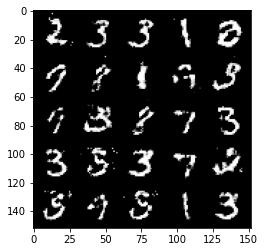

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


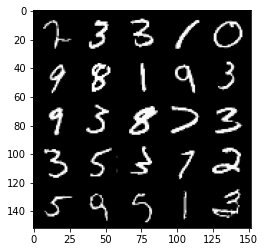

 84%|████████▍ | 394/469 [00:21<00:03, 18.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 174, step 82000 -> generator loss: 0.44597283536195736, discriminator loss: 0.7089249428510664


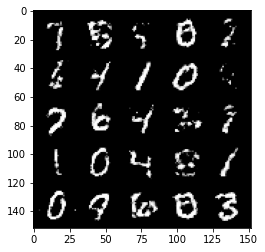

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


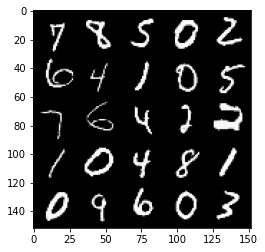

 90%|█████████ | 424/469 [00:22<00:03, 13.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 175, step 82500 -> generator loss: 0.4544286473989487, discriminator loss: 0.6944264198541643


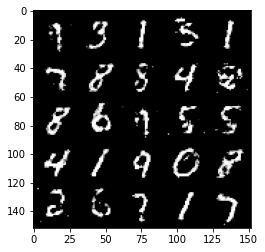

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


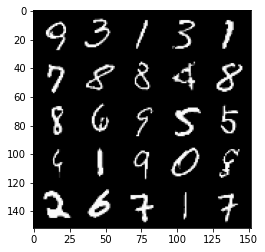

 97%|█████████▋| 456/469 [00:24<00:00, 18.94it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 176, step 83000 -> generator loss: 0.44683497893810253, discriminator loss: 0.7053880962133401


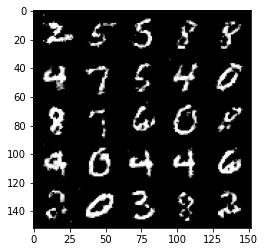

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


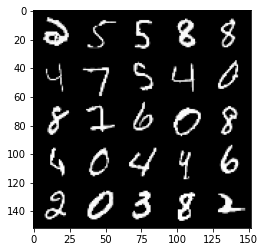

  4%|▍         | 18/469 [00:01<00:24, 18.07it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 178, step 83500 -> generator loss: 0.44318566954135913, discriminator loss: 0.7093726309537887


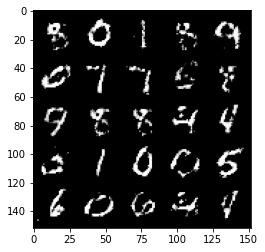

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


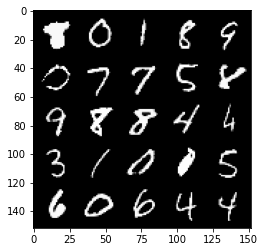

 10%|█         | 48/469 [00:02<00:22, 18.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 179, step 84000 -> generator loss: 0.44898302620649383, discriminator loss: 0.6998540425300596


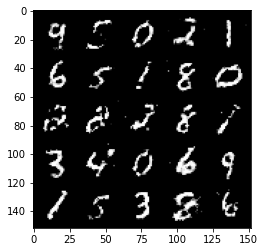

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


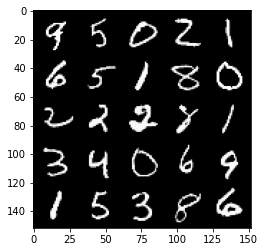

 17%|█▋        | 79/469 [00:04<00:20, 19.36it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 180, step 84500 -> generator loss: 0.4495802609324461, discriminator loss: 0.7030035489797591


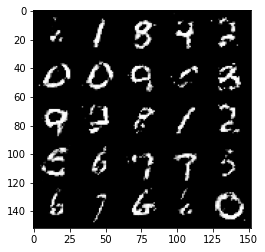

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


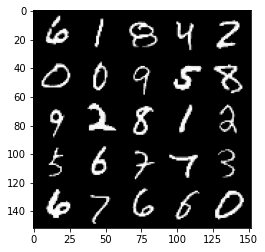

 23%|██▎       | 110/469 [00:05<00:18, 19.39it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 181, step 85000 -> generator loss: 0.4498032080531118, discriminator loss: 0.6992099775075916


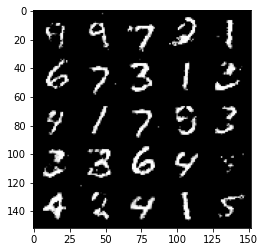

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


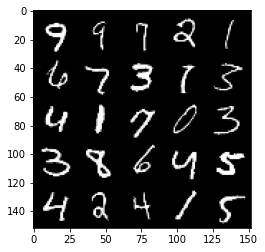

 30%|███       | 142/469 [00:07<00:16, 19.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 182, step 85500 -> generator loss: 0.44537718963623035, discriminator loss: 0.7073673119544986


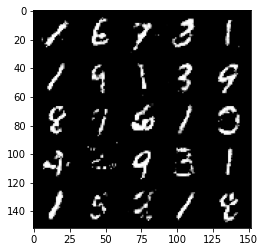

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


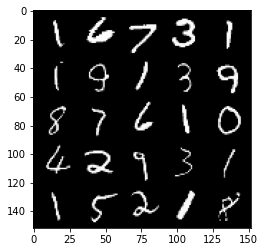

 37%|███▋      | 172/469 [00:08<00:15, 18.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 183, step 86000 -> generator loss: 0.4501701455116274, discriminator loss: 0.6969106932878489


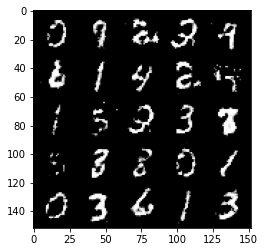

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


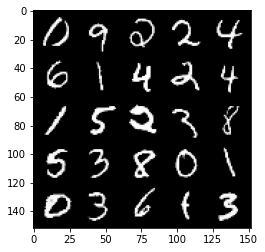

 43%|████▎     | 203/469 [00:10<00:13, 19.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 184, step 86500 -> generator loss: 0.45136381685733784, discriminator loss: 0.7012352514266963


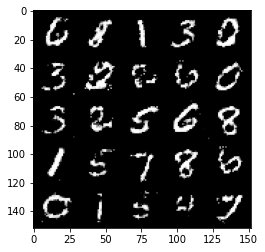

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


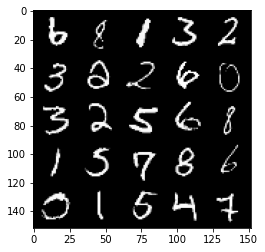

 50%|█████     | 235/469 [00:12<00:12, 19.40it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 185, step 87000 -> generator loss: 0.44519096893072124, discriminator loss: 0.707771023511887


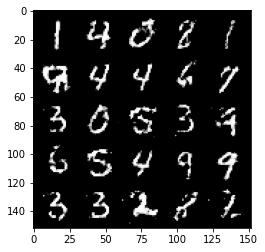

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


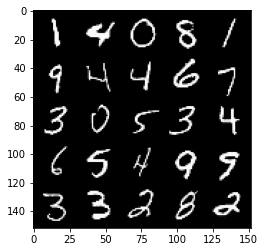

 57%|█████▋    | 265/469 [00:13<00:11, 18.16it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 186, step 87500 -> generator loss: 0.4435051609873771, discriminator loss: 0.7083811223506925


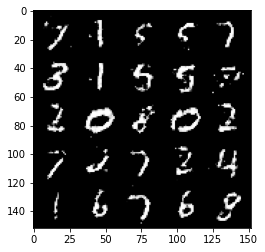

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


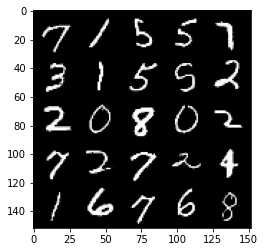

 63%|██████▎   | 296/469 [00:15<00:08, 19.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 187, step 88000 -> generator loss: 0.44900716876983626, discriminator loss: 0.7013941394090651


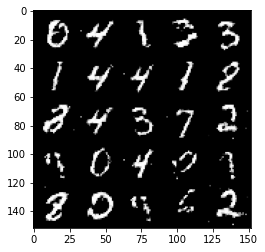

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


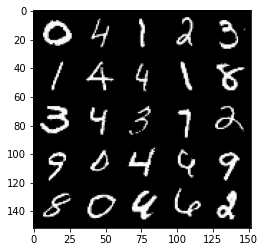

 70%|██████▉   | 327/469 [00:19<00:08, 16.88it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 188, step 88500 -> generator loss: 0.44689425396919275, discriminator loss: 0.7040320141315453


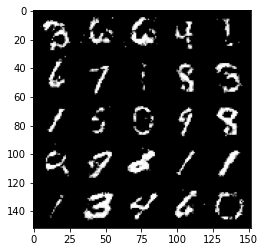

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


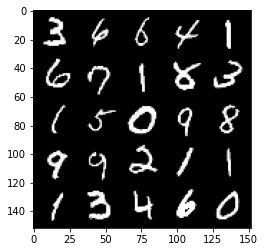

 76%|███████▋  | 358/469 [00:19<00:06, 18.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 189, step 89000 -> generator loss: 0.45243118470907223, discriminator loss: 0.6980369518995277


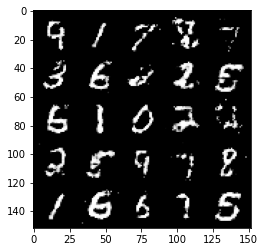

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


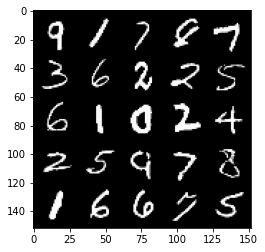

 83%|████████▎ | 389/469 [00:20<00:04, 19.51it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 190, step 89500 -> generator loss: 0.4452324566841126, discriminator loss: 0.7068654538393025


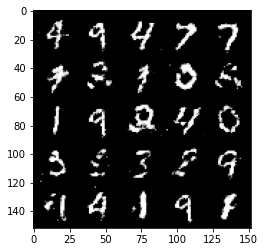

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


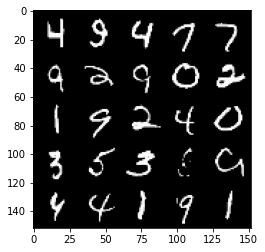

 90%|████████▉ | 421/469 [00:24<00:02, 17.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 191, step 90000 -> generator loss: 0.4488158017992968, discriminator loss: 0.7026895692348484


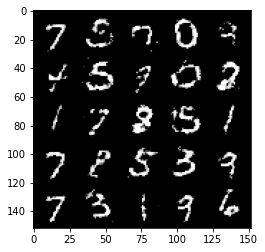

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


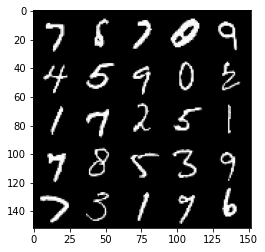

 96%|█████████▋| 452/469 [00:25<00:01, 16.91it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 192, step 90500 -> generator loss: 0.4500975084304812, discriminator loss: 0.7011673866510394


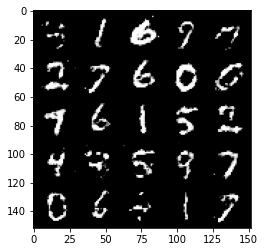

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


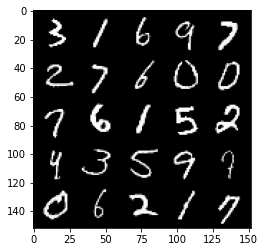

  3%|▎         | 14/469 [00:00<00:25, 17.95it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 194, step 91000 -> generator loss: 0.44710681587457685, discriminator loss: 0.7057499994039536


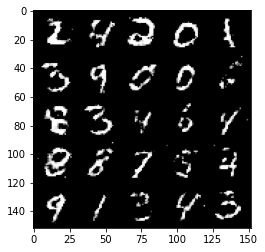

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


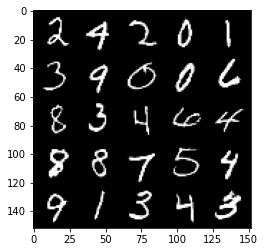

  9%|▉         | 44/469 [00:02<00:23, 18.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 195, step 91500 -> generator loss: 0.44903732454776735, discriminator loss: 0.7019910423755649


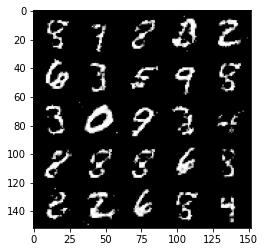

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


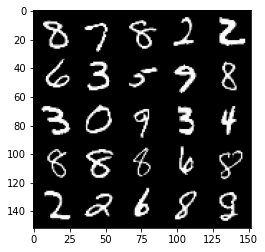

 16%|█▌        | 76/469 [00:04<00:22, 17.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 196, step 92000 -> generator loss: 0.44860447460412944, discriminator loss: 0.7023680595159535


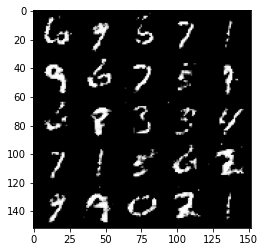

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


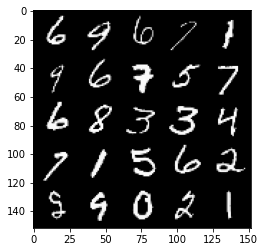

 23%|██▎       | 106/469 [00:05<00:19, 18.51it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 197, step 92500 -> generator loss: 0.4417993252873416, discriminator loss: 0.7109581686258322


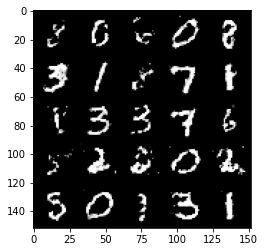

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


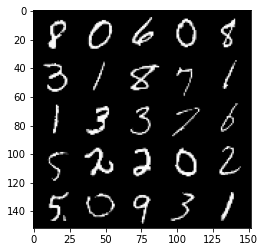

 29%|██▉       | 138/469 [00:07<00:19, 17.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 198, step 93000 -> generator loss: 0.4479095591902729, discriminator loss: 0.7031526085138331


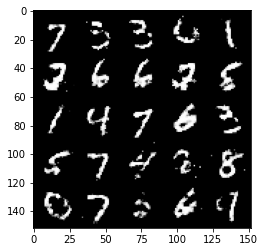

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


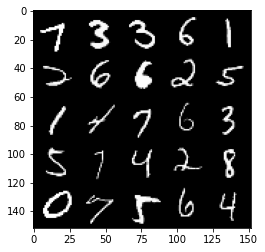

 36%|███▌      | 168/469 [00:09<00:16, 18.26it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 199, step 93500 -> generator loss: 0.4453835707306861, discriminator loss: 0.7082196596860896


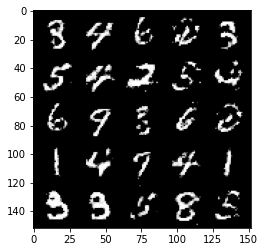

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


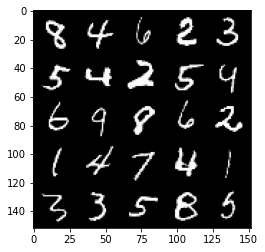

 43%|████▎     | 200/469 [00:11<00:14, 18.36it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 200, step 94000 -> generator loss: 0.44960580474138273, discriminator loss: 0.6997990859746931


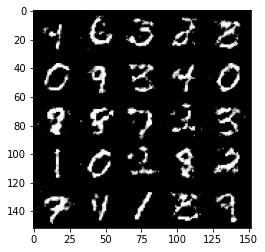

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


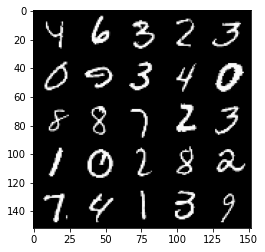

 49%|████▉     | 230/469 [00:12<00:13, 17.67it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 201, step 94500 -> generator loss: 0.44766030138731017, discriminator loss: 0.7041280460357655


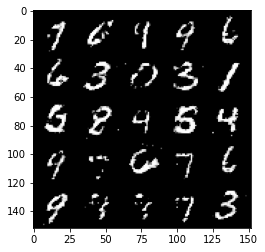

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


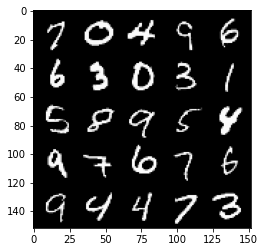

 56%|█████▌    | 262/469 [00:14<00:11, 18.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 202, step 95000 -> generator loss: 0.45126670640707034, discriminator loss: 0.6979934070110324


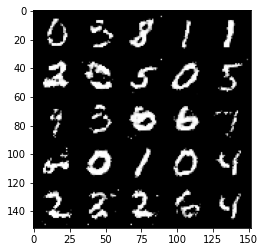

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


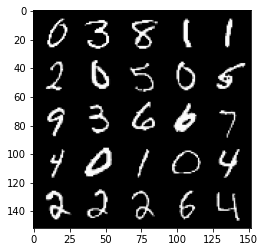

 62%|██████▏   | 292/469 [00:17<00:15, 11.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 203, step 95500 -> generator loss: 0.44408670240640674, discriminator loss: 0.7076186674833305


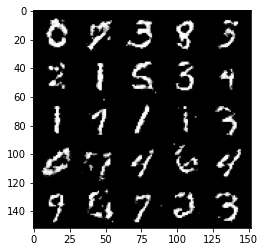

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


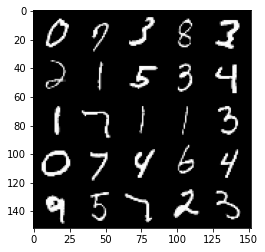

 69%|██████▉   | 324/469 [00:17<00:07, 18.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 204, step 96000 -> generator loss: 0.45167556351423305, discriminator loss: 0.6965844168663019


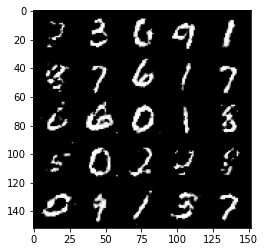

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


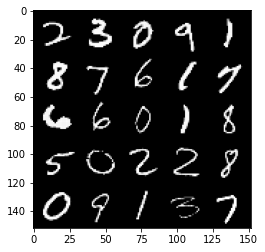

 76%|███████▌  | 355/469 [00:20<00:06, 16.40it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 205, step 96500 -> generator loss: 0.4470663613080978, discriminator loss: 0.7030803210735324


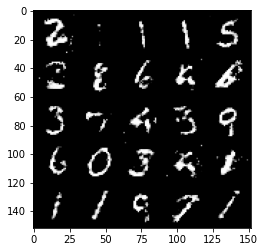

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


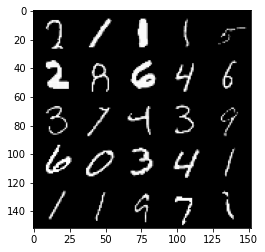

 82%|████████▏ | 386/469 [00:20<00:04, 18.79it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 206, step 97000 -> generator loss: 0.4464156306982038, discriminator loss: 0.7060101587772374


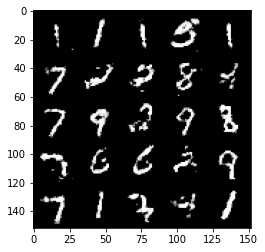

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


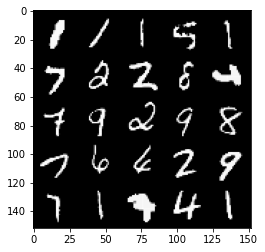

 89%|████████▊ | 416/469 [00:22<00:02, 19.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 207, step 97500 -> generator loss: 0.4455383117794992, discriminator loss: 0.7095505461692807


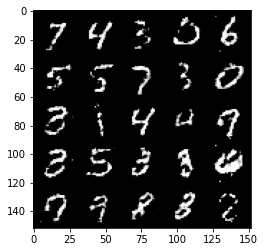

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


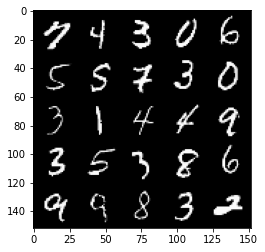

 96%|█████████▌| 448/469 [00:23<00:01, 18.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 208, step 98000 -> generator loss: 0.4437778101563452, discriminator loss: 0.7076726492643359


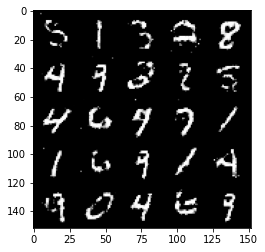

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


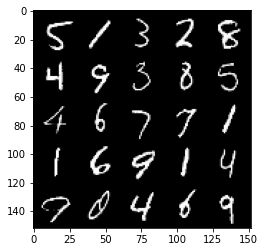

  2%|▏         | 10/469 [00:00<00:26, 17.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 210, step 98500 -> generator loss: 0.4440248371958733, discriminator loss: 0.7060683405399326


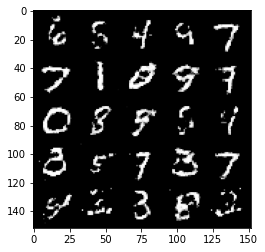

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


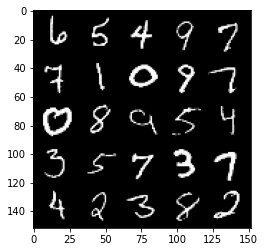

  9%|▊         | 41/469 [00:04<00:29, 14.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 211, step 99000 -> generator loss: 0.4417193077802659, discriminator loss: 0.7114829101562493


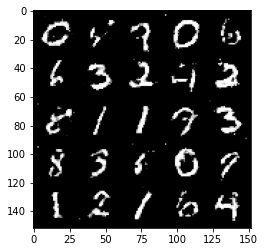

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


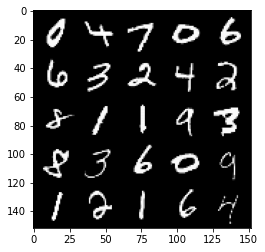

 15%|█▌        | 72/469 [00:04<00:22, 17.80it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 212, step 99500 -> generator loss: 0.4505191421508786, discriminator loss: 0.7011879863739009


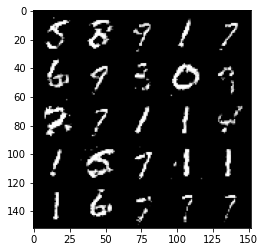

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


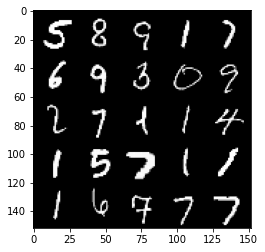

 22%|██▏       | 102/469 [00:06<00:24, 15.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 213, step 100000 -> generator loss: 0.4502464942932126, discriminator loss: 0.6989057985544206


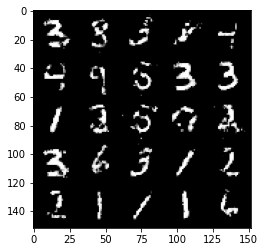

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


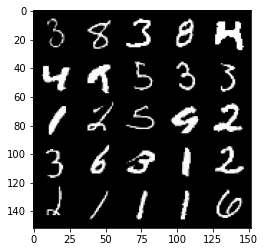

 29%|██▊       | 134/469 [00:07<00:19, 17.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 214, step 100500 -> generator loss: 0.4444027172923086, discriminator loss: 0.7072910951375959


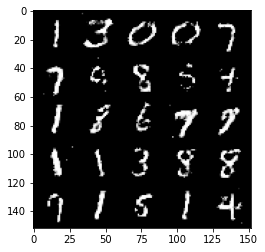

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


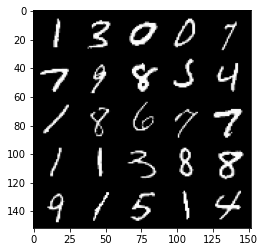

 35%|███▍      | 164/469 [00:09<00:17, 17.58it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 215, step 101000 -> generator loss: 0.44378124296665167, discriminator loss: 0.7066842387914656


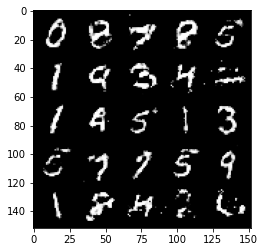

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


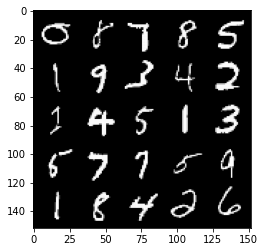

 42%|████▏     | 196/469 [00:11<00:15, 17.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 216, step 101500 -> generator loss: 0.44798258602619184, discriminator loss: 0.704556585431099


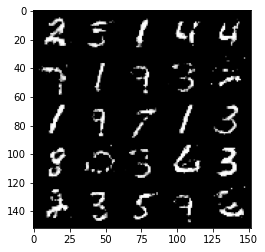

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


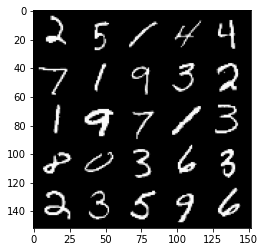

 48%|████▊     | 226/469 [00:13<00:14, 16.58it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 217, step 102000 -> generator loss: 0.4443882493972775, discriminator loss: 0.7069929715394968


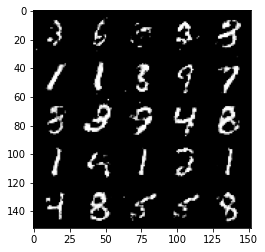

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


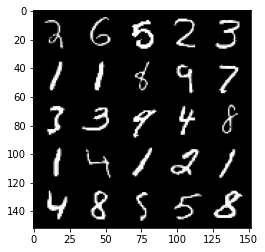

 55%|█████▌    | 258/469 [00:15<00:12, 17.51it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 218, step 102500 -> generator loss: 0.44526958435773867, discriminator loss: 0.7057567274570465


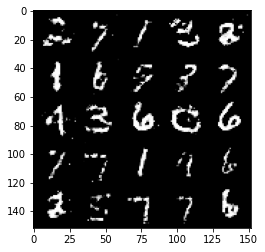

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


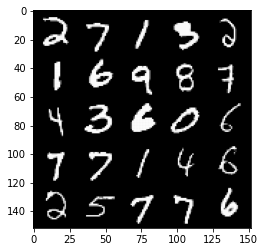

 61%|██████▏   | 288/469 [00:15<00:09, 18.68it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 219, step 103000 -> generator loss: 0.44394010215997726, discriminator loss: 0.708833362936973


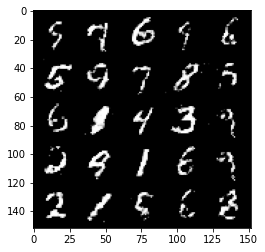

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


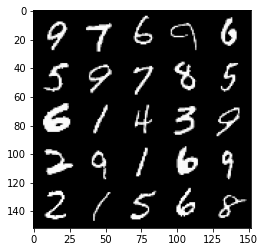

 68%|██████▊   | 320/469 [00:17<00:08, 18.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 220, step 103500 -> generator loss: 0.4437684060335162, discriminator loss: 0.7086210148334499


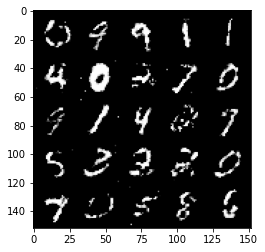

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


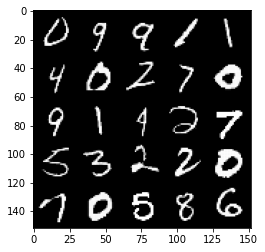

 75%|███████▍  | 350/469 [00:19<00:06, 18.90it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 221, step 104000 -> generator loss: 0.45015652847290016, discriminator loss: 0.698731141328811


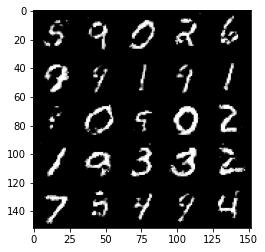

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


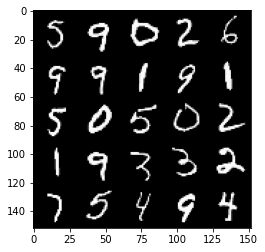

 81%|████████▏ | 382/469 [00:20<00:04, 18.53it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 222, step 104500 -> generator loss: 0.4386781169772144, discriminator loss: 0.7175068999528895


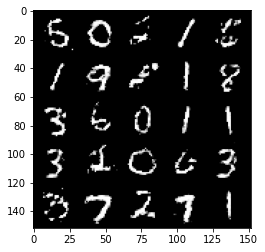

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


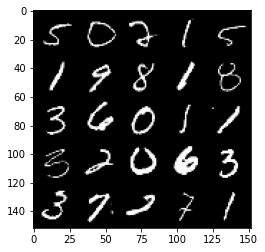

 88%|████████▊ | 412/469 [00:23<00:03, 18.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 223, step 105000 -> generator loss: 0.43976087909936884, discriminator loss: 0.7139470753669743


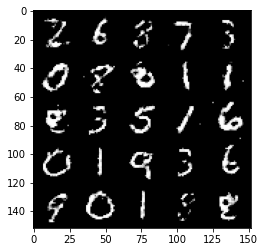

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


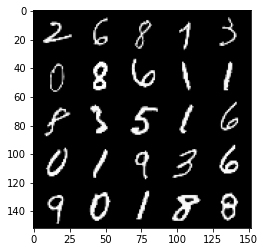

 95%|█████████▍| 444/469 [00:24<00:01, 17.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 224, step 105500 -> generator loss: 0.4390563973188401, discriminator loss: 0.7146560878753655


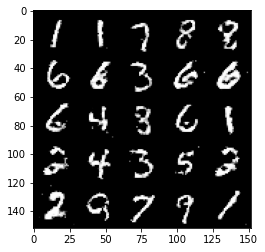

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


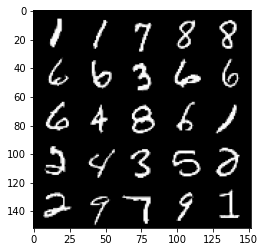

  1%|▏         | 6/469 [00:00<00:26, 17.17it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 226, step 106000 -> generator loss: 0.43900911498069745, discriminator loss: 0.7148061715364458


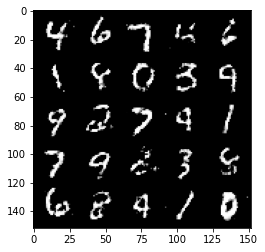

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


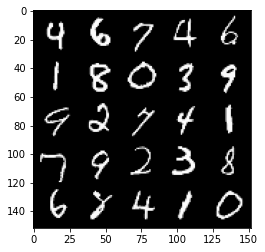

  8%|▊         | 36/469 [00:02<00:25, 16.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 227, step 106500 -> generator loss: 0.44648100632429105, discriminator loss: 0.7055795041322711


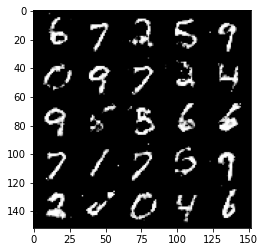

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


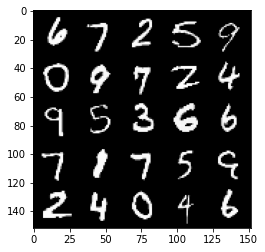

 14%|█▍        | 68/469 [00:04<00:23, 17.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 228, step 107000 -> generator loss: 0.44173194676637634, discriminator loss: 0.7127355083227157


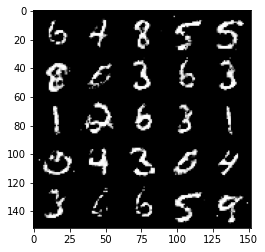

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


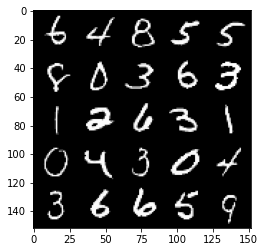

 21%|██        | 98/469 [00:05<00:22, 16.79it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 229, step 107500 -> generator loss: 0.44429393476247775, discriminator loss: 0.7077795916795734


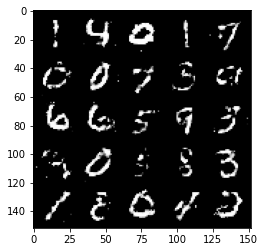

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


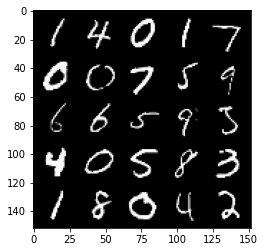

 28%|██▊       | 130/469 [00:08<00:19, 17.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 230, step 108000 -> generator loss: 0.43793425810337105, discriminator loss: 0.7141588363647461


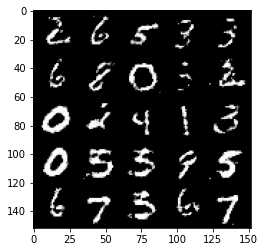

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


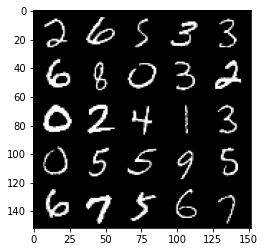

 34%|███▍      | 160/469 [00:09<00:17, 17.26it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 231, step 108500 -> generator loss: 0.43947102916240693, discriminator loss: 0.7133520917892465


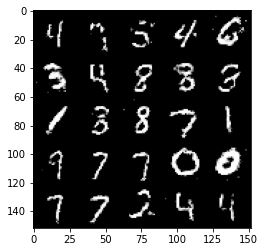

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


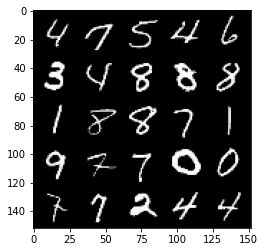

 41%|████      | 192/469 [00:11<00:16, 17.17it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 232, step 109000 -> generator loss: 0.44343828350305564, discriminator loss: 0.7085417572259893


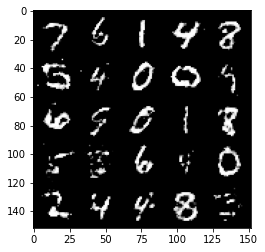

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


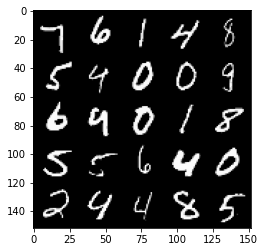

 47%|████▋     | 222/469 [00:12<00:13, 18.88it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 233, step 109500 -> generator loss: 0.44229661315679525, discriminator loss: 0.7072700093984605


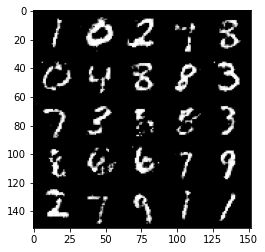

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


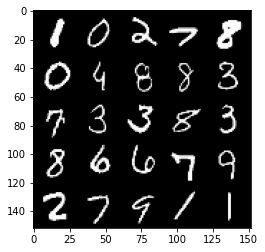

 54%|█████▍    | 254/469 [00:13<00:11, 18.42it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 234, step 110000 -> generator loss: 0.4433109631538391, discriminator loss: 0.7105485385656352


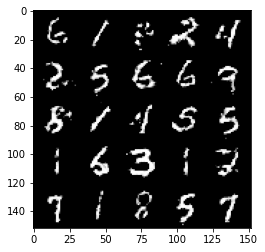

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


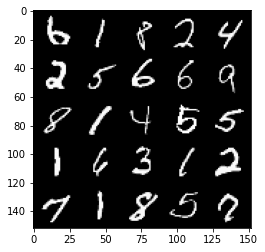

 61%|██████    | 284/469 [00:18<00:10, 17.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 235, step 110500 -> generator loss: 0.4466019384264943, discriminator loss: 0.7043045753240584


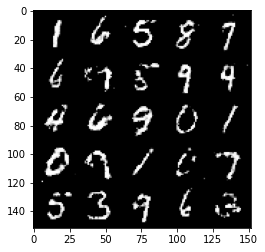

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


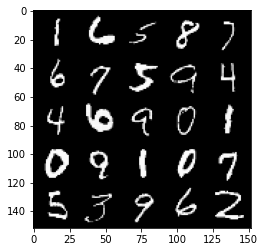

 67%|██████▋   | 316/469 [00:20<00:10, 15.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 236, step 111000 -> generator loss: 0.44353582334518415, discriminator loss: 0.709484195113182


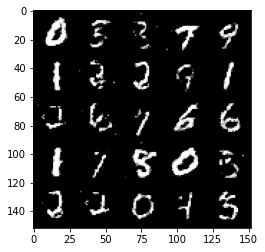

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


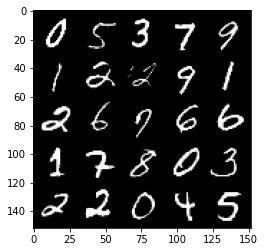

 74%|███████▍  | 346/469 [00:21<00:06, 18.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 237, step 111500 -> generator loss: 0.4397562619447706, discriminator loss: 0.713271417021751


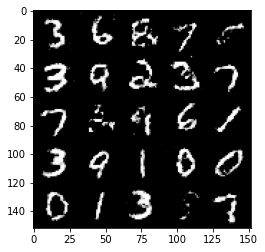

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


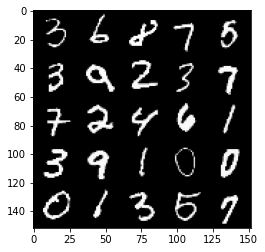

 81%|████████  | 378/469 [00:20<00:04, 18.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 238, step 112000 -> generator loss: 0.44385363304615033, discriminator loss: 0.7073312203884132


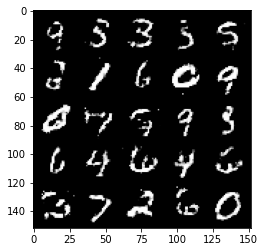

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


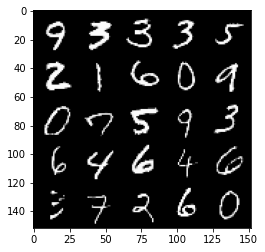

 87%|████████▋ | 408/469 [00:22<00:03, 18.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 239, step 112500 -> generator loss: 0.44140742760896706, discriminator loss: 0.7123849066495898


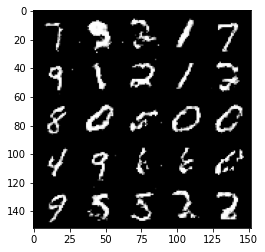

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


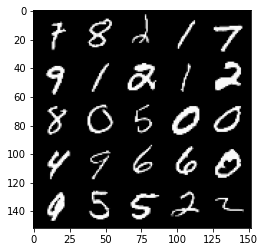

 94%|█████████▍| 440/469 [00:24<00:01, 17.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 240, step 113000 -> generator loss: 0.4391505549550054, discriminator loss: 0.714248234152794


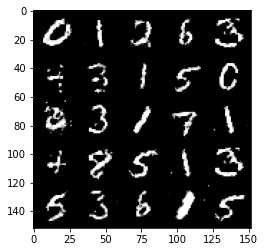

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


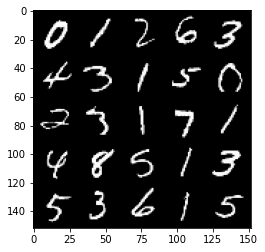

  0%|          | 2/469 [00:00<00:29, 15.72it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 242, step 113500 -> generator loss: 0.44428998827934263, discriminator loss: 0.7070449414253229


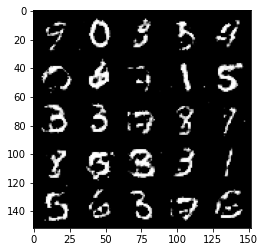

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


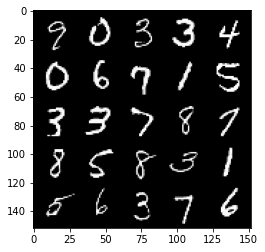

  7%|▋         | 32/469 [00:01<00:23, 18.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 243, step 114000 -> generator loss: 0.438856396317482, discriminator loss: 0.7146164355278017


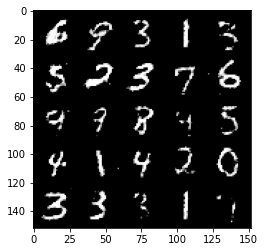

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


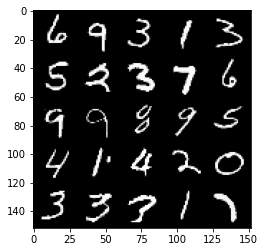

 14%|█▎        | 64/469 [00:03<00:22, 18.35it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 244, step 114500 -> generator loss: 0.435121128678322, discriminator loss: 0.7191168876886364


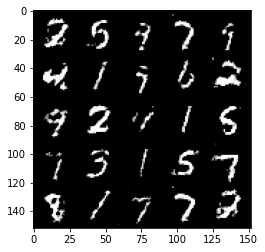

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


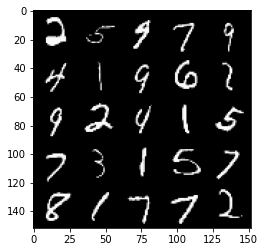

 20%|██        | 94/469 [00:05<00:20, 18.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 245, step 115000 -> generator loss: 0.4391510927081108, discriminator loss: 0.7151999437808985


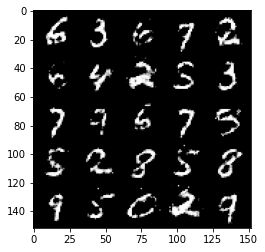

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


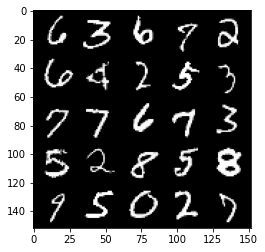

 27%|██▋       | 126/469 [00:06<00:18, 18.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 246, step 115500 -> generator loss: 0.44092911839485155, discriminator loss: 0.7117718549966803


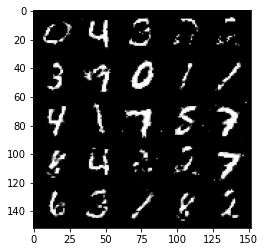

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


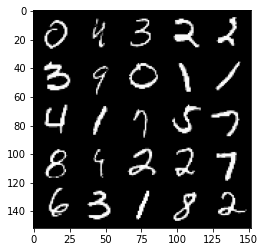

 33%|███▎      | 156/469 [00:08<00:16, 18.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 247, step 116000 -> generator loss: 0.44216727960109703, discriminator loss: 0.7108881698846823


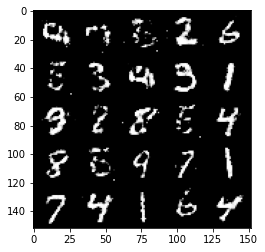

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


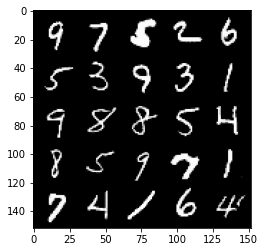

 40%|████      | 188/469 [00:10<00:15, 18.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 248, step 116500 -> generator loss: 0.44184855616092694, discriminator loss: 0.7095747344493856


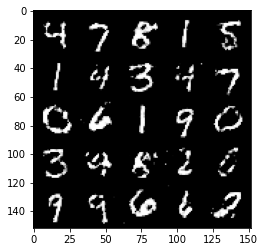

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


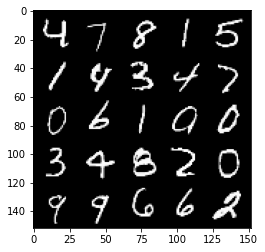

 46%|████▋     | 218/469 [00:11<00:13, 18.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 249, step 117000 -> generator loss: 0.4416757098436356, discriminator loss: 0.7130606682300559


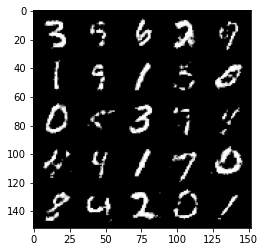

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


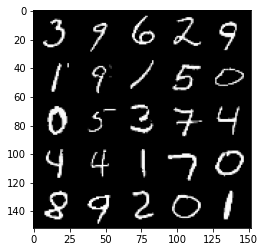

 53%|█████▎    | 250/469 [00:13<00:12, 17.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 250, step 117500 -> generator loss: 0.4352068362832068, discriminator loss: 0.719026461839676


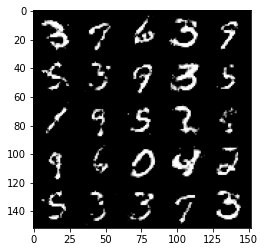

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


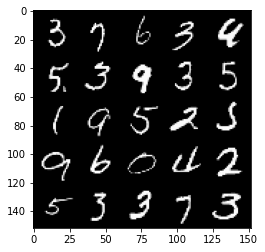

 60%|█████▉    | 280/469 [00:15<00:10, 17.74it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 251, step 118000 -> generator loss: 0.43958561551570924, discriminator loss: 0.7148621575832368


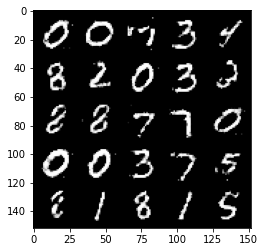

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


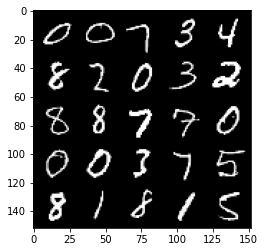

 67%|██████▋   | 312/469 [00:17<00:08, 18.53it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 252, step 118500 -> generator loss: 0.44285174864530585, discriminator loss: 0.7103598132133485


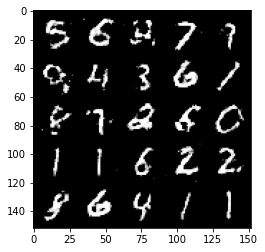

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


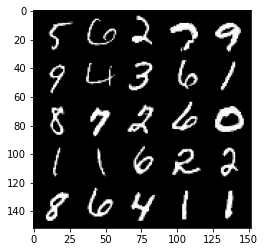

 73%|███████▎  | 342/469 [00:18<00:06, 18.71it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 253, step 119000 -> generator loss: 0.4354828903675081, discriminator loss: 0.7166352056264882


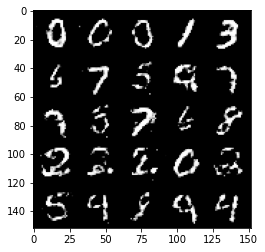

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


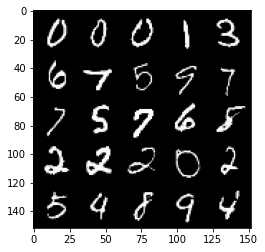

 80%|███████▉  | 374/469 [00:20<00:05, 18.35it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 254, step 119500 -> generator loss: 0.4430656442642208, discriminator loss: 0.7100788718461984


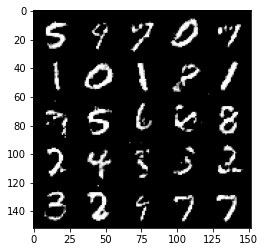

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


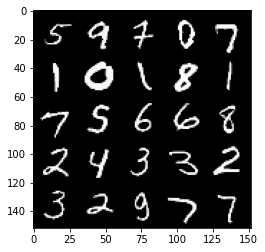

 86%|████████▌ | 404/469 [00:23<00:03, 18.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 255, step 120000 -> generator loss: 0.43876803511381196, discriminator loss: 0.715499782085419


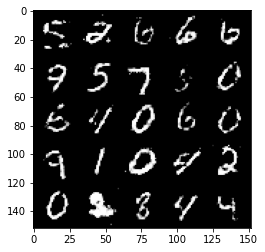

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


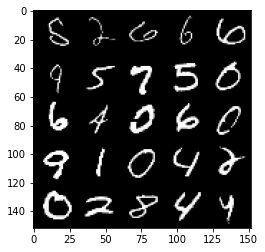

 93%|█████████▎| 435/469 [00:30<00:02, 16.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 256, step 120500 -> generator loss: 0.43770850980281867, discriminator loss: 0.7163609358072277


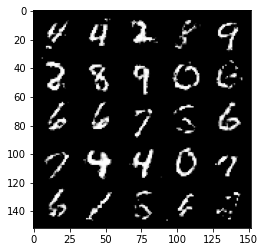

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


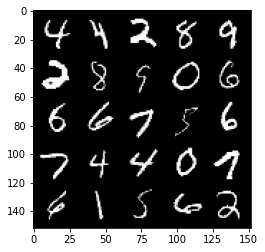

 99%|█████████▉| 466/469 [00:29<00:00, 17.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 257, step 121000 -> generator loss: 0.4382971754670148, discriminator loss: 0.7142963411808014


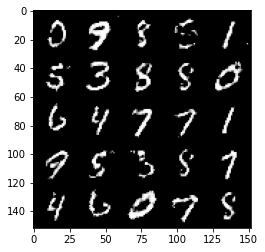

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


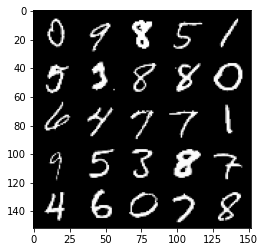

  6%|▌         | 28/469 [00:01<00:25, 16.97it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 259, step 121500 -> generator loss: 0.43776755982637455, discriminator loss: 0.716841500282288


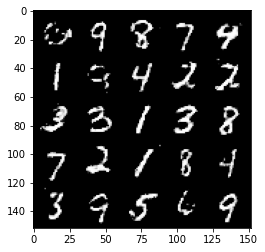

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


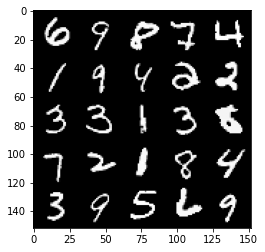

 13%|█▎        | 60/469 [00:03<00:23, 17.31it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 260, step 122000 -> generator loss: 0.4395407219529151, discriminator loss: 0.7140341268777852


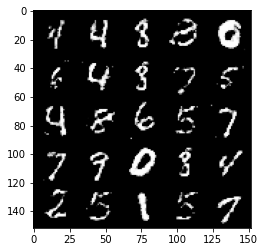

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


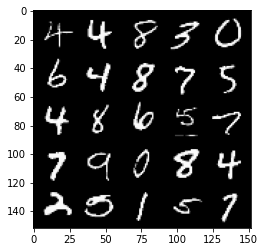

 19%|█▉        | 90/469 [00:05<00:22, 17.06it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 261, step 122500 -> generator loss: 0.445730930566788, discriminator loss: 0.7049938727617255


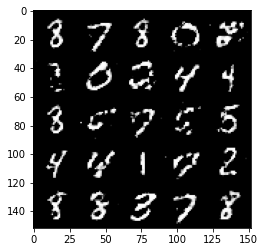

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


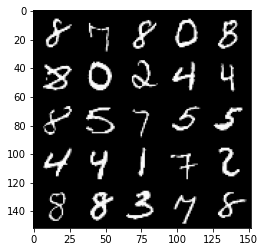

 26%|██▌       | 122/469 [00:07<00:20, 17.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 262, step 123000 -> generator loss: 0.44013710111379634, discriminator loss: 0.7125703498125073


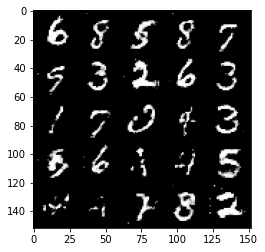

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


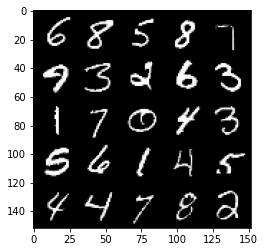

 32%|███▏      | 152/469 [00:09<00:19, 16.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 263, step 123500 -> generator loss: 0.43993704712390885, discriminator loss: 0.7158863563537592


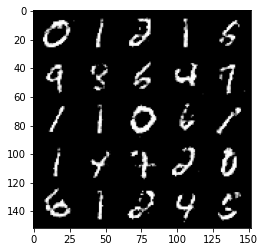

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


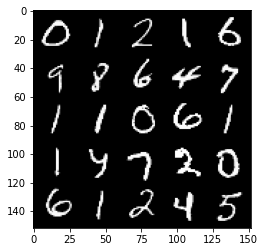

 39%|███▉      | 184/469 [00:10<00:16, 17.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 264, step 124000 -> generator loss: 0.4381093741655349, discriminator loss: 0.7147730977535248


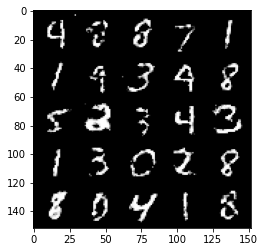

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


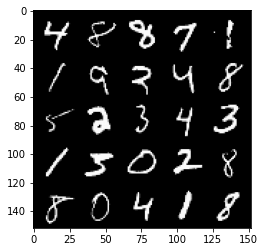

 46%|████▌     | 214/469 [00:12<00:15, 16.33it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 265, step 124500 -> generator loss: 0.44131204897165277, discriminator loss: 0.7126383832693101


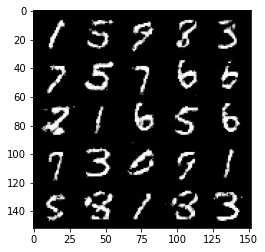

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


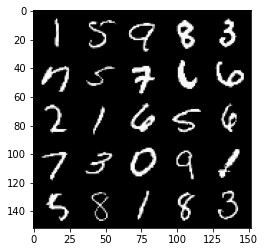

 52%|█████▏    | 246/469 [00:14<00:13, 17.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 266, step 125000 -> generator loss: 0.4344381242990497, discriminator loss: 0.7215567284822465


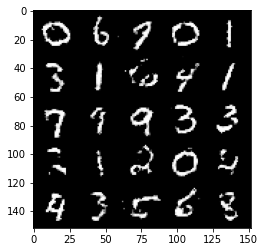

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


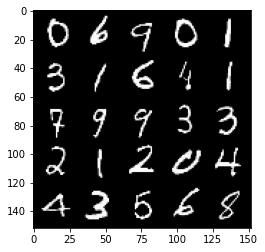

 59%|█████▉    | 277/469 [00:28<00:18, 10.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 267, step 125500 -> generator loss: 0.4355829514861111, discriminator loss: 0.7189590862989426


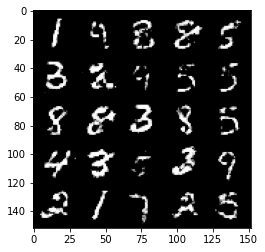

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


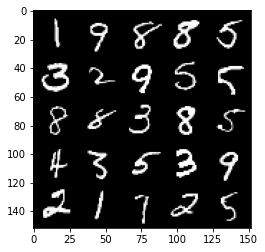

 65%|██████▌   | 307/469 [00:22<00:09, 16.65it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 268, step 126000 -> generator loss: 0.4394104913473131, discriminator loss: 0.7149260852336882


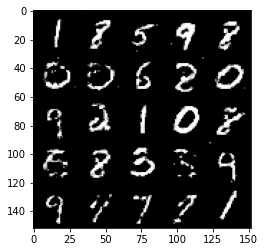

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


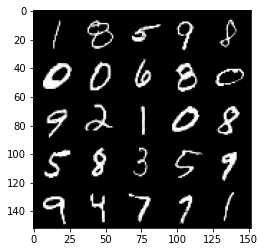

 72%|███████▏  | 338/469 [00:21<00:08, 15.32it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 269, step 126500 -> generator loss: 0.4385435497760774, discriminator loss: 0.7136343138217925


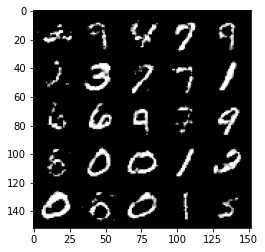

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


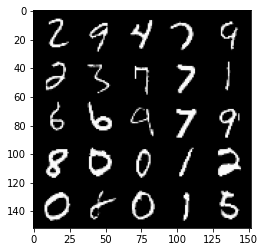

 79%|███████▉  | 370/469 [00:31<00:06, 14.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 270, step 127000 -> generator loss: 0.4392344046235086, discriminator loss: 0.7146663612127307


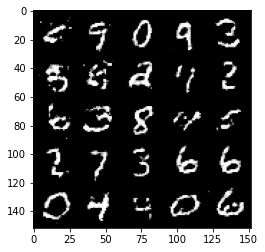

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


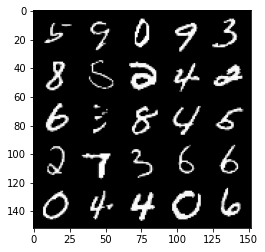

 85%|████████▌ | 400/469 [00:36<00:04, 14.10it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 271, step 127500 -> generator loss: 0.433466581046581, discriminator loss: 0.71995127594471


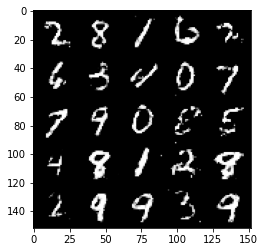

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


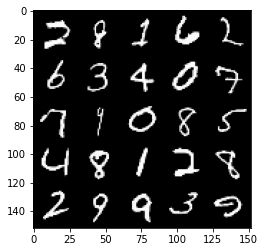

 92%|█████████▏| 432/469 [00:40<00:02, 14.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 272, step 128000 -> generator loss: 0.4359974619150159, discriminator loss: 0.7192863183021546


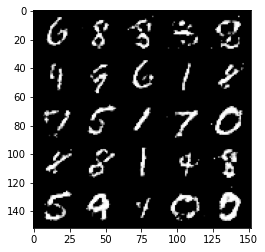

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


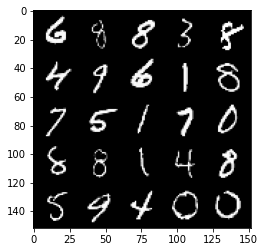

 99%|█████████▊| 462/469 [00:37<00:00, 12.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 273, step 128500 -> generator loss: 0.440050033867359, discriminator loss: 0.7128634415864938


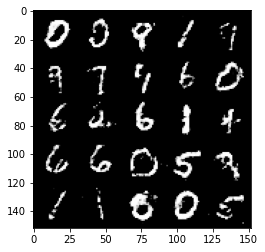

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


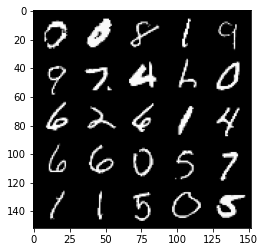

  5%|▌         | 24/469 [00:02<00:37, 11.76it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 275, step 129000 -> generator loss: 0.44032831698656105, discriminator loss: 0.711564806461334


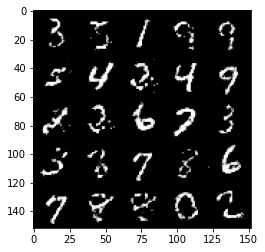

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


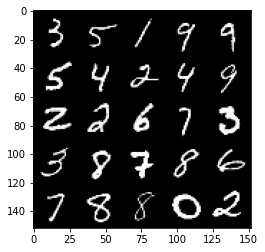

 12%|█▏        | 55/469 [00:05<00:48,  8.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 276, step 129500 -> generator loss: 0.43694213294982903, discriminator loss: 0.715862594723701


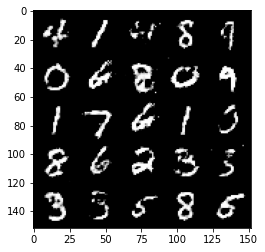

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


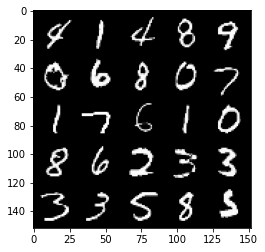

 18%|█▊        | 86/469 [00:10<00:38,  9.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 277, step 130000 -> generator loss: 0.43851263648271577, discriminator loss: 0.714920068979263


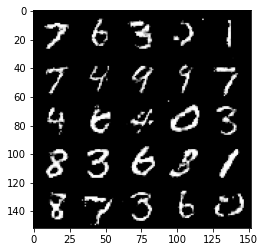

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


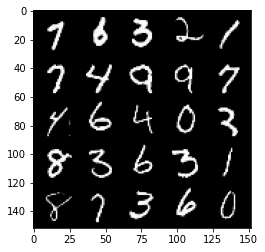

 25%|██▌       | 118/469 [00:12<00:34, 10.26it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 278, step 130500 -> generator loss: 0.43450712573528294, discriminator loss: 0.7198816192150116


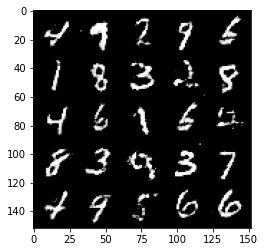

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


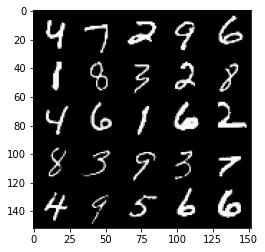

 32%|███▏      | 148/469 [00:11<00:24, 13.17it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 279, step 131000 -> generator loss: 0.43844967842102023, discriminator loss: 0.7167005413770676


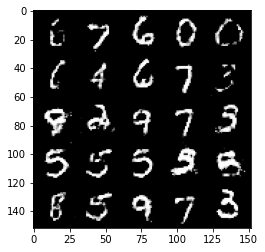

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


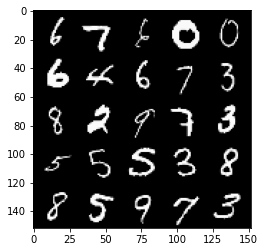

 38%|███▊      | 180/469 [00:12<00:18, 15.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 280, step 131500 -> generator loss: 0.43777006757259374, discriminator loss: 0.7165009438991549


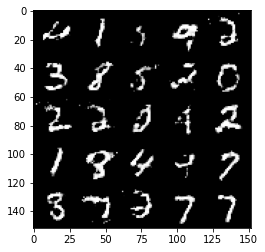

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


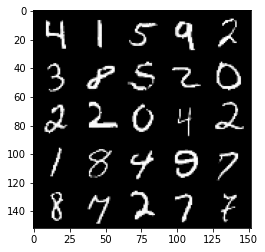

 45%|████▍     | 210/469 [00:13<00:15, 16.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 281, step 132000 -> generator loss: 0.4381883822679517, discriminator loss: 0.7143468430042269


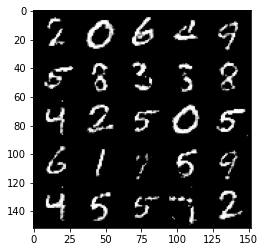

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


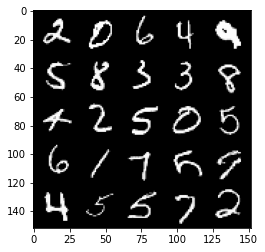

 52%|█████▏    | 242/469 [00:12<00:11, 19.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 282, step 132500 -> generator loss: 0.4348658240437512, discriminator loss: 0.7193843908309939


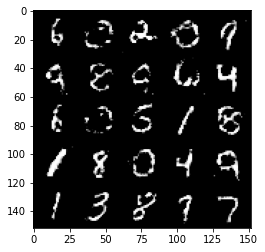

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


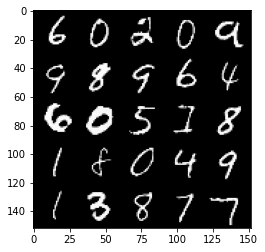

 58%|█████▊    | 273/469 [00:13<00:09, 19.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 283, step 133000 -> generator loss: 0.43789662069082286, discriminator loss: 0.7142333505153653


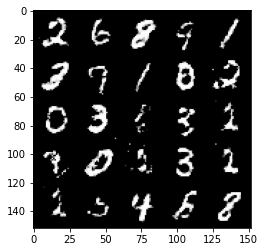

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


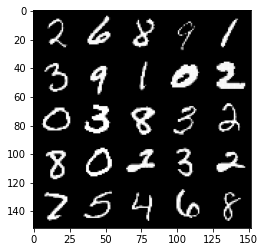

 65%|██████▍   | 303/469 [00:15<00:08, 19.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 284, step 133500 -> generator loss: 0.4434083585739137, discriminator loss: 0.7078855772018428


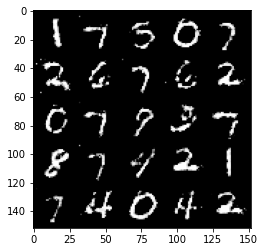

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


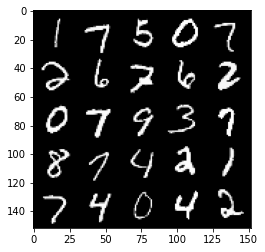

 71%|███████▏  | 335/469 [00:17<00:06, 19.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 285, step 134000 -> generator loss: 0.43924795883893963, discriminator loss: 0.7143034696578978


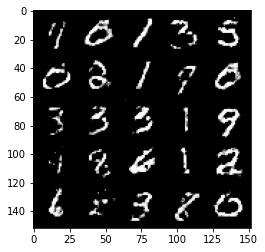

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


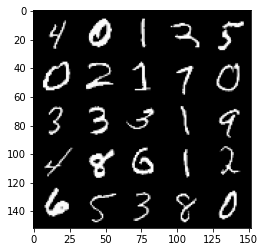

 78%|███████▊  | 365/469 [00:18<00:05, 18.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 286, step 134500 -> generator loss: 0.4391462667584418, discriminator loss: 0.7137498925924304


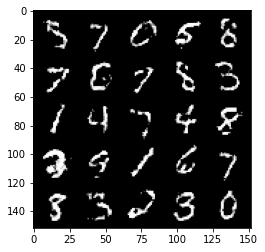

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


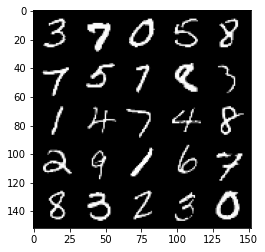

 85%|████████▍ | 397/469 [00:20<00:03, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 287, step 135000 -> generator loss: 0.43704559642076496, discriminator loss: 0.7169584414958957


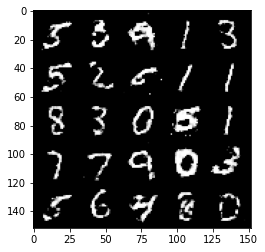

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


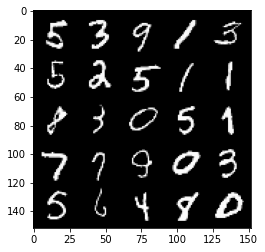

 91%|█████████▏| 428/469 [00:21<00:02, 19.42it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 288, step 135500 -> generator loss: 0.43826412671804454, discriminator loss: 0.7151830387115473


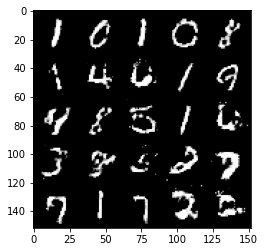

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


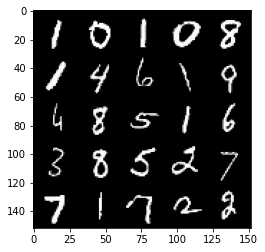

 98%|█████████▊| 458/469 [00:23<00:00, 19.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 289, step 136000 -> generator loss: 0.436000833272934, discriminator loss: 0.7193086001873016


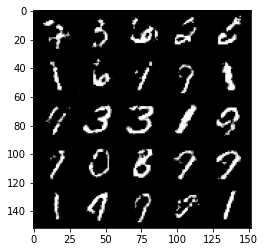

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


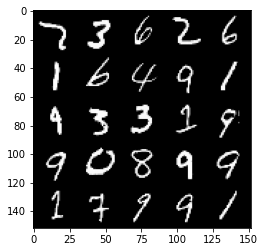

  4%|▍         | 21/469 [00:01<00:23, 18.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 291, step 136500 -> generator loss: 0.4331461836099625, discriminator loss: 0.721649104356766


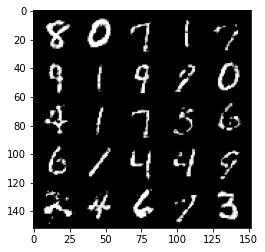

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


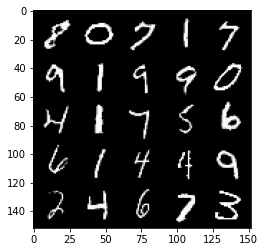

 11%|█         | 51/469 [00:02<00:21, 19.39it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 292, step 137000 -> generator loss: 0.43766480946540814, discriminator loss: 0.7166615276336665


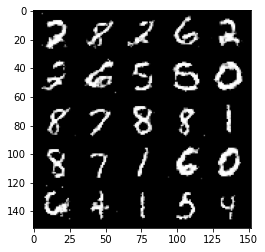

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


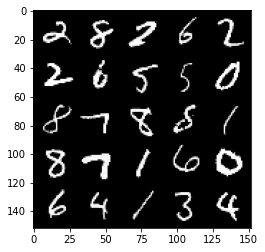

 18%|█▊        | 83/469 [00:04<00:19, 19.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 293, step 137500 -> generator loss: 0.43785576772689866, discriminator loss: 0.7160906727314


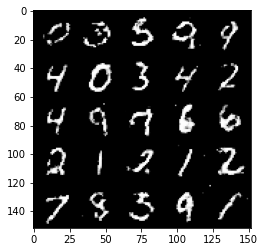

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


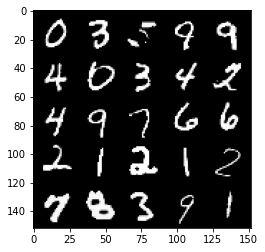

 24%|██▍       | 114/469 [00:05<00:18, 19.28it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 294, step 138000 -> generator loss: 0.4385249707698822, discriminator loss: 0.7154147467613217


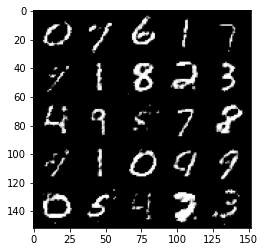

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


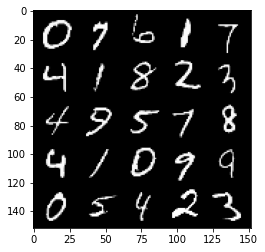

 31%|███       | 144/469 [00:07<00:18, 17.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 295, step 138500 -> generator loss: 0.43400447118282315, discriminator loss: 0.719433779478073


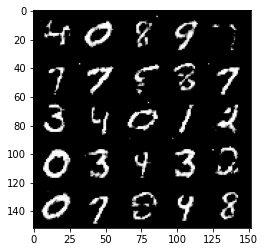

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


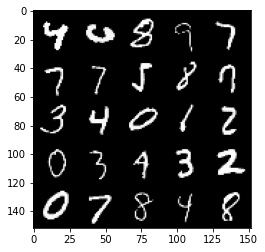

 38%|███▊      | 176/469 [00:08<00:15, 18.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 296, step 139000 -> generator loss: 0.4389338483810427, discriminator loss: 0.7153250846862786


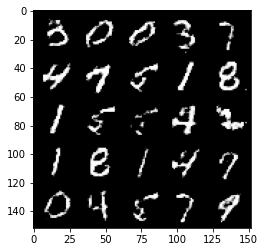

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


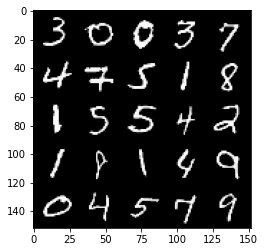

 44%|████▍     | 206/469 [00:10<00:13, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 297, step 139500 -> generator loss: 0.43829114592075313, discriminator loss: 0.7150981376171113


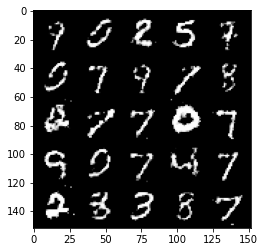

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


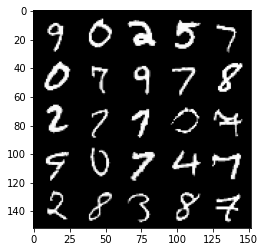

 51%|█████     | 238/469 [00:12<00:11, 19.70it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 298, step 140000 -> generator loss: 0.4381511811017998, discriminator loss: 0.7155390038490296


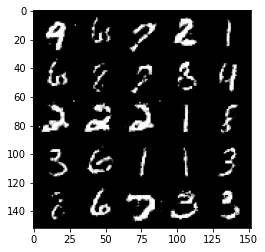

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


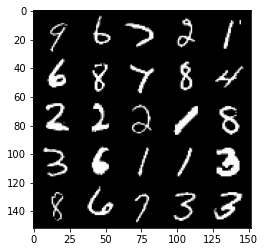

 57%|█████▋    | 268/469 [00:13<00:10, 19.91it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 299, step 140500 -> generator loss: 0.4373310480117798, discriminator loss: 0.7159841303825378


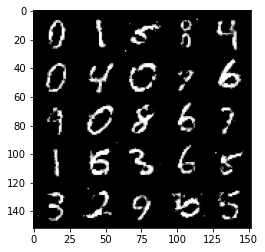

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


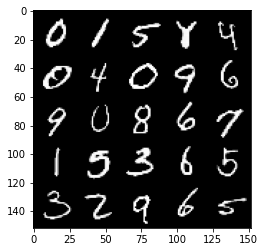

 64%|██████▍   | 300/469 [00:15<00:08, 19.90it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 300, step 141000 -> generator loss: 0.43765329384803753, discriminator loss: 0.7141018602848048


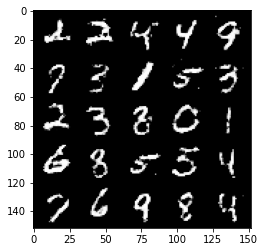

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


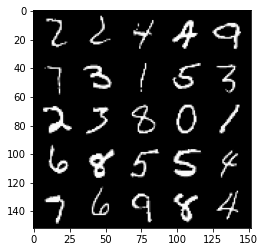

 70%|███████   | 329/469 [00:16<00:07, 19.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 301, step 141500 -> generator loss: 0.4386151441931723, discriminator loss: 0.7160335354804991


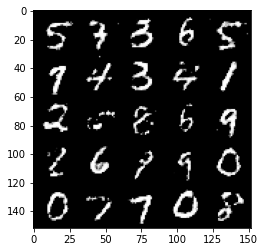

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


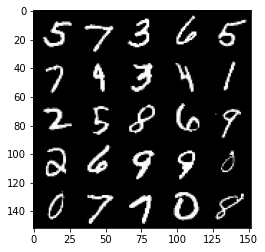

 77%|███████▋  | 361/469 [00:18<00:05, 20.01it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 302, step 142000 -> generator loss: 0.4372333527207373, discriminator loss: 0.71570481300354


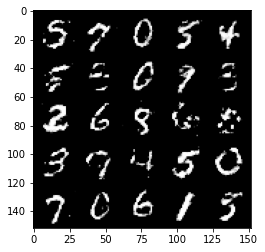

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


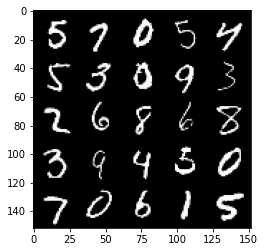

 84%|████████▍ | 393/469 [00:20<00:03, 19.53it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 303, step 142500 -> generator loss: 0.43705153036117533, discriminator loss: 0.7149436472654339


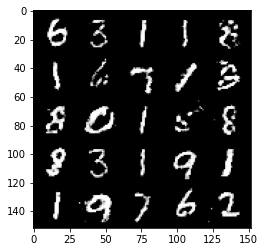

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


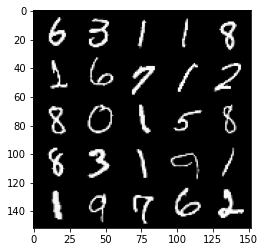

 90%|█████████ | 424/469 [00:21<00:02, 19.67it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 304, step 143000 -> generator loss: 0.43480630767345424, discriminator loss: 0.720688371777535


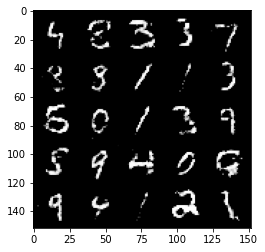

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


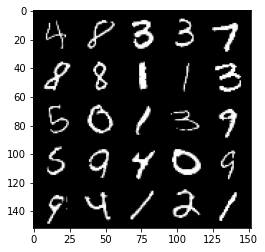

 97%|█████████▋| 453/469 [00:23<00:00, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 305, step 143500 -> generator loss: 0.4400505951642992, discriminator loss: 0.7125565708875657


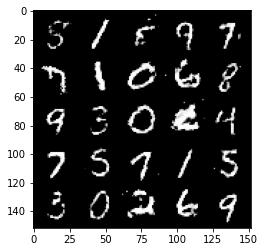

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


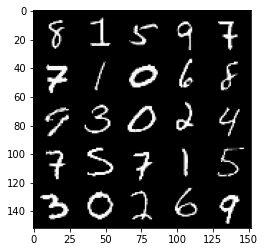

  3%|▎         | 16/469 [00:00<00:23, 19.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 307, step 144000 -> generator loss: 0.43763451552391014, discriminator loss: 0.7141270629167554


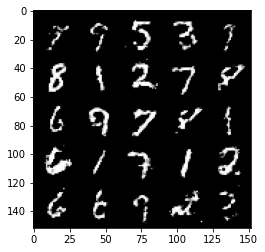

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


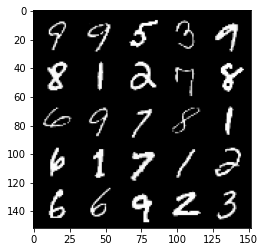

 10%|█         | 48/469 [00:02<00:21, 19.72it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 308, step 144500 -> generator loss: 0.4396989308595658, discriminator loss: 0.7143194708824162


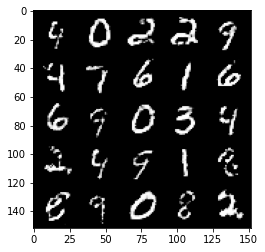

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


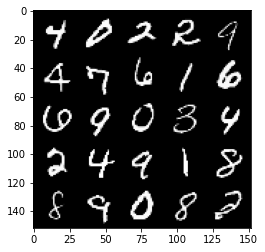

 17%|█▋        | 78/469 [00:03<00:21, 18.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 309, step 145000 -> generator loss: 0.43916896516084686, discriminator loss: 0.7139716880321508


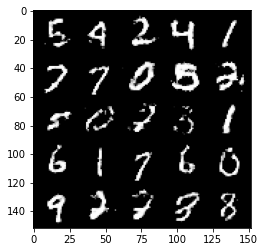

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


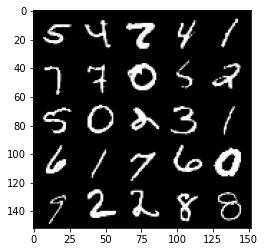

 23%|██▎       | 109/469 [00:05<00:18, 19.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 310, step 145500 -> generator loss: 0.441045487165451, discriminator loss: 0.7130346785783774


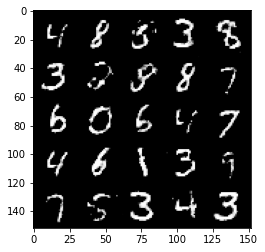

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


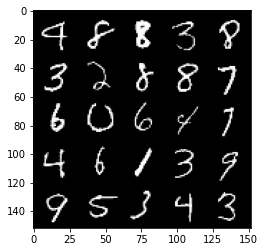

 30%|███       | 141/469 [00:07<00:16, 19.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 311, step 146000 -> generator loss: 0.4396531257033349, discriminator loss: 0.7126660810708998


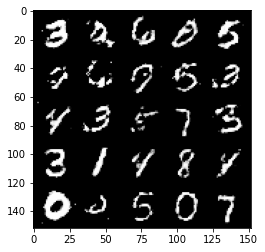

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


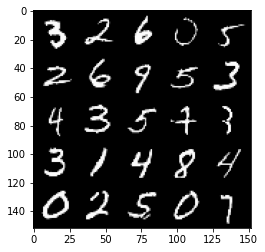

 36%|███▋      | 171/469 [00:08<00:15, 19.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 312, step 146500 -> generator loss: 0.43776555740833284, discriminator loss: 0.7161023483276372


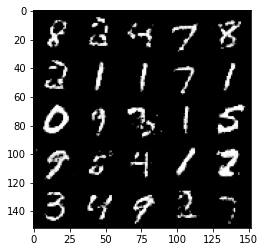

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


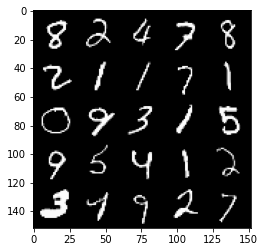

 43%|████▎     | 203/469 [00:10<00:13, 19.68it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 313, step 147000 -> generator loss: 0.43739410978555715, discriminator loss: 0.7151868911981577


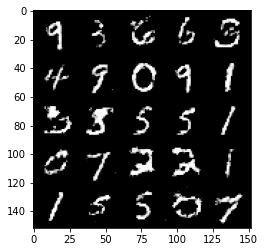

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


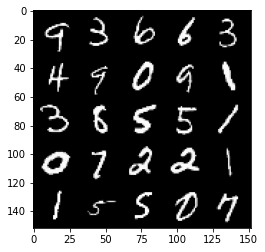

 50%|████▉     | 233/469 [00:11<00:11, 19.71it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 314, step 147500 -> generator loss: 0.4393121871352193, discriminator loss: 0.7139527850151058


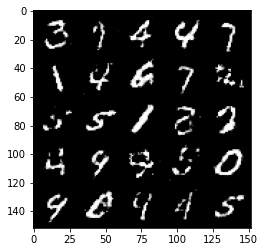

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


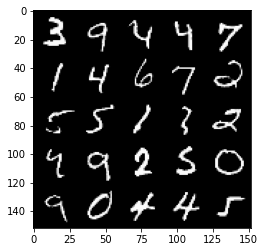

 57%|█████▋    | 265/469 [00:13<00:10, 19.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 315, step 148000 -> generator loss: 0.4382901060581204, discriminator loss: 0.7163244667053223


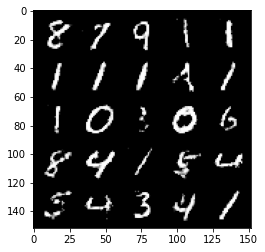

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


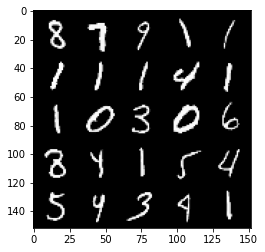

 63%|██████▎   | 295/469 [00:15<00:09, 19.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 316, step 148500 -> generator loss: 0.4357085750699045, discriminator loss: 0.717131225347519


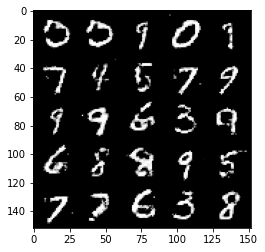

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


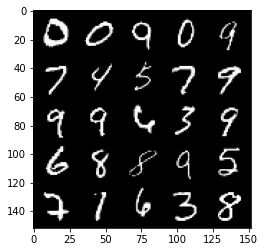

 70%|██████▉   | 327/469 [00:16<00:07, 19.55it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 317, step 149000 -> generator loss: 0.4332130627036093, discriminator loss: 0.7210887011289595


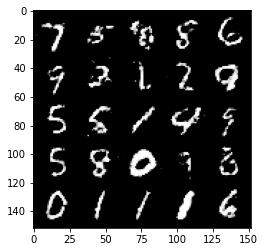

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


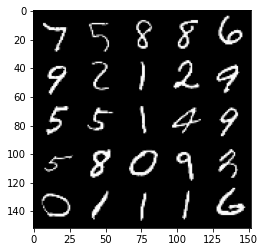

 76%|███████▌  | 357/469 [00:22<00:06, 17.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 318, step 149500 -> generator loss: 0.4356123283505444, discriminator loss: 0.7194028776884068


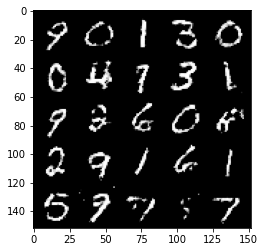

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


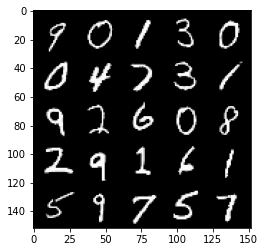

 83%|████████▎ | 388/469 [00:23<00:04, 16.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 319, step 150000 -> generator loss: 0.4403986716270446, discriminator loss: 0.7121251189708719


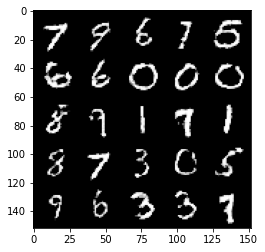

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


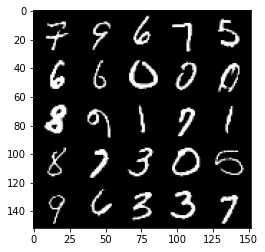

 90%|████████▉ | 420/469 [00:24<00:02, 17.82it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 320, step 150500 -> generator loss: 0.43700572419166556, discriminator loss: 0.7186375352144241


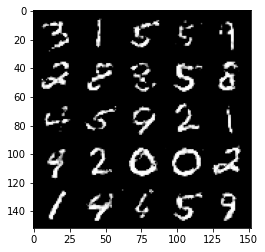

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


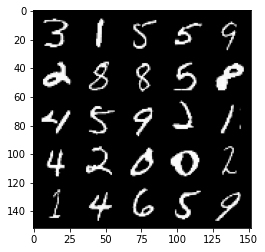

 96%|█████████▌| 450/469 [00:28<00:01, 17.20it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 321, step 151000 -> generator loss: 0.4358249104022981, discriminator loss: 0.7177749387025834


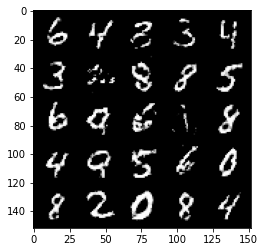

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


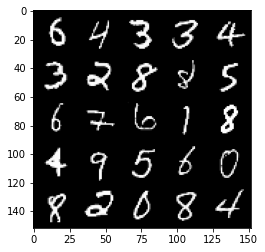

  3%|▎         | 12/469 [00:00<00:27, 16.77it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 323, step 151500 -> generator loss: 0.43785398536920556, discriminator loss: 0.7152185044288635


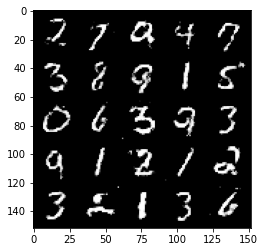

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


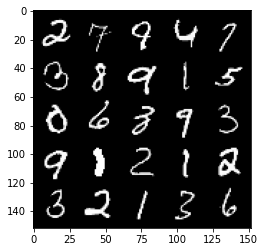

  9%|▉         | 43/469 [00:02<00:21, 19.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 324, step 152000 -> generator loss: 0.4358927102088932, discriminator loss: 0.7172263110876077


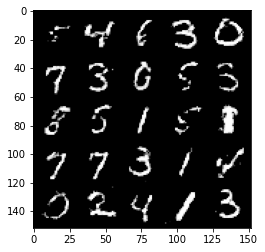

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


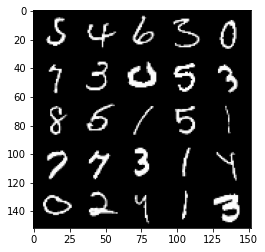

 16%|█▌        | 74/469 [00:04<00:22, 17.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 325, step 152500 -> generator loss: 0.43612275660038013, discriminator loss: 0.7184819957017896


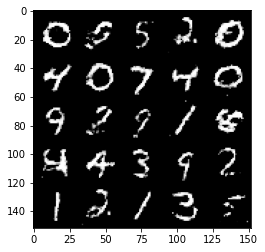

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


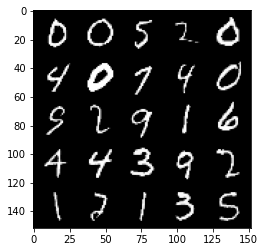

 23%|██▎       | 106/469 [00:07<00:20, 18.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 326, step 153000 -> generator loss: 0.43837443631887457, discriminator loss: 0.7188752012252806


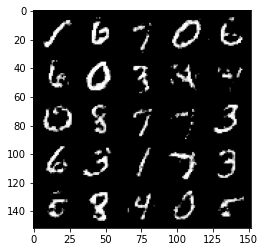

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


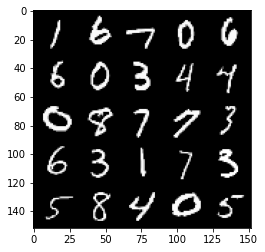

 29%|██▉       | 136/469 [00:07<00:17, 18.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 327, step 153500 -> generator loss: 0.4404149051904679, discriminator loss: 0.7123707833290096


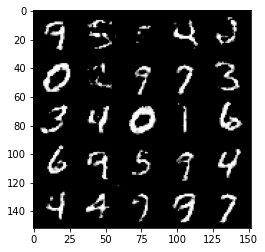

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


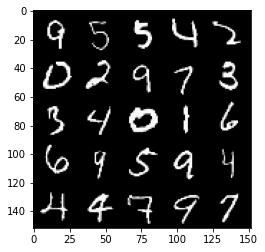

 36%|███▌      | 168/469 [00:09<00:16, 18.36it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 328, step 154000 -> generator loss: 0.44045086973905545, discriminator loss: 0.7134185307025914


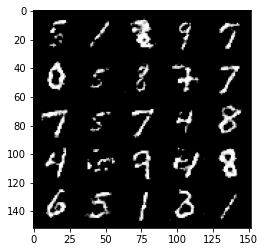

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


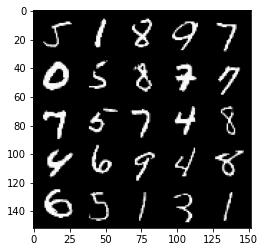

 42%|████▏     | 198/469 [00:10<00:14, 18.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 329, step 154500 -> generator loss: 0.433767566561699, discriminator loss: 0.7190297917127599


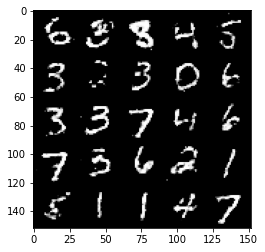

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


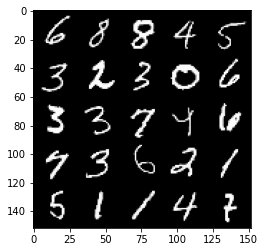

 49%|████▉     | 229/469 [00:13<00:13, 18.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 330, step 155000 -> generator loss: 0.44027781307697283, discriminator loss: 0.7115268744230266


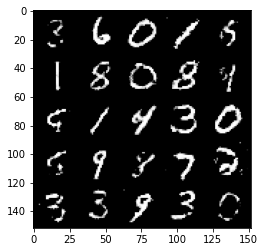

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


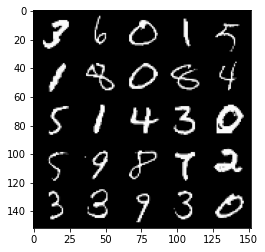

 55%|█████▌    | 260/469 [00:14<00:11, 18.41it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 331, step 155500 -> generator loss: 0.4367050929069522, discriminator loss: 0.7152786333560948


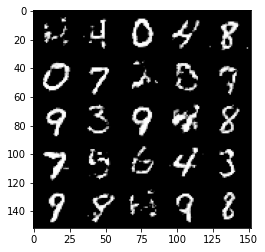

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


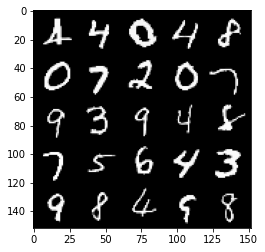

 62%|██████▏   | 292/469 [00:16<00:09, 18.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 332, step 156000 -> generator loss: 0.44156558752059927, discriminator loss: 0.7092760417461391


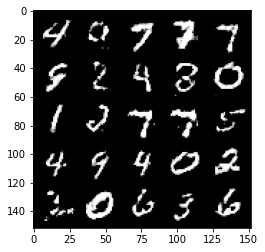

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


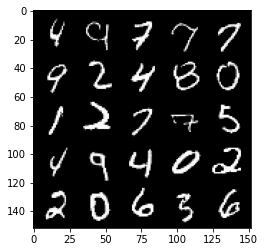

 69%|██████▊   | 322/469 [00:17<00:08, 16.92it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 333, step 156500 -> generator loss: 0.4371362770795825, discriminator loss: 0.7172517795562742


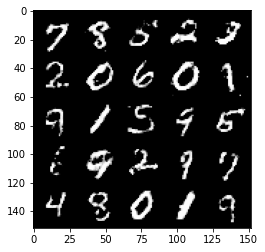

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


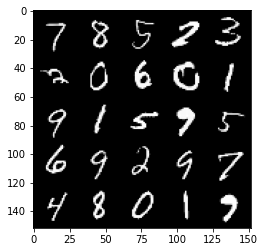

 75%|███████▌  | 354/469 [00:19<00:06, 18.68it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 334, step 157000 -> generator loss: 0.43813622075319214, discriminator loss: 0.7168799741268151


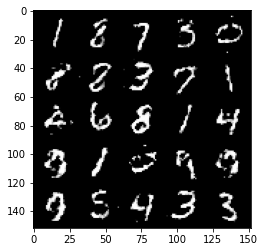

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


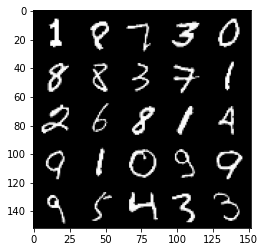

 82%|████████▏ | 384/469 [00:21<00:04, 18.78it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 335, step 157500 -> generator loss: 0.44133834302425323, discriminator loss: 0.710324072480202


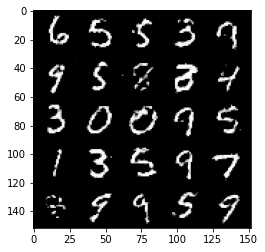

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


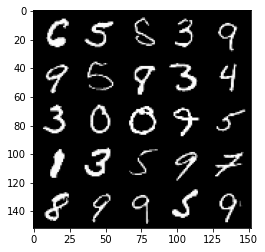

 89%|████████▊ | 416/469 [00:22<00:02, 18.58it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 336, step 158000 -> generator loss: 0.4376306447386741, discriminator loss: 0.7161467312574388


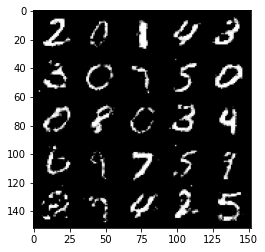

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


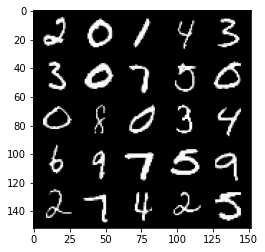

 95%|█████████▌| 446/469 [00:24<00:01, 17.13it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 337, step 158500 -> generator loss: 0.43854304730892196, discriminator loss: 0.7139347524642949


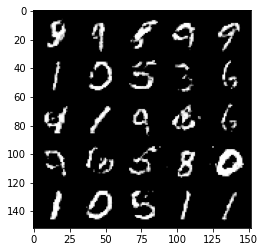

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


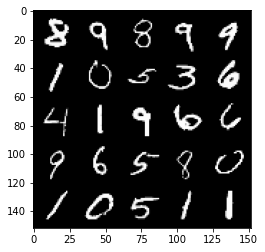

  2%|▏         | 8/469 [00:00<00:25, 17.95it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 339, step 159000 -> generator loss: 0.43833760154247264, discriminator loss: 0.7166621570587154


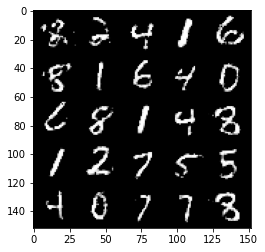

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


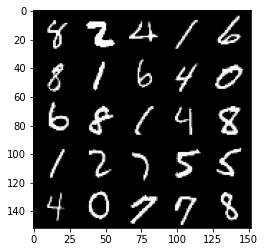

  9%|▊         | 40/469 [00:02<00:22, 18.75it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 340, step 159500 -> generator loss: 0.43612945747375514, discriminator loss: 0.7185084170103067


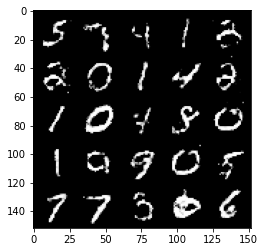

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


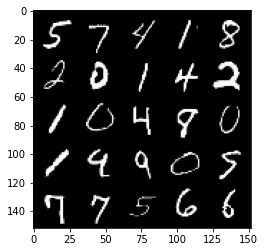

 15%|█▍        | 70/469 [00:03<00:21, 18.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 341, step 160000 -> generator loss: 0.4384676325917241, discriminator loss: 0.7151656469106665


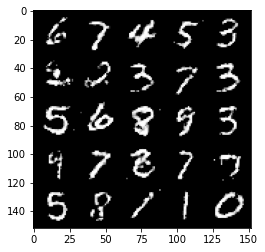

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


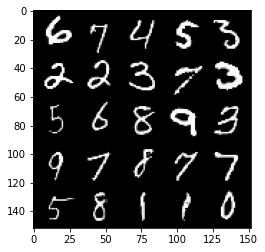

 22%|██▏       | 102/469 [00:05<00:21, 17.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 342, step 160500 -> generator loss: 0.4381511785387991, discriminator loss: 0.7125851958990099


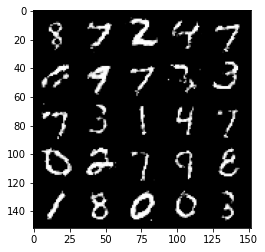

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


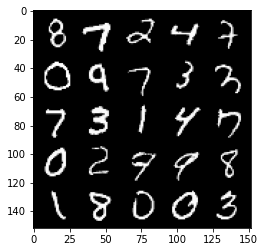

 28%|██▊       | 132/469 [00:07<00:18, 18.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 343, step 161000 -> generator loss: 0.43513064366579063, discriminator loss: 0.7184086380004889


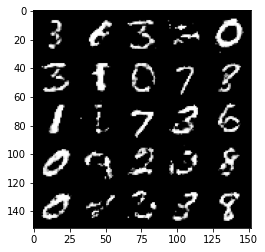

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


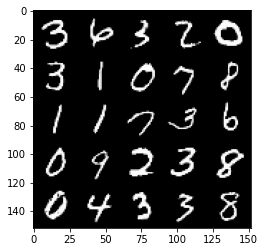

 35%|███▍      | 164/469 [00:08<00:16, 18.51it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 344, step 161500 -> generator loss: 0.43533269792795204, discriminator loss: 0.718686810135841


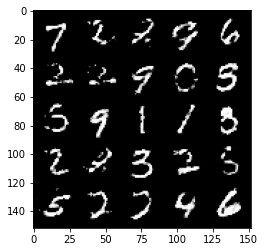

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


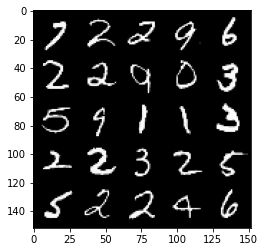

 41%|████▏     | 194/469 [00:10<00:15, 18.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 345, step 162000 -> generator loss: 0.44097643196582764, discriminator loss: 0.712838248252869


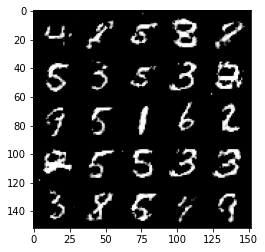

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


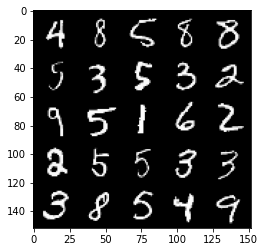

 48%|████▊     | 225/469 [00:14<00:13, 18.37it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 346, step 162500 -> generator loss: 0.4320827113389969, discriminator loss: 0.7234307352304461


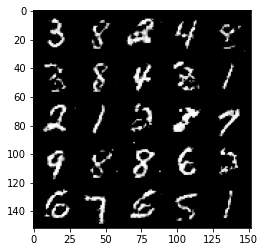

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


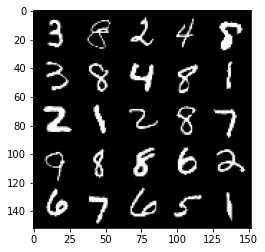

 55%|█████▍    | 256/469 [00:13<00:11, 18.38it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 347, step 163000 -> generator loss: 0.4397241659760475, discriminator loss: 0.7144537595510484


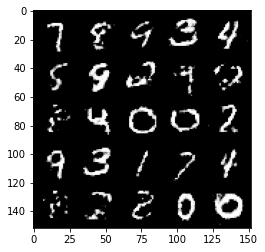

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


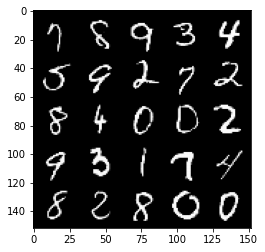

 61%|██████▏   | 288/469 [00:15<00:09, 18.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 348, step 163500 -> generator loss: 0.4361171804070473, discriminator loss: 0.7178823713064199


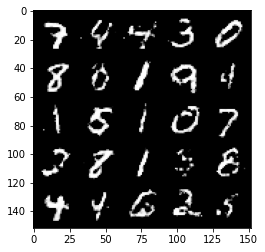

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


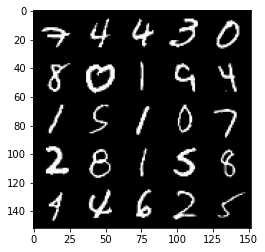

 68%|██████▊   | 318/469 [00:17<00:08, 17.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 349, step 164000 -> generator loss: 0.4345167149901389, discriminator loss: 0.7194033498764045


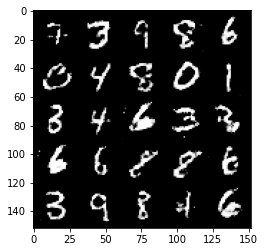

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


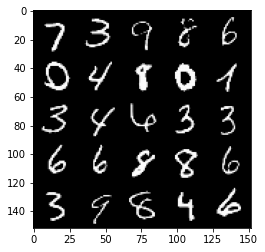

 75%|███████▍  | 350/469 [00:19<00:06, 18.39it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 350, step 164500 -> generator loss: 0.43536746674776083, discriminator loss: 0.7191208961009972


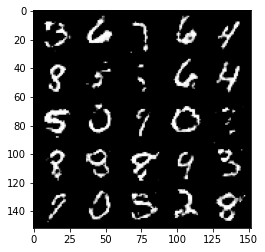

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


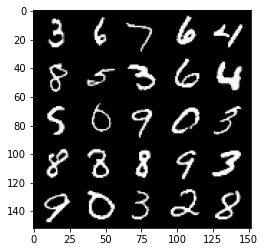

 81%|████████  | 380/469 [00:20<00:04, 18.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 351, step 165000 -> generator loss: 0.43548701173067106, discriminator loss: 0.7190651465654377


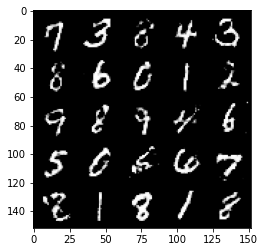

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


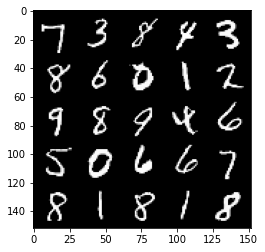

 88%|████████▊ | 412/469 [00:22<00:03, 17.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 352, step 165500 -> generator loss: 0.4343859508037562, discriminator loss: 0.7179263408184047


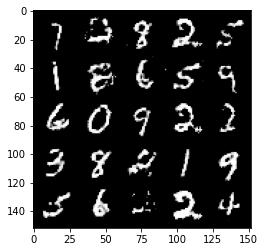

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


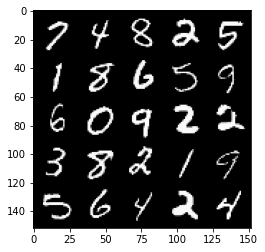

 94%|█████████▍| 442/469 [00:24<00:01, 18.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 353, step 166000 -> generator loss: 0.4395262131094936, discriminator loss: 0.7132196853160864


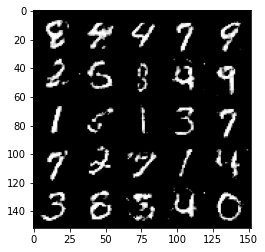

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


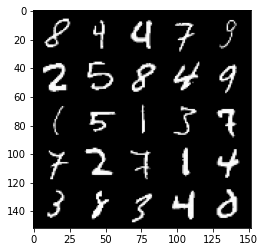

  1%|          | 4/469 [00:00<00:28, 16.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 355, step 166500 -> generator loss: 0.4372011701464653, discriminator loss: 0.7150468326807018


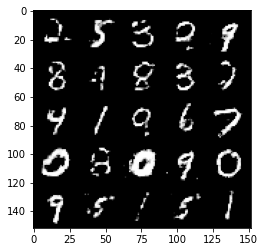

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


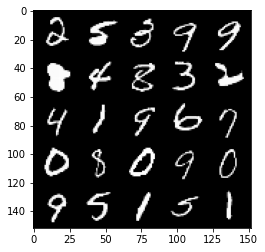

  8%|▊         | 36/469 [00:02<00:24, 18.03it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 356, step 167000 -> generator loss: 0.43718101626634615, discriminator loss: 0.7173104991912836


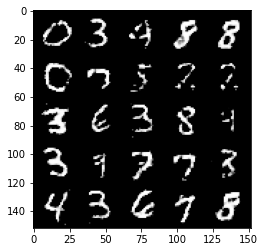

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


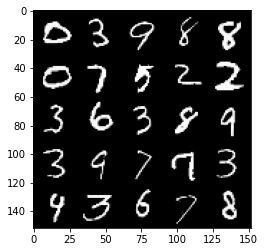

 14%|█▍        | 66/469 [00:03<00:21, 18.67it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 357, step 167500 -> generator loss: 0.435843631446361, discriminator loss: 0.7193241842985156


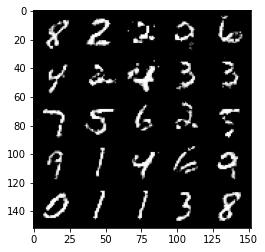

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


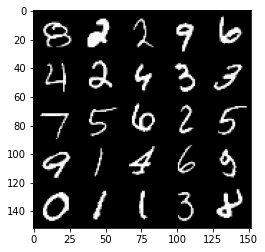

 21%|██        | 98/469 [00:05<00:20, 17.87it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 358, step 168000 -> generator loss: 0.4346292600631717, discriminator loss: 0.7201268712282184


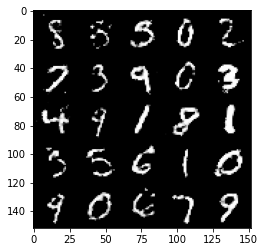

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


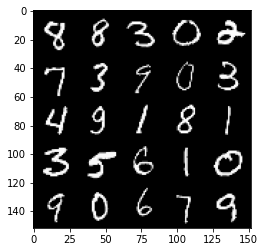

 27%|██▋       | 128/469 [00:07<00:18, 18.18it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 359, step 168500 -> generator loss: 0.4341737149953839, discriminator loss: 0.720995660424232


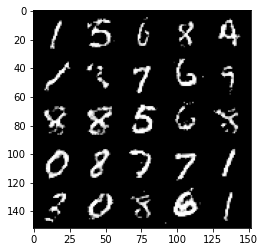

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


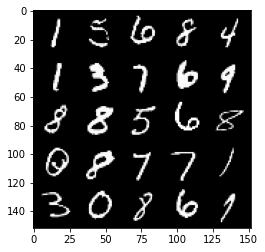

 34%|███▍      | 160/469 [00:08<00:16, 18.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 360, step 169000 -> generator loss: 0.4351918292045595, discriminator loss: 0.717608384132385


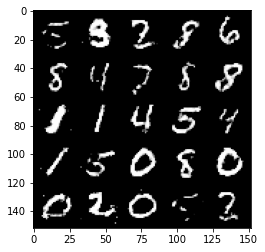

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


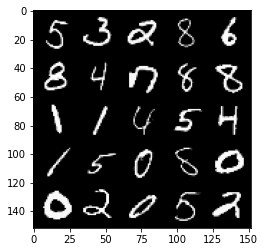

 41%|████      | 190/469 [00:10<00:15, 18.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 361, step 169500 -> generator loss: 0.43566872411966345, discriminator loss: 0.7150846254825594


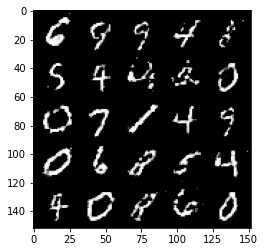

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


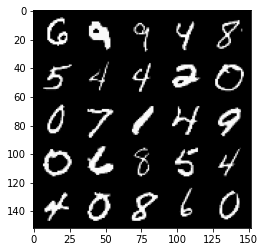

 47%|████▋     | 222/469 [00:12<00:13, 18.79it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 362, step 170000 -> generator loss: 0.4353640772104265, discriminator loss: 0.7172174375057221


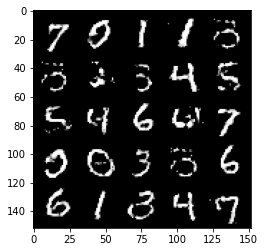

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


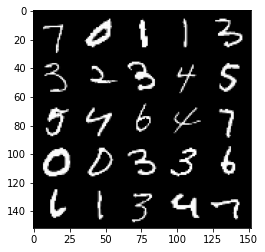

 54%|█████▎    | 252/469 [00:16<00:16, 13.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 363, step 170500 -> generator loss: 0.4383113791346548, discriminator loss: 0.7136538215875624


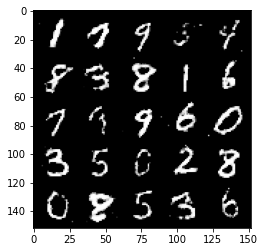

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


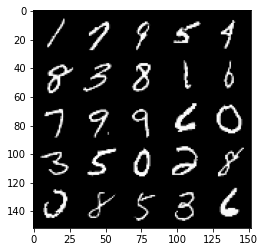

 61%|██████    | 284/469 [00:15<00:11, 15.94it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 364, step 171000 -> generator loss: 0.43891766220331196, discriminator loss: 0.7142187699079512


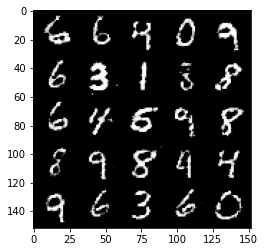

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


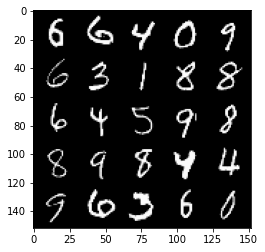

 67%|██████▋   | 314/469 [00:22<00:08, 18.48it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 365, step 171500 -> generator loss: 0.43706582534313215, discriminator loss: 0.7153906040191652


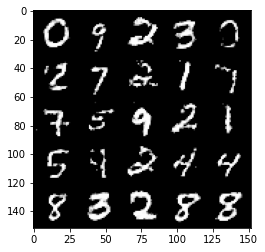

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


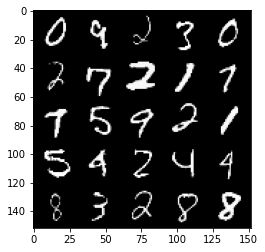

 74%|███████▍  | 346/469 [00:19<00:06, 18.33it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 366, step 172000 -> generator loss: 0.4356073588728906, discriminator loss: 0.7178667931556708


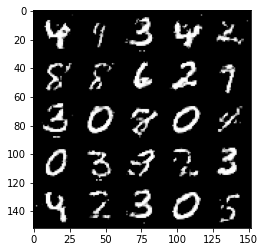

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


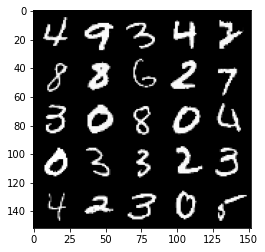

 80%|████████  | 376/469 [00:21<00:05, 17.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 367, step 172500 -> generator loss: 0.44432099390029933, discriminator loss: 0.7085223234891885


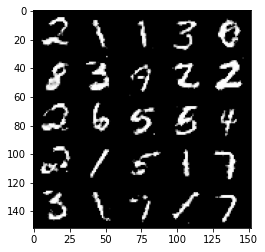

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


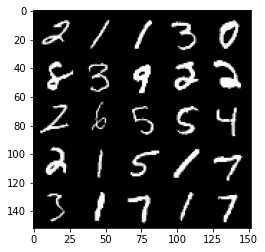

 87%|████████▋ | 408/469 [00:23<00:03, 17.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 368, step 173000 -> generator loss: 0.44107722181081743, discriminator loss: 0.7111270329952235


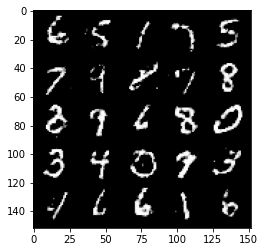

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


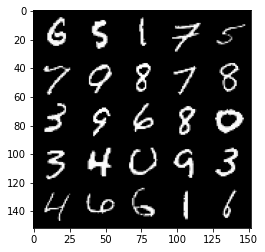

 93%|█████████▎| 438/469 [00:25<00:01, 17.76it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 369, step 173500 -> generator loss: 0.43919947719573976, discriminator loss: 0.7143524599075318


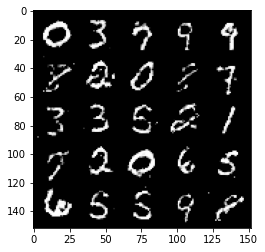

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


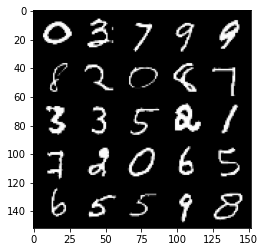

  0%|          | 0/469 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 371, step 174000 -> generator loss: 0.436652401328087, discriminator loss: 0.7149000045061107


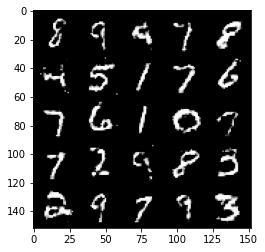

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


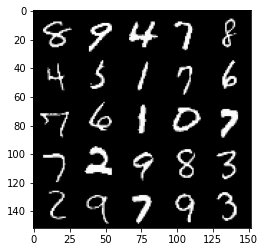

  7%|▋         | 32/469 [00:01<00:23, 18.25it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 372, step 174500 -> generator loss: 0.4399191943407055, discriminator loss: 0.7131883031129839


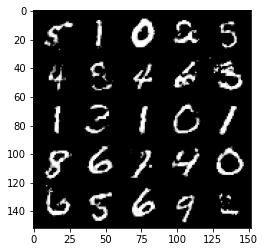

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


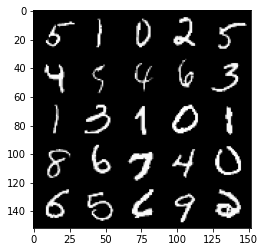

 13%|█▎        | 62/469 [00:03<00:23, 17.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 373, step 175000 -> generator loss: 0.4366114290952683, discriminator loss: 0.7186490833759315


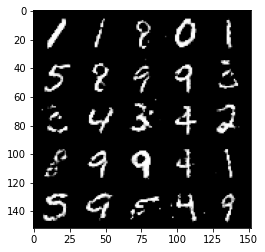

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


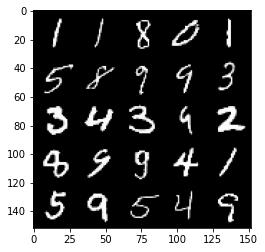

 20%|██        | 94/469 [00:05<00:19, 19.03it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 374, step 175500 -> generator loss: 0.43506534266471875, discriminator loss: 0.7184290816783905


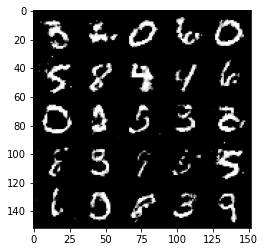

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


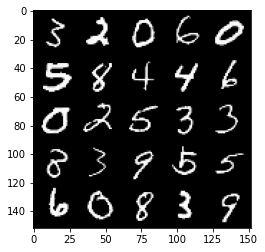

 26%|██▋       | 124/469 [00:06<00:18, 18.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 375, step 176000 -> generator loss: 0.43955568152666064, discriminator loss: 0.7137262927293785


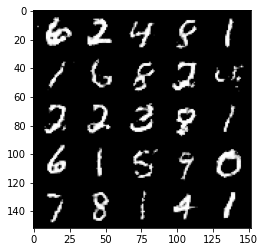

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


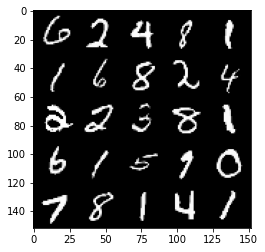

 33%|███▎      | 156/469 [00:08<00:16, 19.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 376, step 176500 -> generator loss: 0.43406520205736143, discriminator loss: 0.7201063228845591


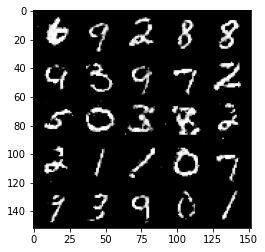

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


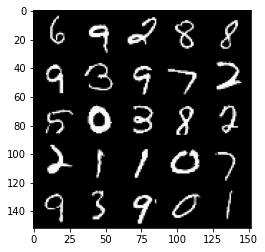

 40%|███▉      | 186/469 [00:09<00:14, 19.20it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 377, step 177000 -> generator loss: 0.43455956923961675, discriminator loss: 0.7193506385087964


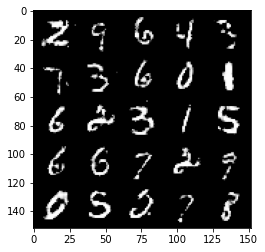

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


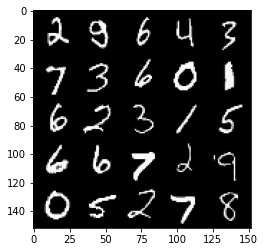

 46%|████▋     | 218/469 [00:11<00:12, 19.52it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 378, step 177500 -> generator loss: 0.435378330528736, discriminator loss: 0.7176257512569424


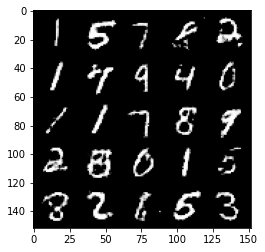

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


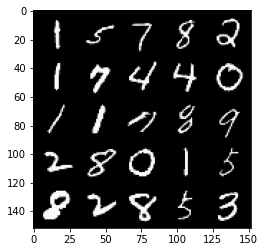

 53%|█████▎    | 249/469 [00:12<00:11, 19.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 379, step 178000 -> generator loss: 0.4370194410085678, discriminator loss: 0.7174361310005187


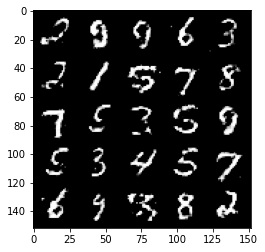

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


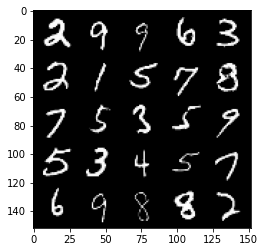

 59%|█████▉    | 279/469 [00:17<00:10, 17.72it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 380, step 178500 -> generator loss: 0.4352002166509624, discriminator loss: 0.7167446787357331


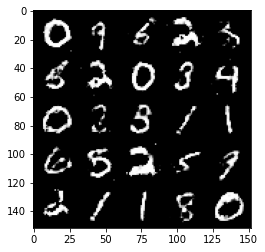

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


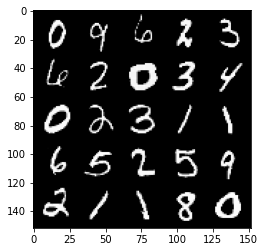

 66%|██████▌   | 310/469 [00:17<00:08, 17.75it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 381, step 179000 -> generator loss: 0.43615598189830806, discriminator loss: 0.718028030633926


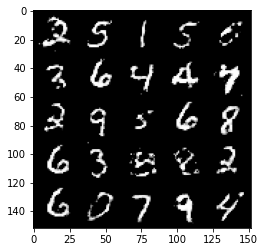

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


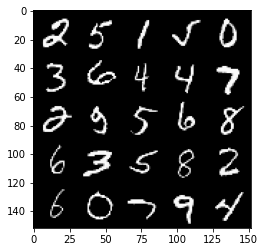

 73%|███████▎  | 342/469 [00:19<00:07, 17.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 382, step 179500 -> generator loss: 0.43722169518470766, discriminator loss: 0.7161012001037598


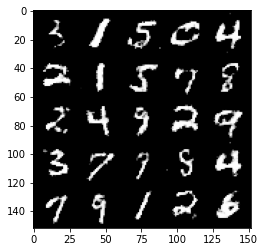

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


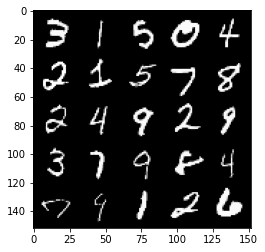

 79%|███████▉  | 372/469 [00:21<00:05, 17.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 383, step 180000 -> generator loss: 0.43711423349380485, discriminator loss: 0.7153505288362504


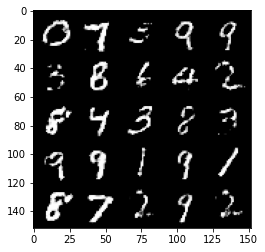

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


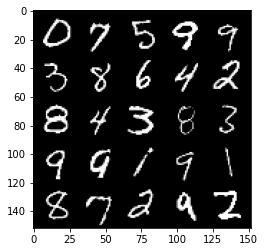

 86%|████████▌ | 404/469 [00:22<00:03, 17.44it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 384, step 180500 -> generator loss: 0.4398297432661062, discriminator loss: 0.7149226509332656


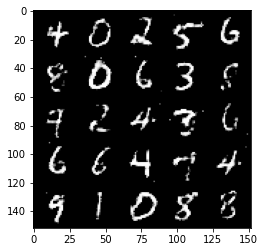

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


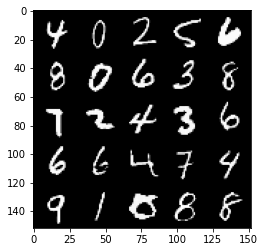

 93%|█████████▎| 434/469 [00:24<00:01, 17.80it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 385, step 181000 -> generator loss: 0.43677549767494184, discriminator loss: 0.716775495290756


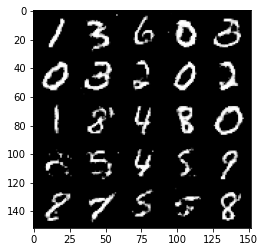

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


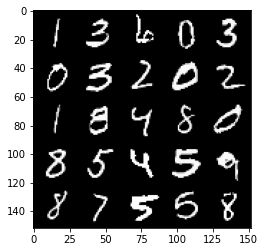

 99%|█████████▉| 466/469 [00:27<00:00, 17.29it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 386, step 181500 -> generator loss: 0.4375850840806962, discriminator loss: 0.7156129465103146


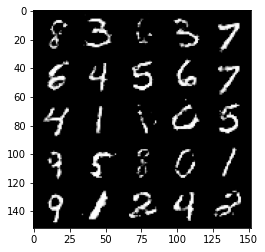

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


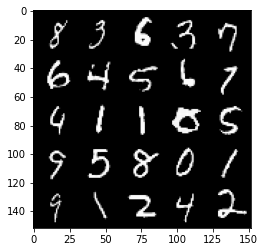

  6%|▌         | 28/469 [00:01<00:25, 17.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 388, step 182000 -> generator loss: 0.4368870860934258, discriminator loss: 0.7172988854646681


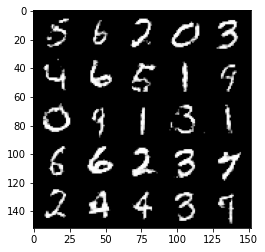

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


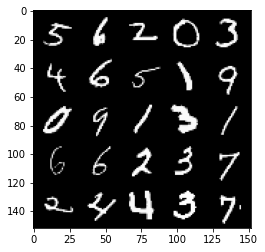

 12%|█▏        | 58/469 [00:03<00:23, 17.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 389, step 182500 -> generator loss: 0.4363203757405283, discriminator loss: 0.7168125053644174


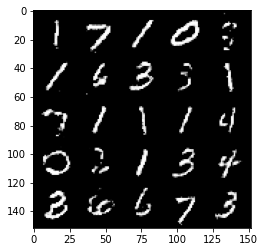

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


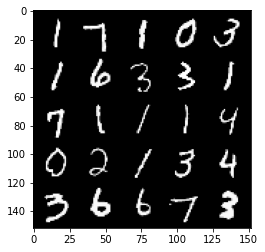

 19%|█▉        | 90/469 [00:05<00:22, 16.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 390, step 183000 -> generator loss: 0.434297150671482, discriminator loss: 0.7191271444559099


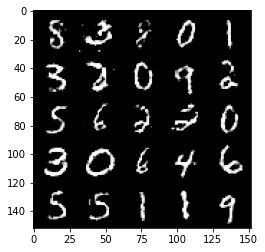

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


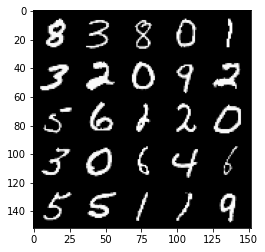

 26%|██▌       | 120/469 [00:06<00:20, 17.28it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 391, step 183500 -> generator loss: 0.4378258063793183, discriminator loss: 0.7161612162590035


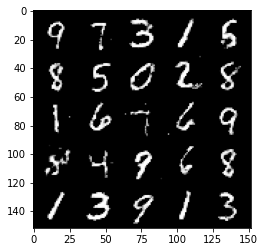

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


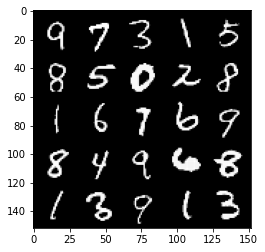

 32%|███▏      | 152/469 [00:08<00:18, 17.54it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 392, step 184000 -> generator loss: 0.4393149366974831, discriminator loss: 0.7134398351907735


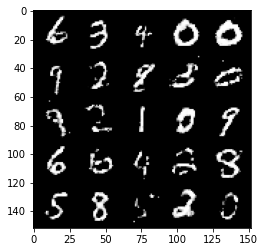

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


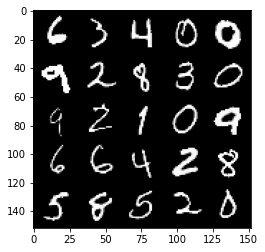

 39%|███▉      | 182/469 [00:10<00:16, 17.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 393, step 184500 -> generator loss: 0.43716906446218506, discriminator loss: 0.7147804886102678


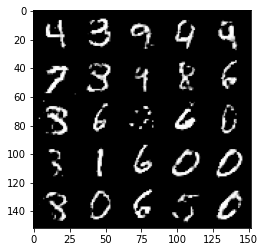

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


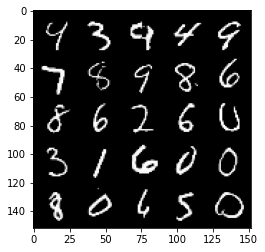

 46%|████▌     | 214/469 [00:12<00:14, 17.97it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 394, step 185000 -> generator loss: 0.4428601105213166, discriminator loss: 0.7092309671640395


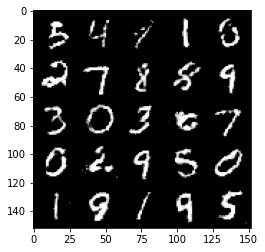

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


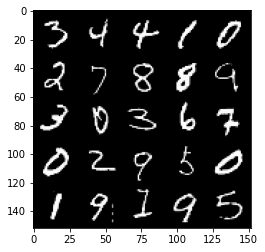

 52%|█████▏    | 244/469 [00:14<00:12, 17.38it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 395, step 185500 -> generator loss: 0.43782935738563533, discriminator loss: 0.7168780416250228


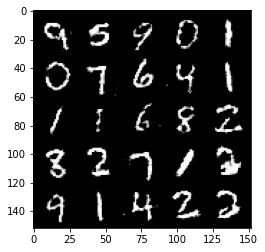

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


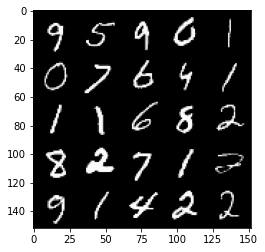

 59%|█████▉    | 276/469 [00:15<00:11, 16.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 396, step 186000 -> generator loss: 0.43717619603872293, discriminator loss: 0.7174160976409906


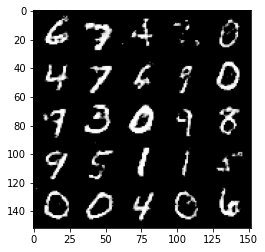

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


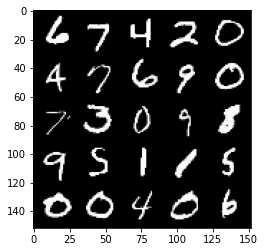

 65%|██████▌   | 306/469 [00:17<00:09, 17.82it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 397, step 186500 -> generator loss: 0.43736053401231734, discriminator loss: 0.714838211297989


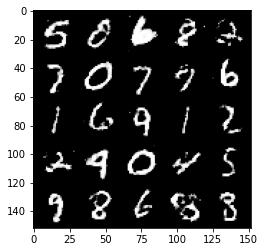

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


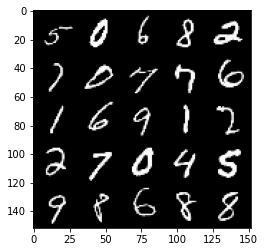

 72%|███████▏  | 338/469 [00:19<00:07, 17.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 398, step 187000 -> generator loss: 0.43556484538316714, discriminator loss: 0.7161487503051762


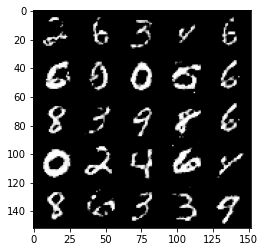

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


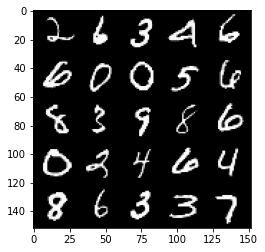

 78%|███████▊  | 368/469 [00:21<00:05, 17.40it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 399, step 187500 -> generator loss: 0.43631857675313906, discriminator loss: 0.7180286805629734


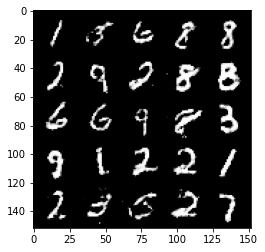

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


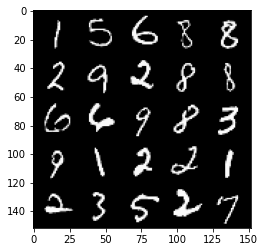

 85%|████████▌ | 400/469 [00:23<00:04, 17.23it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 400, step 188000 -> generator loss: 0.4388951131105423, discriminator loss: 0.7144653024673463


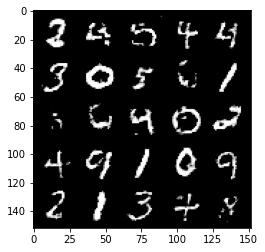

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


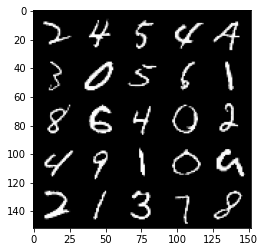

 92%|█████████▏| 430/469 [00:25<00:02, 17.50it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 401, step 188500 -> generator loss: 0.43815192615985915, discriminator loss: 0.7161902748346335


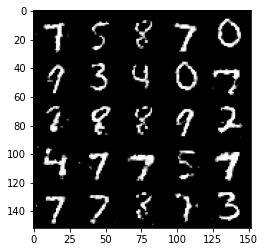

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


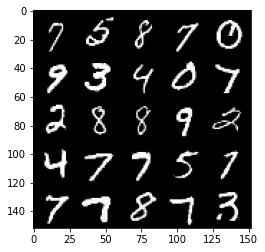

 99%|█████████▊| 462/469 [00:26<00:00, 16.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 402, step 189000 -> generator loss: 0.434596753060818, discriminator loss: 0.7200586689710616


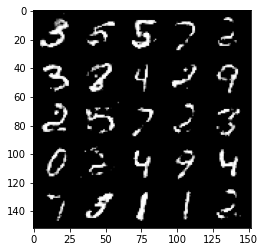

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


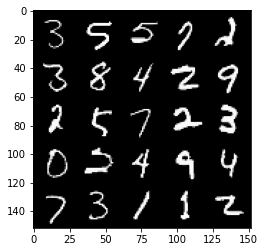

  5%|▌         | 24/469 [00:01<00:25, 17.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 404, step 189500 -> generator loss: 0.43882220697402974, discriminator loss: 0.7149338388442996


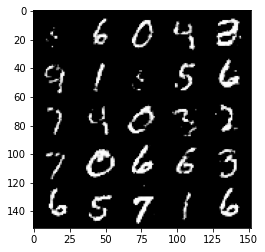

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


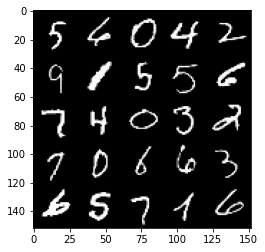

 12%|█▏        | 55/469 [00:03<00:23, 17.33it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 405, step 190000 -> generator loss: 0.43424759018421194, discriminator loss: 0.719927039504051


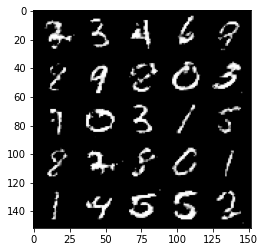

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


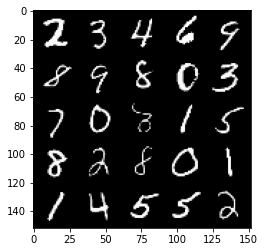

 18%|█▊        | 86/469 [00:05<00:21, 17.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 406, step 190500 -> generator loss: 0.43551937329769097, discriminator loss: 0.7183573079109192


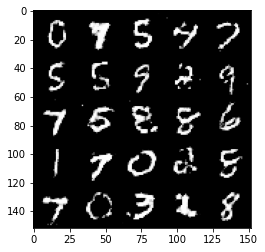

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


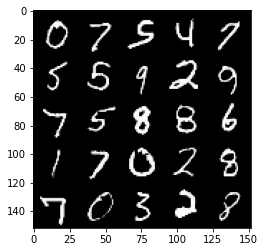

 25%|██▍       | 116/469 [00:07<00:27, 12.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 407, step 191000 -> generator loss: 0.43709849166870096, discriminator loss: 0.7160789777040482


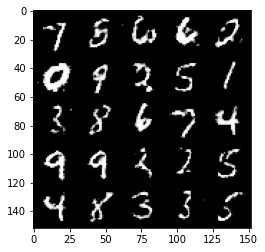

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


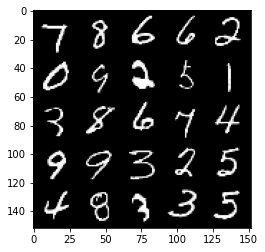

 32%|███▏      | 148/469 [00:08<00:19, 16.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 408, step 191500 -> generator loss: 0.4369775859117506, discriminator loss: 0.7176291320323949


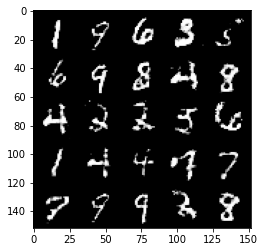

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


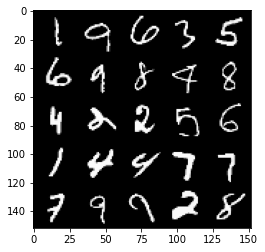

 38%|███▊      | 178/469 [00:10<00:18, 15.89it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 409, step 192000 -> generator loss: 0.43827605634927785, discriminator loss: 0.7145826001167297


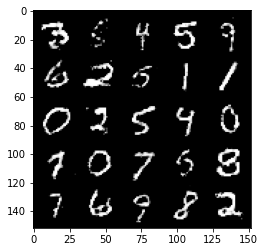

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


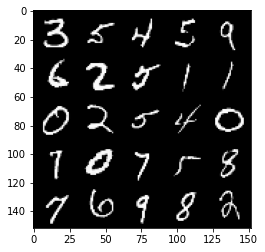

 45%|████▍     | 210/469 [00:12<00:15, 16.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 410, step 192500 -> generator loss: 0.43742653906345313, discriminator loss: 0.7146565510034556


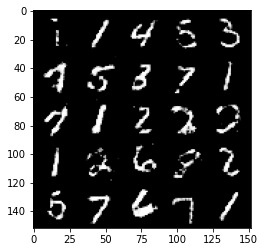

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


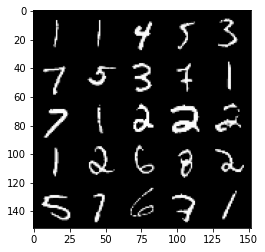

 51%|█████     | 240/469 [00:14<00:13, 17.31it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 411, step 193000 -> generator loss: 0.43519210666418057, discriminator loss: 0.7181547693014139


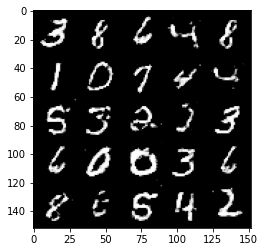

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


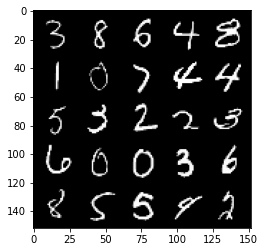

 58%|█████▊    | 272/469 [00:16<00:11, 17.07it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 412, step 193500 -> generator loss: 0.43626313453912696, discriminator loss: 0.7163199620246893


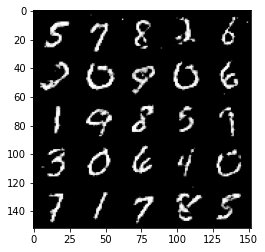

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


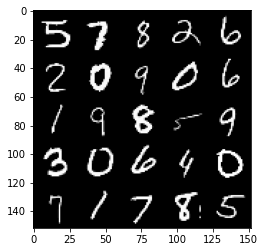

 64%|██████▍   | 302/469 [00:17<00:09, 17.06it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 413, step 194000 -> generator loss: 0.4354608422517776, discriminator loss: 0.7174272153377536


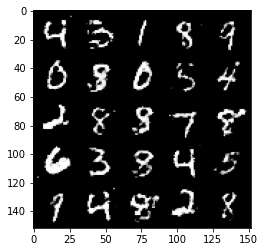

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


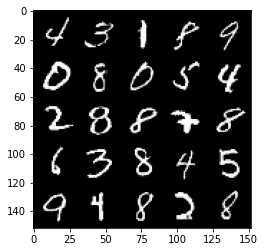

 71%|███████   | 334/469 [00:19<00:07, 17.34it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 414, step 194500 -> generator loss: 0.4356594483256338, discriminator loss: 0.7177724232673647


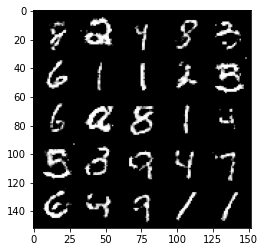

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


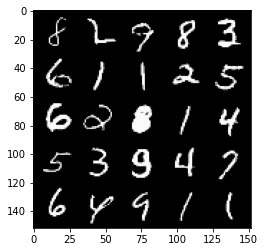

 78%|███████▊  | 364/469 [00:20<00:06, 16.52it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 415, step 195000 -> generator loss: 0.44037830215692503, discriminator loss: 0.7139005671739578


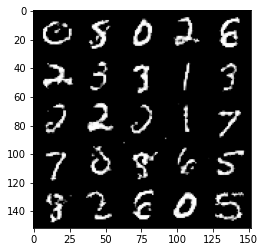

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


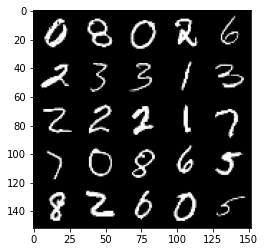

 84%|████████▍ | 396/469 [00:22<00:04, 17.92it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 416, step 195500 -> generator loss: 0.4375543810725213, discriminator loss: 0.7144376072883609


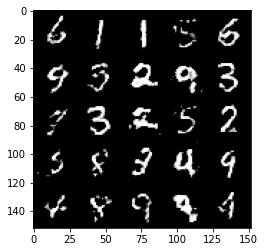

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


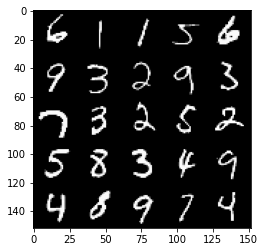

 91%|█████████ | 426/469 [00:24<00:02, 15.75it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 417, step 196000 -> generator loss: 0.4374863315224653, discriminator loss: 0.715019424557686


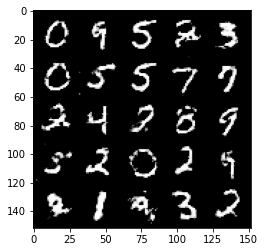

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


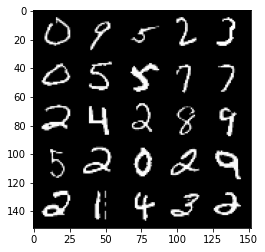

 98%|█████████▊| 458/469 [00:26<00:00, 16.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 418, step 196500 -> generator loss: 0.4378736686110497, discriminator loss: 0.7142167204618454


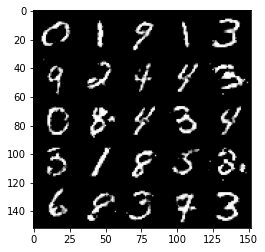

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


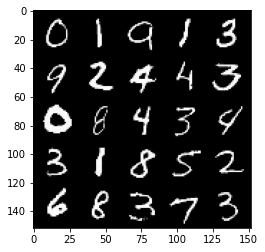

  4%|▍         | 20/469 [00:01<00:26, 16.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 420, step 197000 -> generator loss: 0.43653772091865534, discriminator loss: 0.7172834396362296


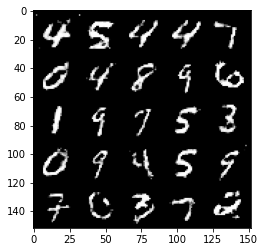

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


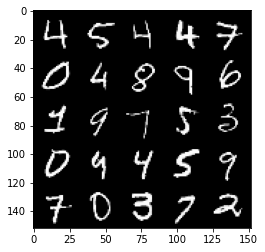

 11%|█         | 50/469 [00:02<00:23, 17.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 421, step 197500 -> generator loss: 0.4334398272633554, discriminator loss: 0.7204522162675863


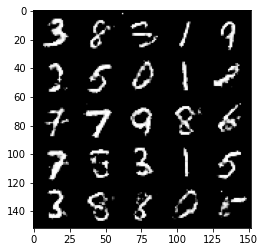

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


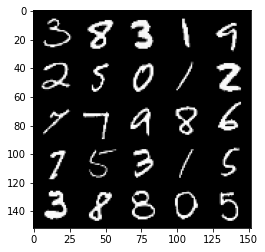

 17%|█▋        | 82/469 [00:04<00:21, 17.89it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 422, step 198000 -> generator loss: 0.4379527240395542, discriminator loss: 0.7165495282411574


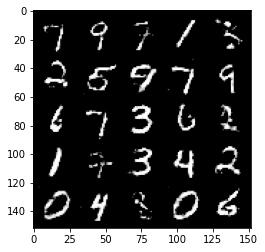

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


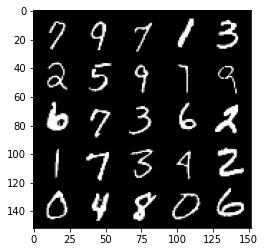

 24%|██▍       | 112/469 [00:06<00:20, 17.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 423, step 198500 -> generator loss: 0.43412422335147893, discriminator loss: 0.7201561233997337


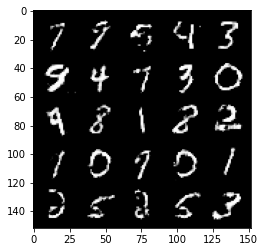

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


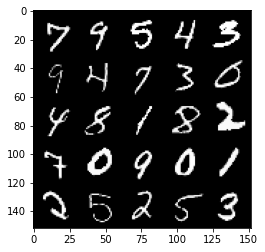

 31%|███       | 144/469 [00:08<00:18, 17.79it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 424, step 199000 -> generator loss: 0.4360219389796259, discriminator loss: 0.7181840218305587


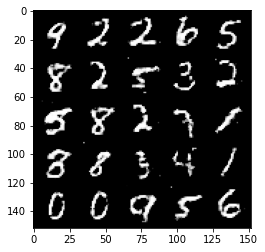

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


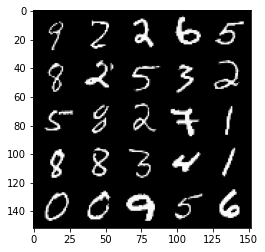

 37%|███▋      | 174/469 [00:09<00:16, 17.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 425, step 199500 -> generator loss: 0.4378471598029136, discriminator loss: 0.7153785510063166


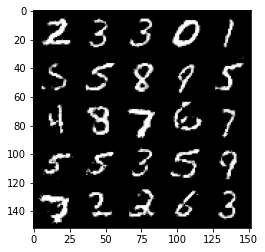

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


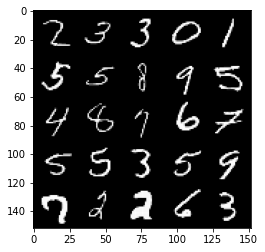

 44%|████▍     | 206/469 [00:11<00:14, 17.55it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 426, step 200000 -> generator loss: 0.4374092832803726, discriminator loss: 0.7166494228839873


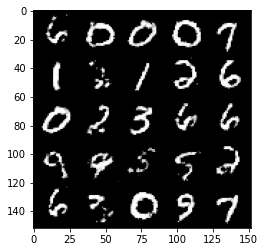

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


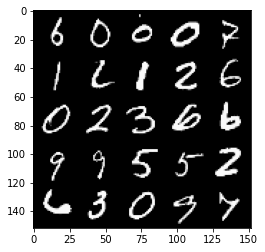

 50%|█████     | 236/469 [00:13<00:13, 17.75it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 427, step 200500 -> generator loss: 0.4428823930621139, discriminator loss: 0.7078006694316861


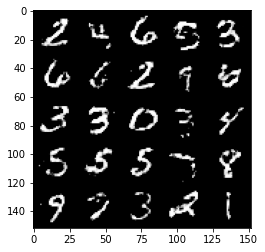

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


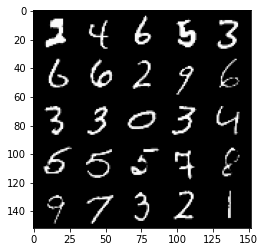

 57%|█████▋    | 268/469 [00:15<00:10, 18.31it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 428, step 201000 -> generator loss: 0.43575671488046647, discriminator loss: 0.716550711035729


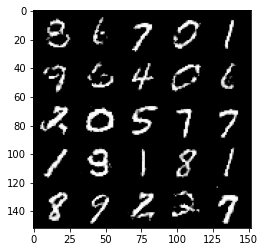

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


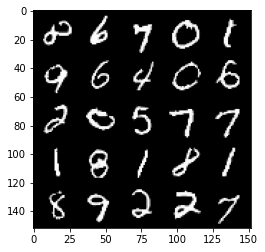

 64%|██████▎   | 298/469 [00:16<00:09, 17.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 429, step 201500 -> generator loss: 0.43746551829576424, discriminator loss: 0.7163076562881466


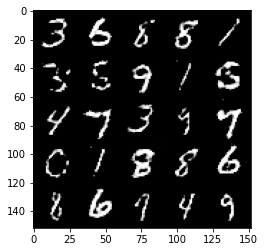

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


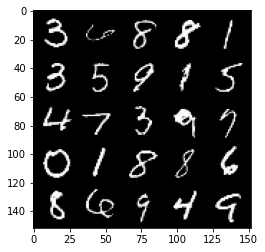

 70%|███████   | 330/469 [00:19<00:07, 17.50it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 430, step 202000 -> generator loss: 0.4398549416661263, discriminator loss: 0.7133513165712358


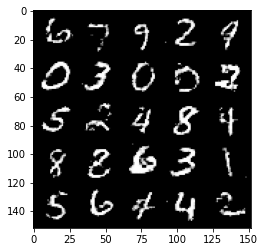

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


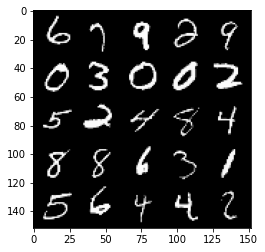

 77%|███████▋  | 360/469 [00:20<00:06, 17.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 431, step 202500 -> generator loss: 0.4345657475590707, discriminator loss: 0.7207281068563457


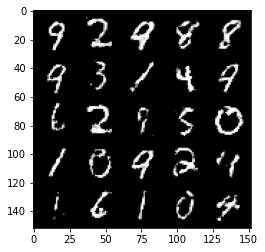

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


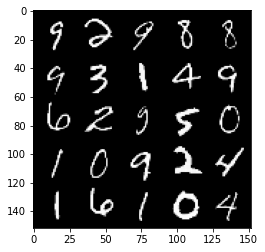

 84%|████████▎ | 392/469 [00:22<00:04, 17.13it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 432, step 203000 -> generator loss: 0.4363115970492359, discriminator loss: 0.7166808115243911


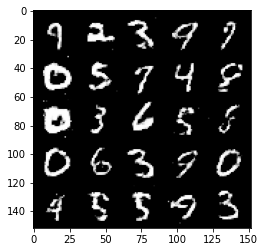

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


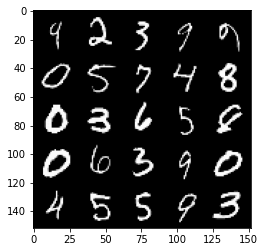

 90%|████████▉ | 422/469 [00:23<00:02, 16.37it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 433, step 203500 -> generator loss: 0.43688188219070456, discriminator loss: 0.7164863876104354


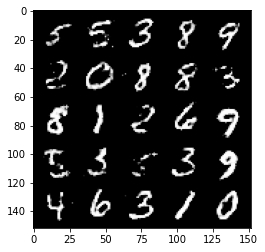

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


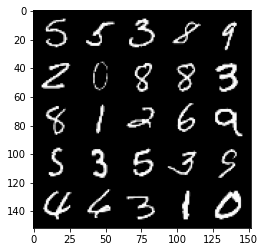

 97%|█████████▋| 454/469 [00:25<00:00, 18.11it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 434, step 204000 -> generator loss: 0.4360127220749853, discriminator loss: 0.7167849329710005


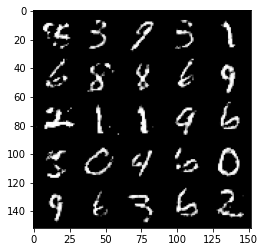

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


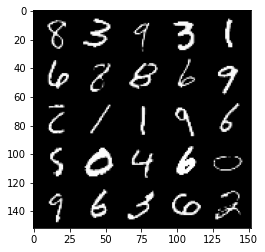

  3%|▎         | 16/469 [00:00<00:24, 18.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 436, step 204500 -> generator loss: 0.4424764138460166, discriminator loss: 0.7100911029577257


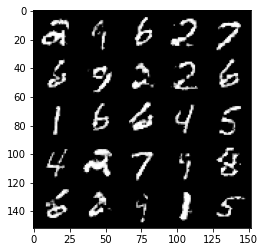

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


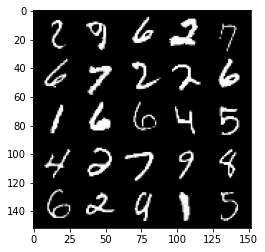

 10%|▉         | 46/469 [00:02<00:22, 19.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 437, step 205000 -> generator loss: 0.4377821705341335, discriminator loss: 0.7151624132394788


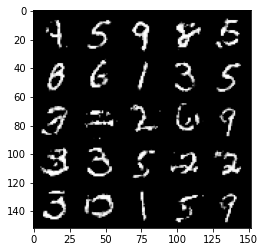

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


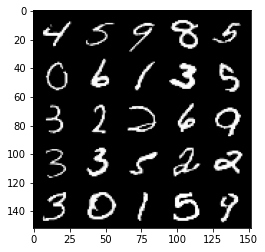

 17%|█▋        | 78/469 [00:04<00:20, 19.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 438, step 205500 -> generator loss: 0.4345803827643394, discriminator loss: 0.7189573631286629


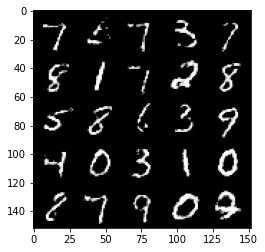

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


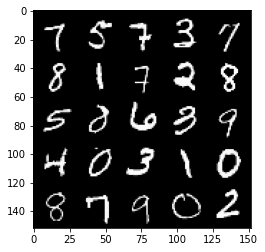

 23%|██▎       | 108/469 [00:07<00:19, 18.43it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 439, step 206000 -> generator loss: 0.4354990120530129, discriminator loss: 0.7171625511646268


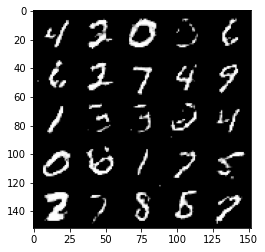

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


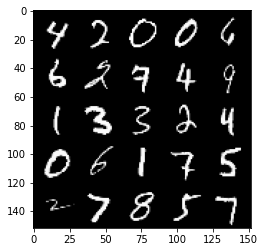

 30%|██▉       | 140/469 [00:07<00:17, 18.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 440, step 206500 -> generator loss: 0.4373097873330119, discriminator loss: 0.7154283282756813


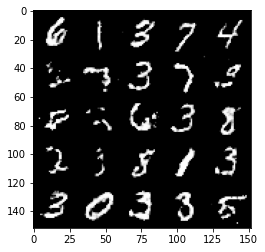

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


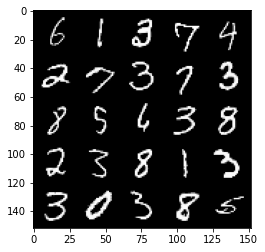

 36%|███▌      | 170/469 [00:09<00:16, 18.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 441, step 207000 -> generator loss: 0.4391728444695472, discriminator loss: 0.7136801210641861


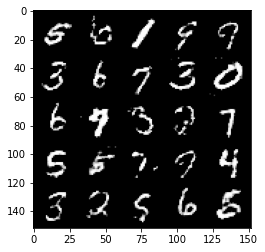

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


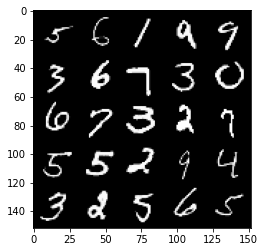

 43%|████▎     | 202/469 [00:10<00:14, 18.38it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 442, step 207500 -> generator loss: 0.4387215871810911, discriminator loss: 0.7138020565509796


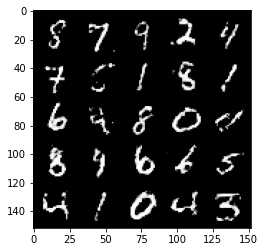

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


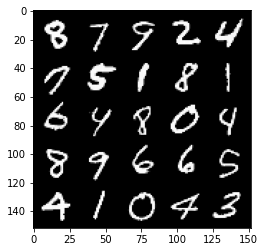

 49%|████▉     | 232/469 [00:12<00:12, 18.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 443, step 208000 -> generator loss: 0.43612262505292915, discriminator loss: 0.7171435452699666


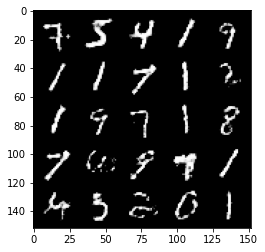

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


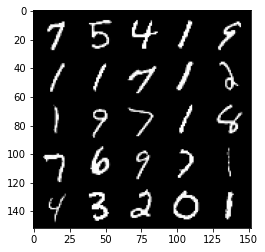

 56%|█████▋    | 264/469 [00:14<00:10, 18.80it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 444, step 208500 -> generator loss: 0.4397895827293396, discriminator loss: 0.7124569206237789


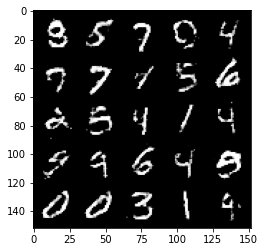

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


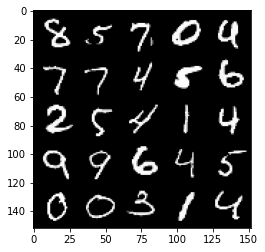

 63%|██████▎   | 294/469 [00:16<00:09, 18.01it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 445, step 209000 -> generator loss: 0.43910409134626355, discriminator loss: 0.711920567512512


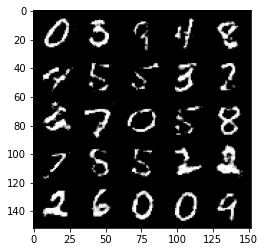

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


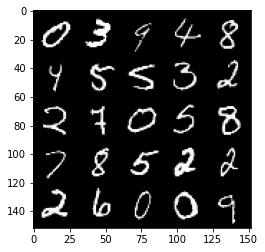

 70%|██████▉   | 326/469 [00:17<00:07, 18.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 446, step 209500 -> generator loss: 0.43787156230211294, discriminator loss: 0.7145212178230289


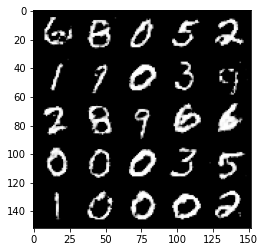

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


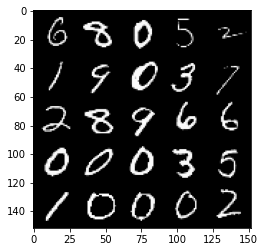

 76%|███████▌  | 356/469 [00:19<00:06, 18.78it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 447, step 210000 -> generator loss: 0.4398416120409963, discriminator loss: 0.7124416843652718


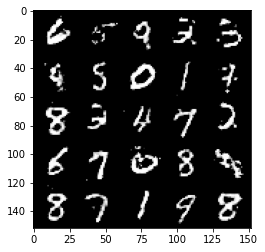

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


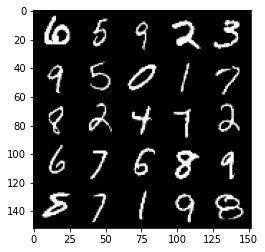

 83%|████████▎ | 388/469 [00:20<00:04, 18.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 448, step 210500 -> generator loss: 0.4375264842510227, discriminator loss: 0.7153505423069005


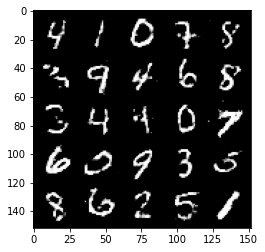

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


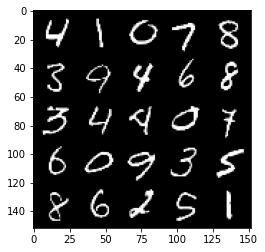

 89%|████████▉ | 418/469 [00:22<00:02, 18.81it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 449, step 211000 -> generator loss: 0.43928316408395773, discriminator loss: 0.7137565902471544


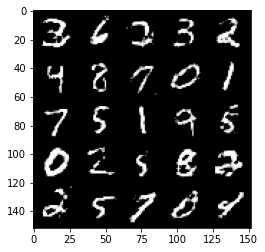

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


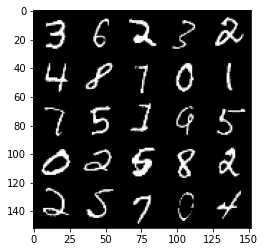

 96%|█████████▌| 450/469 [00:24<00:01, 18.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 450, step 211500 -> generator loss: 0.4396707606315616, discriminator loss: 0.714247172832489


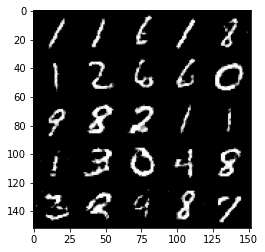

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


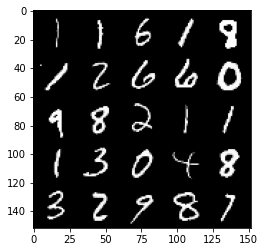

  3%|▎         | 12/469 [00:00<00:24, 18.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 452, step 212000 -> generator loss: 0.4364868922829627, discriminator loss: 0.7172320498228075


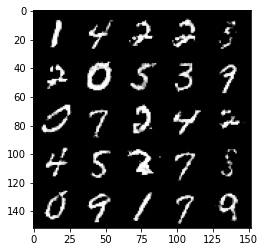

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


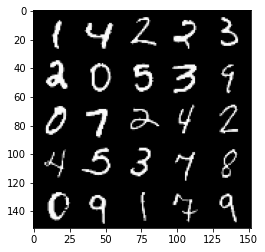

  9%|▉         | 42/469 [00:02<00:22, 18.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 453, step 212500 -> generator loss: 0.4384241553544999, discriminator loss: 0.7165006694793697


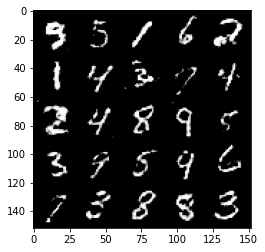

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


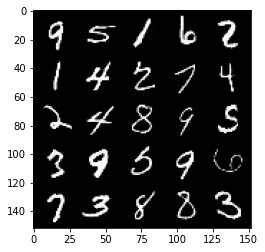

 16%|█▌        | 74/469 [00:04<00:20, 18.95it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 454, step 213000 -> generator loss: 0.4400318712592124, discriminator loss: 0.7136009116172789


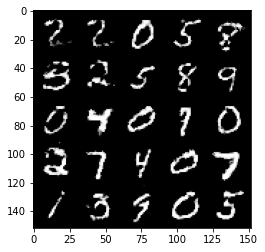

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


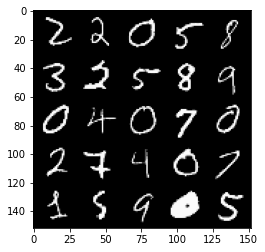

 22%|██▏       | 104/469 [00:05<00:19, 18.90it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 455, step 213500 -> generator loss: 0.43746028494834904, discriminator loss: 0.7156198409795755


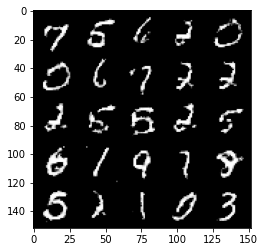

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


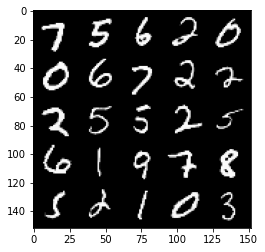

 29%|██▉       | 136/469 [00:07<00:17, 18.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 456, step 214000 -> generator loss: 0.43512530964612967, discriminator loss: 0.7185259490013118


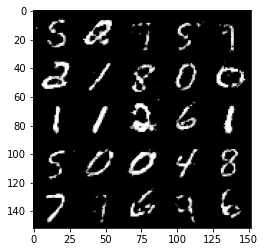

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


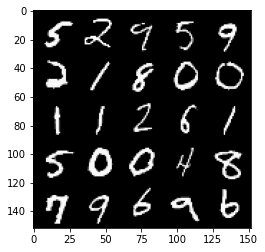

 35%|███▌      | 166/469 [00:10<00:24, 12.35it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 457, step 214500 -> generator loss: 0.43539434111118314, discriminator loss: 0.7196505942344664


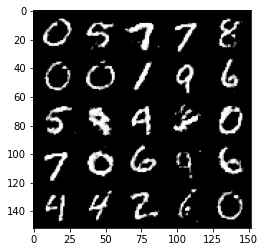

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


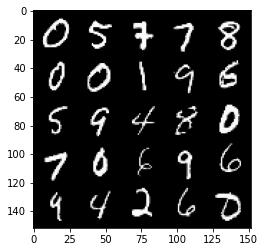

 42%|████▏     | 198/469 [00:10<00:14, 18.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 458, step 215000 -> generator loss: 0.43676266241073586, discriminator loss: 0.7180307253599166


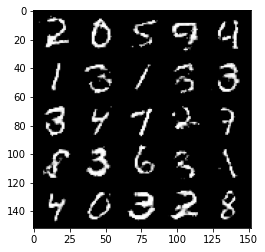

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


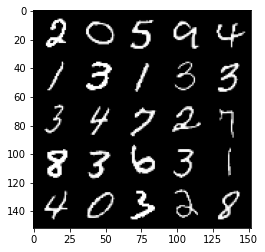

 49%|████▊     | 228/469 [00:12<00:12, 18.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 459, step 215500 -> generator loss: 0.43756270474195474, discriminator loss: 0.7143667101860046


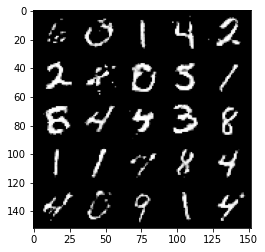

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


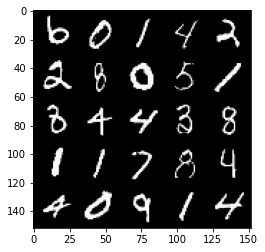

 55%|█████▌    | 260/469 [00:13<00:10, 19.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 460, step 216000 -> generator loss: 0.44017952316999426, discriminator loss: 0.7123440655469891


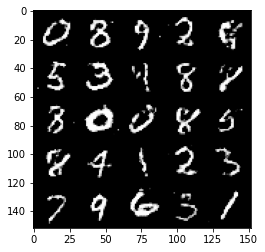

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


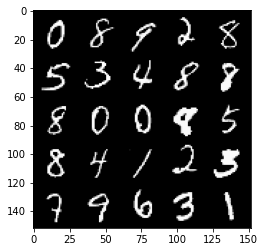

 62%|██████▏   | 290/469 [00:15<00:09, 18.74it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 461, step 216500 -> generator loss: 0.44114674997329695, discriminator loss: 0.711247484564781


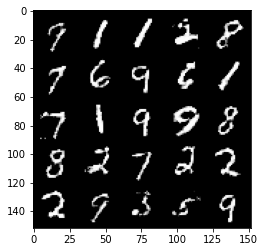

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


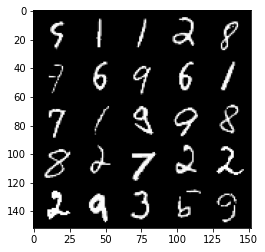

 69%|██████▊   | 322/469 [00:17<00:07, 18.67it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 462, step 217000 -> generator loss: 0.4346231898665432, discriminator loss: 0.718223685145378


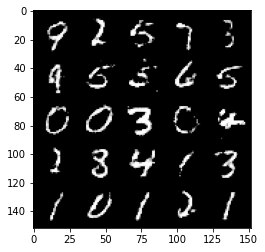

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


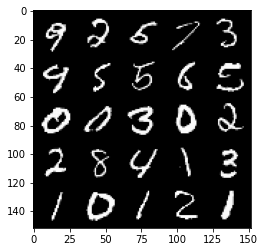

 75%|███████▌  | 352/469 [00:18<00:06, 19.19it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 463, step 217500 -> generator loss: 0.4393570859432222, discriminator loss: 0.7137002084255217


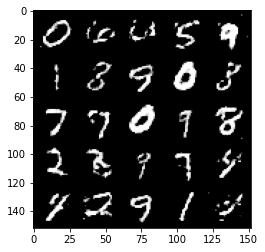

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


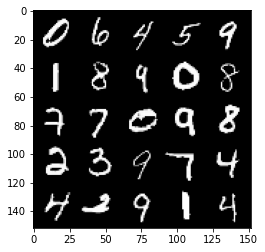

 82%|████████▏ | 384/469 [00:22<00:04, 19.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 464, step 218000 -> generator loss: 0.4370466292500494, discriminator loss: 0.7162530933618546


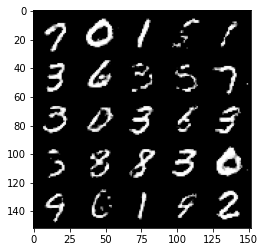

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


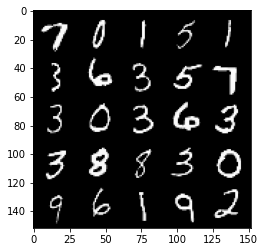

 88%|████████▊ | 414/469 [00:26<00:03, 16.13it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 465, step 218500 -> generator loss: 0.43935358911752737, discriminator loss: 0.7142331676483157


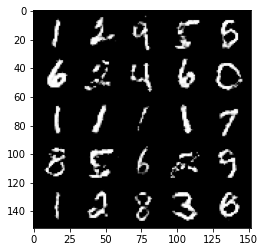

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


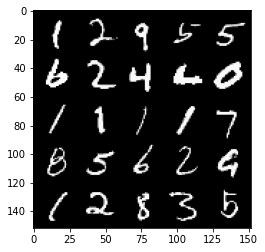

 95%|█████████▌| 446/469 [00:25<00:01, 18.27it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 466, step 219000 -> generator loss: 0.4391713411211965, discriminator loss: 0.7141089369058607


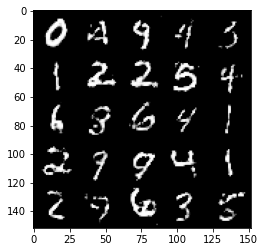

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


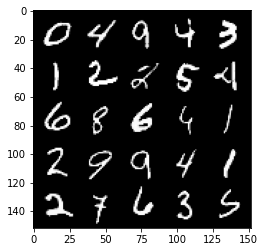

  2%|▏         | 8/469 [00:00<00:26, 17.33it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 468, step 219500 -> generator loss: 0.44114490920305255, discriminator loss: 0.7107941606044774


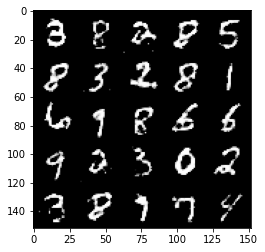

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


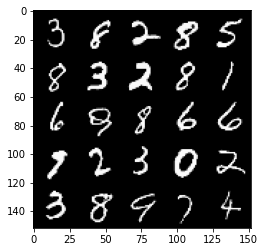

  8%|▊         | 38/469 [00:02<00:24, 17.73it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 469, step 220000 -> generator loss: 0.43795951014757156, discriminator loss: 0.7160221481323246


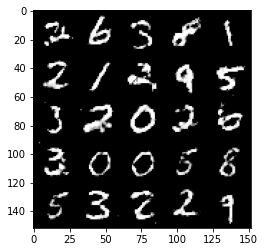

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


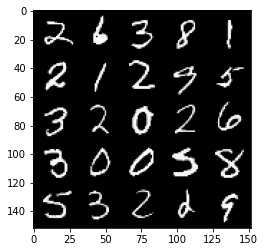

 15%|█▍        | 70/469 [00:03<00:21, 18.35it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 470, step 220500 -> generator loss: 0.4392012568116192, discriminator loss: 0.7139243209362034


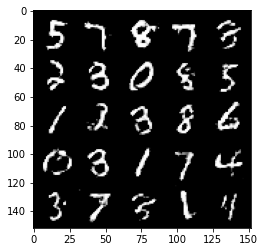

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


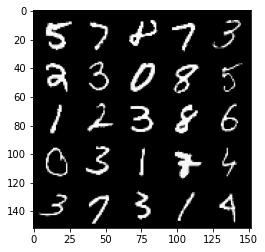

 21%|██▏       | 100/469 [00:05<00:20, 18.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 471, step 221000 -> generator loss: 0.43573908948898293, discriminator loss: 0.7189429631233213


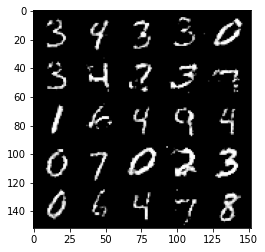

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


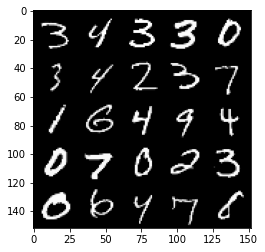

 28%|██▊       | 132/469 [00:07<00:18, 18.03it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 472, step 221500 -> generator loss: 0.43550449889898296, discriminator loss: 0.7175665967464446


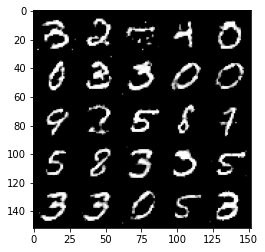

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


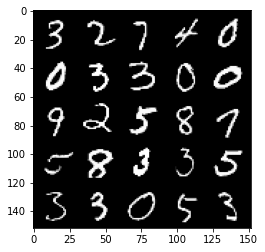

 35%|███▍      | 162/469 [00:09<00:16, 18.46it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 473, step 222000 -> generator loss: 0.43381025576591475, discriminator loss: 0.7211666957139967


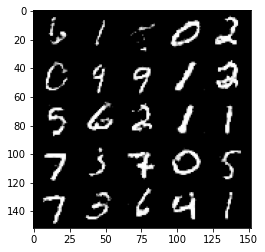

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


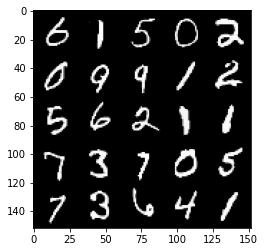

 41%|████▏     | 194/469 [00:10<00:15, 18.30it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 474, step 222500 -> generator loss: 0.43715782862901653, discriminator loss: 0.715736459493637


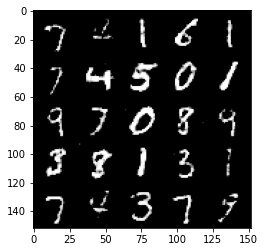

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


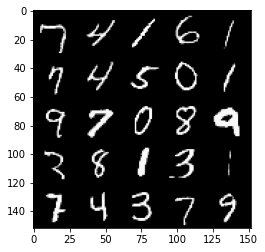

 48%|████▊     | 224/469 [00:12<00:13, 18.66it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 475, step 223000 -> generator loss: 0.4396641758084297, discriminator loss: 0.7127796117067341


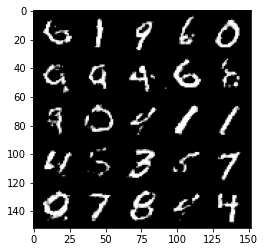

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


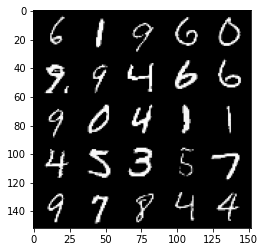

 55%|█████▍    | 256/469 [00:14<00:11, 18.56it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 476, step 223500 -> generator loss: 0.4405725286006926, discriminator loss: 0.7110354388952252


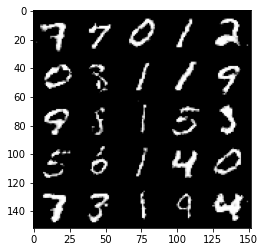

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


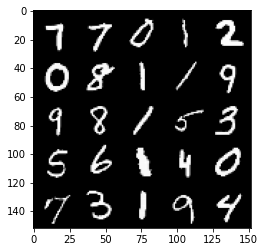

 61%|██████    | 286/469 [00:15<00:10, 18.09it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 477, step 224000 -> generator loss: 0.44170396316051536, discriminator loss: 0.7094643983840941


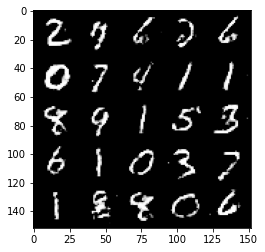

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


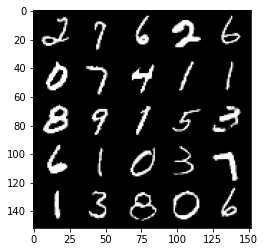

 68%|██████▊   | 318/469 [00:17<00:08, 18.84it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 478, step 224500 -> generator loss: 0.441198911845684, discriminator loss: 0.7110227845907205


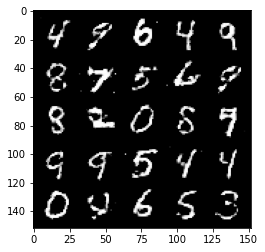

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


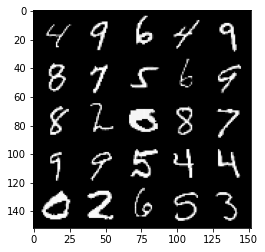

 74%|███████▍  | 348/469 [00:19<00:07, 16.82it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 479, step 225000 -> generator loss: 0.4403906844258309, discriminator loss: 0.7129190599918371


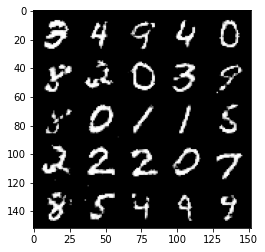

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


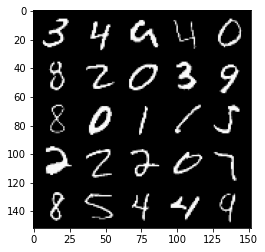

 81%|████████  | 380/469 [00:22<00:05, 17.20it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 480, step 225500 -> generator loss: 0.44545272225141513, discriminator loss: 0.7058013114929201


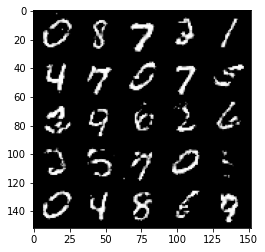

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


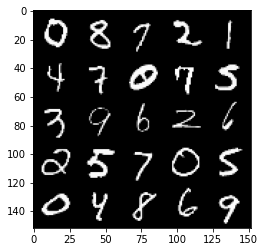

 87%|████████▋ | 410/469 [00:23<00:03, 17.99it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 481, step 226000 -> generator loss: 0.437186877071857, discriminator loss: 0.7156561577320094


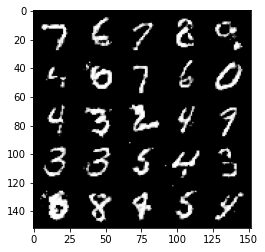

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


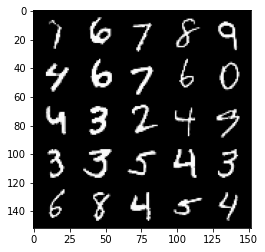

 94%|█████████▍| 442/469 [00:25<00:01, 18.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 482, step 226500 -> generator loss: 0.4361265243887903, discriminator loss: 0.7175231732130053


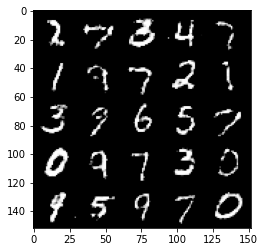

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


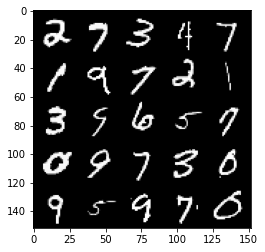

  1%|          | 4/469 [00:00<00:29, 15.94it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 484, step 227000 -> generator loss: 0.4376481800675395, discriminator loss: 0.7172652505636216


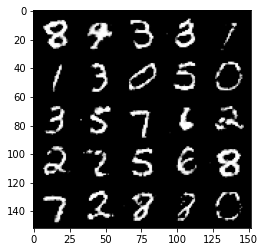

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


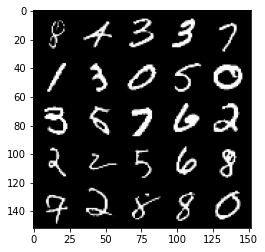

  7%|▋         | 34/469 [00:01<00:24, 17.40it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 485, step 227500 -> generator loss: 0.4369754056930541, discriminator loss: 0.7158448163270953


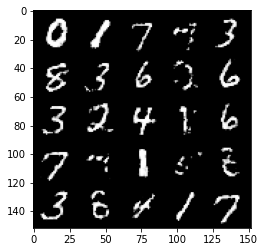

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


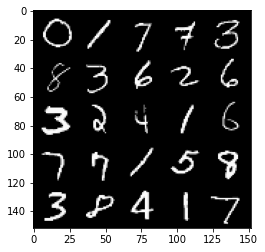

 14%|█▍        | 66/469 [00:03<00:22, 18.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 486, step 228000 -> generator loss: 0.4368214855194094, discriminator loss: 0.7159553916454318


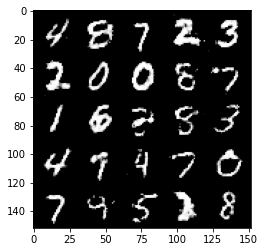

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


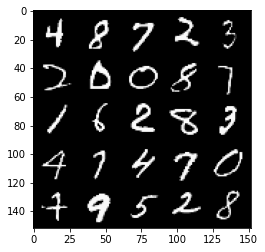

 20%|██        | 96/469 [00:05<00:21, 17.32it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 487, step 228500 -> generator loss: 0.4350032551884647, discriminator loss: 0.719362950205804


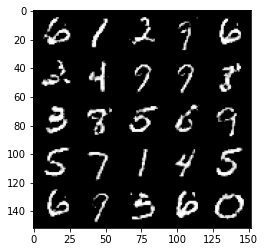

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


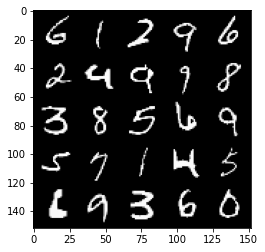

 27%|██▋       | 128/469 [00:07<00:19, 17.83it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 488, step 229000 -> generator loss: 0.44309580737352383, discriminator loss: 0.7099450279474258


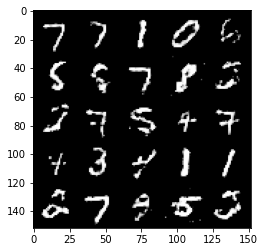

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


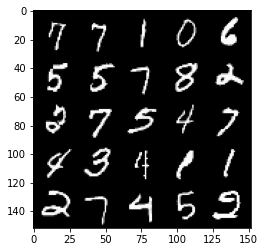

 34%|███▎      | 158/469 [00:09<00:17, 17.82it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 489, step 229500 -> generator loss: 0.43665677982568707, discriminator loss: 0.7158372213840487


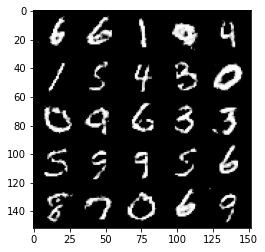

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


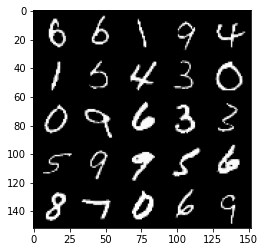

 41%|████      | 190/469 [00:10<00:15, 17.98it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 490, step 230000 -> generator loss: 0.43646482729911773, discriminator loss: 0.7162819986343382


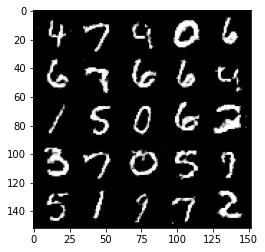

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


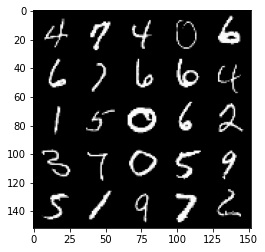

 47%|████▋     | 220/469 [00:12<00:13, 18.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 491, step 230500 -> generator loss: 0.437378174841404, discriminator loss: 0.7157805320024488


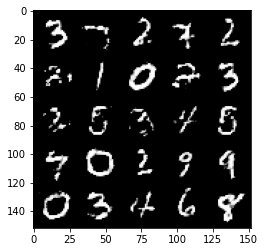

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


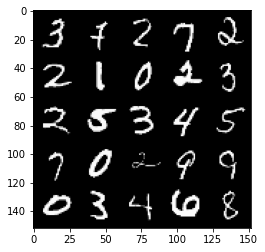

 54%|█████▎    | 252/469 [00:13<00:11, 18.57it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 492, step 231000 -> generator loss: 0.4385238851308826, discriminator loss: 0.7134329410791393


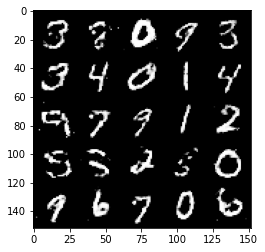

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


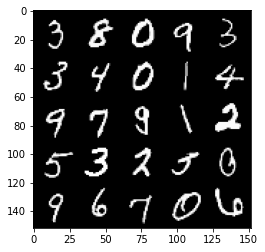

 60%|██████    | 282/469 [00:15<00:10, 18.24it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 493, step 231500 -> generator loss: 0.43747755265235894, discriminator loss: 0.7153971092700961


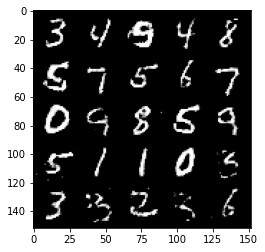

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


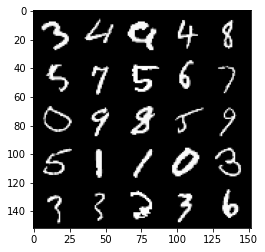

 67%|██████▋   | 314/469 [00:17<00:09, 16.52it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 494, step 232000 -> generator loss: 0.43859191977977735, discriminator loss: 0.7149673868417739


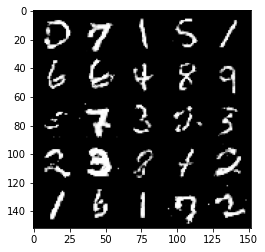

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


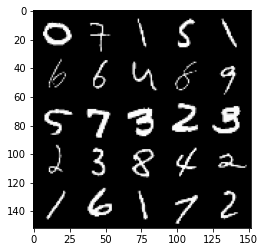

 73%|███████▎  | 344/469 [00:18<00:06, 18.55it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 495, step 232500 -> generator loss: 0.443509415149689, discriminator loss: 0.7081983165740974


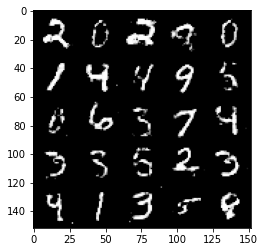

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


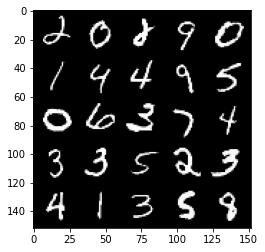

 80%|████████  | 376/469 [00:20<00:05, 18.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 496, step 233000 -> generator loss: 0.439662537932396, discriminator loss: 0.7132659114599222


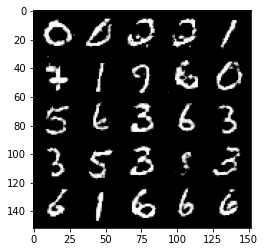

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


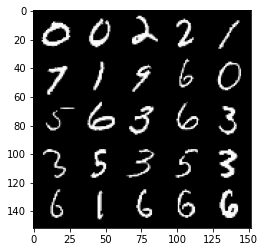

 87%|████████▋ | 406/469 [00:22<00:03, 18.49it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 497, step 233500 -> generator loss: 0.4387879603505136, discriminator loss: 0.7133691899776468


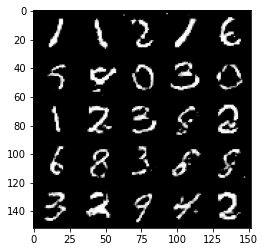

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


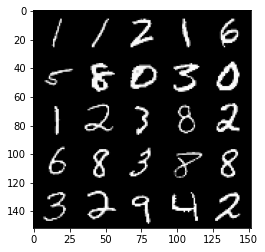

 93%|█████████▎| 438/469 [00:24<00:01, 17.47it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 498, step 234000 -> generator loss: 0.4418752300739286, discriminator loss: 0.7099247019290917


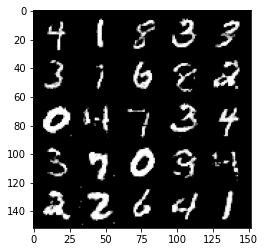

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


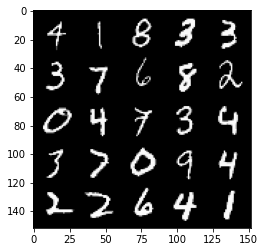

100%|██████████| 469/469 [00:25<00:00, 18.20it/s]


In [9]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
generator_loss = False
for epoch in range(n_epochs):

    # data loader return the batches
    for org, labels in tqdm(dataloader):
        cur_batch_size = len(org)
        # flattening batch of org images from dataset
        org = org.view(cur_batch_size, -1).to(device)
        labels = labels.to(device)

        ## updating discriminator ##
        # zeroing gradients before back prop
        disc_opt.zero_grad()
        gen.train()
        discriminator_loss = disc_loss(gen, disc, criterion, org, cur_batch_size, noise_dim, device, labels)
        # update gradients
        discriminator_loss.backward(retain_graph=True)
        # update optimizer
        disc_opt.step()
        
        ## updating generator ##
        gen_opt.zero_grad()
        generator_loss = gen_loss(gen, disc, criterion, cur_batch_size, noise_dim, device)
        generator_loss.backward(retain_graph=True)
        gen_opt.step()
        disc_opt.step()

        # calculating average discriminator and generator loss
        mean_discriminator_loss += discriminator_loss.item() / display_step
        mean_generator_loss += generator_loss.item() / display_step

        # visualization
        if cur_step % display_step == 0 and cur_step > 0:
            gen.eval()
            print(f'Epoch {epoch}, step {cur_step} -> generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}')
            gen_noise = get_noise(cur_batch_size, noise_dim, device=device)
            generated = gen(gen_noise, labels)
            show_tensor_images(generated)
            show_tensor_images(org)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1

## Saving the model

In this step we will save this trained model for further usage and avoid spending 160+ minutes for training it.

In [10]:
torch.save(gen.state_dict(), 'models/CGAN-MNIST-Gen-v5.0.pth')
torch.save(disc.state_dict(), 'models/CGAN-MNIST-Disc-v5.0.pth')

## Checking the quality of GAN

Lets generated 25 samples of images based on MNIST dataset trained with a very simple and shallow GAN.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


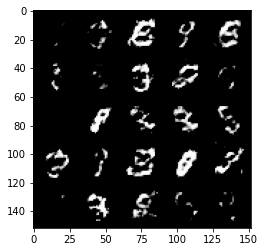

In [15]:
test_noise = get_noise(25, 64, device='cuda')
test_label = torch.tensor([1 for _ in range(25)], device='cuda')
generated_test = gen(test_noise, test_label)
show_tensor_images(generated_test)

--------
# Ramin F. - @SimplyRamin